<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#B0070" data-toc-modified-id="B0070-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>B0070</a></span></li><li><span><a href="#Settings" data-toc-modified-id="Settings-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Settings</a></span></li><li><span><a href="#Temporary-image-path-solution-for-kiwi-server" data-toc-modified-id="Temporary-image-path-solution-for-kiwi-server-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Temporary image path solution for kiwi server</a></span></li><li><span><a href="#Detect-cells-for-all-sections" data-toc-modified-id="Detect-cells-for-all-sections-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Detect cells for all sections</a></span></li><li><span><a href="#points-=-cell_locations" data-toc-modified-id="points-=-cell_locations-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>points = cell_locations</a></span></li><li><span><a href="#createShardedPointAnnotation(points,img_dir)-#-Create-sharded-points-for-Neuroglancer-layer" data-toc-modified-id="createShardedPointAnnotation(points,img_dir)-#-Create-sharded-points-for-Neuroglancer-layer-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>createShardedPointAnnotation(points,img_dir) # Create sharded points for Neuroglancer layer</a></span></li><li><span><a href="#Scale-cell-locations-to-smaller-registered-version" data-toc-modified-id="Scale-cell-locations-to-smaller-registered-version-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Scale cell locations to smaller registered version</a></span></li><li><span><a href="#---coding:-utf-8---" data-toc-modified-id="---coding:-utf-8----8"><span class="toc-item-num">8&nbsp;&nbsp;</span>-<em>- coding: utf-8 -</em>-</a></span></li><li><span><a href="#OLD" data-toc-modified-id="OLD-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>OLD</a></span><ul class="toc-item"><li><span><a href="#Load-data" data-toc-modified-id="Load-data-9.1"><span class="toc-item-num">9.1&nbsp;&nbsp;</span>Load data</a></span></li></ul></li></ul></div>

In [1]:
%load_ext autoreload
%autoreload 2

import glob
from natsort import natsorted
from pprint import pprint
import sys
import time

import cv2
import matplotlib.pyplot as plt
import numpy as np
import scipy.ndimage
from scipy.ndimage import binary_dilation, binary_erosion
from skimage.feature import peak_local_max
import skimage.morphology
from skimage.segmentation import watershed
import SimpleITK as sitk

from cellAnalysis.cell_detection import createShardedPointAnnotation, readSectionTif, remove_background

In [2]:
def auto_contrast(data: np.ndarray, alpha: float = None, beta: float = None) -> np.ndarray:
    """
    Preprocess tiff files to automatically adjust brightness and contrast.
    https://stackoverflow.com/questions/56905592/automatic-contrast-and-brightness-adjustment-of-a-color-photo-of-a-sheet-of-pape
    """
    if not alpha:
        alpha = np.iinfo(data.dtype).max / (np.max(data) - np.min(data))
    if not beta:
        beta = -np.min(data) * alpha
    img = cv2.convertScaleAbs(data.copy(), alpha=alpha, beta=beta)
    return img


def preprocess(img: np.ndarray, min_val: float = None, max_val: float = 400) -> np.ndarray:
    """
    Preprocesses volume data. Clips maximum value at max_val and then normalizes volume
    between 0-255.
    """
    data = img.copy()
    data[data > max_val] = max_val
    if min_val:
        data[data < min_val] = min_val
    data = cv2.normalize(src=data, dst=None, alpha=0, beta=255, 
                         norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8UC1)
    return data


def remove_artifacts(img: np.ndarray, thresh=None,
                     min_size=None, area_threshold=None, num_iter=None, erode=True, convex_hull=True, 
                     debug=False) -> np.ndarray:
    mask = img.copy()
    y, x = img.shape
    
    # Set parameters
    if min_size is None:
        min_size = max(64, int(max(y, x) * 0.20))      # Largest allowable size for specks
    if area_threshold is None:
        area_threshold = max(64, int(max(y, x) * 20))  # Fill in holes smaller than this size
    if num_iter is None:
        num_iter = int(max(y, x) / 500)                # 20, original dilation factor 500
    
    if debug:
        plt.imshow(mask)
        plt.title('Original')
        plt.show()

    # Preprocess curr_img
    mask = preprocess(mask, min_val=0, max_val=400)
    
    if debug:
        plt.imshow(mask)
        plt.title('Preprocessed')
        plt.show()
    
    # Binarize / threshold
    if not thresh:  # Adaptive threshold if no threshold is given
        mask = cv2.threshold(mask, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1].astype(bool)
    else:  # Otherwise, use given threshold
        mask = cv2.threshold(mask, thresh, 255, cv2.THRESH_BINARY)[1].astype(bool)
    mask = np.where(mask > 0, 1, 0).astype(bool)
    
    if debug:
        plt.imshow(mask)
        plt.title('Binarized')
        plt.show()
    
    # Remove small specks from background
    mask = skimage.morphology.remove_small_objects(mask.astype(bool), min_size=min_size).astype(bool)
    
    if debug:
        plt.imshow(mask)
        plt.title('Removed small specks')
        plt.show()
    
    # Expand morphology around brain mask to capture surrounding areas 
    # that may have been potentially filtered out.
    start = time.time()
    mask = binary_dilation(mask, iterations=num_iter).astype(bool)
    elapsed = time.time() - start
    
    if debug:
        print('Binary dilation elapsed time:', elapsed)
        plt.imshow(mask)
        plt.title('Dilated')
        plt.show()
    
    # Fill in holes
    mask = skimage.morphology.remove_small_holes(mask, area_threshold=area_threshold).astype(bool)
    
    if debug:
        plt.imshow(mask)
        plt.title('Filled in holes')
        plt.show()
        
    # Erode borders to get rid of artifacting if needed
    if erode:
        start = time.time()
        mask = binary_erosion(mask, iterations=num_iter * 4).astype(bool)
        elapsed = time.time() - start
        
        if debug:
            print('Binary erosion elapsed time:', elapsed)
            plt.imshow(mask)
            plt.title('Erosion')
            plt.show()
        
    # Use convex hull if checked
    if convex_hull:
        mask = skimage.morphology.convex_hull_image(mask)

    # Apply mask to original image
    masked_img = np.where(mask, img, 0)
    
    if debug:
        masked_img_preprocessed = preprocess(masked_img, min_val=0, max_val=400)
        plt.imshow(masked_img_preprocessed)
        plt.title('Mask applied to original (preprocessed)')
        plt.show()
    
    return masked_img


In [3]:
def get_cell_locations(img, intensity_threshold = 5, min_distance = 5, size_threshold = 15, index = None):
    """
    img : 2d Image array or img_path
    intensity_threshold: backgound intensity in 0 to 255 scale
    size_threshold : Minimum cell size
    min_distance: Minimum distance between two cell centers
    
    index : Cell z index
    """
    
    if type(img) == str:
        img = readSectionTif(img)
        
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    # Show the original section
    axs[0].set_title("Original section " + str(index))
    axs[0].imshow(auto_contrast(img, alpha=0.25))
        
    # Normalize the section to highlight larger values
    section = (img/np.iinfo(img.dtype).max)*255
    section = section.astype(np.uint8)
    axs[1].set_title("Normalized section " + str(index))
    axs[1].imshow(auto_contrast(section, alpha=40))
    plt.show()
    
    
    ##### MY BACKGROUND REMOVAL #####
    y, x = section.shape
    THRESH = 15  # Background thresh
    MIN_SIZE = max(64, int(max(y, x) * 0.20))      # Largest allowable size for specks
    AREA_THRESHOLD = max(64, int(max(y, x) * 20))  # Fill in holes smaller than this size
    DILATION_ITER = int(max(y, x) / 500)           # 20
    
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    # Remove the background 1 (old method)
    bg = remove_background(section)
    axs[0].set_title("Background removal (old method)")
    axs[0].imshow(auto_contrast(bg, alpha=40))
    
    # Remove the background 2 (my method)
    bg_mask = remove_artifacts(img, thresh=THRESH, min_size=MIN_SIZE, area_threshold=AREA_THRESHOLD, num_iter=DILATION_ITER, 
                               erode=True, convex_hull=False, debug=False)
    bg_mask[bg_mask != 0] = 1  # Convert to binary
    axs[2].set_title('New background removal (mask)')
    axs[2].imshow(auto_contrast(bg_mask, alpha=40))
    # Apply mask to normalized section
    bg_new = section.copy()
    bg_new[bg_mask == 0] = 0
    axs[1].set_title("New background removal (overlay)")
    axs[1].imshow(auto_contrast(bg_new, alpha=40))
    axs[1].contour(bg_mask, colors='r', levels=[0.5])
    plt.show()
    
    ##### DO PEAK DETECTION #####
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # Local peak detection 1 (no BG removal)
    peaks = peak_local_max(section, min_distance=min_distance, threshold_abs=intensity_threshold)
    axs[0].set_title("Local peak detection (No BG removal)")
    axs[0].imshow(auto_contrast(img, alpha=0.25))
    axs[0].plot(peaks[:, 1], peaks[:, 0], 'r.')
    
    # Local peak detection 2
    peaks = peak_local_max(bg, min_distance=min_distance, threshold_abs=intensity_threshold)
    axs[1].set_title("Local peak detection (old BG removal)")
    axs[1].imshow(auto_contrast(img, alpha=0.25))
    axs[1].plot(peaks[:, 1], peaks[:, 0], 'r.')
    
    # Local peak detection 3
    peaks = peak_local_max(bg_new, min_distance=min_distance, threshold_abs=intensity_threshold)
    axs[2].set_title("Local peak detection (new BG removal)")
    axs[2].imshow(auto_contrast(img, alpha=0.25))
    axs[2].plot(peaks[:, 1], peaks[:, 0], 'r.')
    plt.show()
    
    # Zoom in original
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].set_title("Zoomed-in original section " + str(index))
    axs[0].imshow(auto_contrast(img, alpha=0.05))
    axs[0].set_xlim([6500, 8500])
    axs[0].set_ylim([3200, 2400])
    
    # Zoom in peak detection
    axs[1].set_title("Zoomed-in detected local peaks (new BG removal)")
    axs[1].imshow(auto_contrast(img, alpha=0.05))
    axs[1].plot(peaks[:, 1], peaks[:, 0], 'r.')
    axs[1].set_xlim([6500, 8500])
    axs[1].set_ylim([3200, 2400])
    plt.show()

    bg = bg_new

    # Create a mask from the local peak coordinates for watershed and use for size detection
    mask = np.zeros(bg.shape)
    mask[tuple(peaks.T)] = True
    markers, _ = scipy.ndimage.label(mask)
    #print("Size Detection")
    watershed_mask = bg > intensity_threshold
    labels = watershed(-bg, markers, mask = watershed_mask)

    # Compute the center of mass of each cell
    centers = np.array(scipy.ndimage.center_of_mass(bg, labels, index=np.arange(1, np.max(labels) + 1)))
    centers = centers.astype(int)

    # Filter out small cells
    sizes = scipy.ndimage.sum(np.ones(labels.shape, dtype=bool), labels=labels, index=np.arange(1, np.max(labels) + 1))
    cells = centers[sizes >= size_threshold]
    
    if index is not None:
        cells = np.hstack([np.zeros((cells.shape[0], 1)) + index, cells])
        
    # Show final result
    plt.title("Final result")
    plt.imshow(auto_contrast(img, alpha=0.25))
    plt.plot(cells[:, 2], cells[:, 1], 'r.')
    plt.show()
    
    # Create a new figure with 2 subplots side by side
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    # Plot on the first subplot
    axs[0].imshow(auto_contrast(img, alpha=0.05))
    axs[0].set_title('Original zoomed-in section ' + str(index))
    axs[0].set_xlim([6500, 8500])
    axs[0].set_ylim([3200, 2400])

    # Plot on the second subplot
    axs[1].imshow(auto_contrast(img, alpha=0.05))
    axs[1].plot(cells[:, 2], cells[:, 1], 'r.')
    axs[1].set_title('Final result - zoomed-in counted cells')
    axs[1].set_xlim([6500, 8500])
    axs[1].set_ylim([3200, 2400])

    # Display the figure with the subplots
    plt.show()
 
    print("Number of detected cells:", len(cells), "\n")
    #print("Detected cells:")
    #pprint(cells)
    
    return cells

In [4]:
##########################################################################################################

# Settings
img_dir = "G:/GitHub/u01-data/B0039/"
input_points_file = img_dir + "/counting/inputpoints.txt"
input_points_file_scaled = img_dir + "/counting/inputpoints_scaled.txt"
threshold = 10  # Intensity threshold for cell detection
size_threshold = 25  # Minimum cell size for cell detection (try 25 as default)
channel = 0

# Background removal
THRESH = 15
y = 8716
x = 11236
MIN_SIZE = max(64, int(max(y, x) * 0.20))      # Largest allowable size for specks
AREA_THRESHOLD = max(64, int(max(y, x) * 20))  # Fill in holes smaller than this size
DILATION_ITER = int(max(y, x) / 500)           # 20
print('MIN_SIZE:', MIN_SIZE)
print('AREA_THRESHOLD:', AREA_THRESHOLD)
print('DILATION_ITER:', DILATION_ITER)

# Temporary image path solution for kiwi server
if sys.platform == 'linux':
    imgfiles = natsorted(glob.glob(img_dir + "/*-{}.tif".format(channel), recursive=True))
else:
    imgfiles = natsorted(glob.glob(img_dir + "/**/*1_{}.tif".format(channel), recursive=True))

# Detect cells for all sections
start = time.time()
cells = []
for i, img_file in enumerate(imgfiles):
    print("\n" + str(i), img_file)
    image = readSectionTif(img_file)
    image[image<0] = 0
    c = get_cell_locations(img_file, index = i, intensity_threshold = threshold, size_threshold = size_threshold)
    cells.append(c)
    #break
end = time.time()


cell_locations = np.vstack(cells)
cell_locations[:,0] = len(imgfiles) - cell_locations[:,0] - 1
#cell_locations[:,0] = mData.shape[0] - cell_locations[:,0]-1


# points = cell_locations
# createShardedPointAnnotation(points,img_dir) # Create sharded points for Neuroglancer layer
# Scale cell locations to smaller registered version
scaledCellLocations = np.round(cell_locations * [1, 1/20,1/20]).astype(int)
np.savetxt(input_points_file, cell_locations , "%d %d %d", 
           header = "index\n" + str(cell_locations.shape[0]), 
           comments = "")
np.savetxt(input_points_file_scaled, scaledCellLocations , "%d %d %d", 
           header = "index\n" + str(cell_locations.shape[0]), 
           comments = "")
print("Cell detection done in {} seconds.".format(end - start))
print("Average processing time: {} seconds per section".format((end - start) / len(imgfiles)))

MIN_SIZE: 2247
AREA_THRESHOLD: 224720
DILATION_ITER: 22


ValueError: need at least one array to concatenate

# B0070

In [17]:
def get_cell_locations2(img, intensity_threshold = 5, min_distance = 5, size_threshold = 15, index = None):
    """
    img : 2d Image array or img_path
    intensity_threshold: backgound intensity in 0 to 255 scale
    size_threshold : Minimum cell size
    min_distance: Minimum distance between two cell centers
    
    index : Cell z index
    """
    
    if type(img) == str:
        img = readSectionTif(img)
        
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    # Show the original section
    axs[0].set_title("Original section " + str(index))
    axs[0].imshow(auto_contrast(img, alpha=0.25))
        
    # Normalize the section to highlight larger values
    section = (img/np.iinfo(img.dtype).max)*255
    section = section.astype(np.uint8)
    axs[1].set_title("Normalized section " + str(index))
    axs[1].imshow(auto_contrast(section, alpha=40))
    plt.show()
    
    
    ##### MY BACKGROUND REMOVAL #####
    y, x = section.shape
    THRESH = 15  # For mask
    MIN_SIZE = max(64, int(max(y, x) * 0.20))      # Largest allowable size for specks
    AREA_THRESHOLD = max(64, int(max(y, x) * 20))  # Fill in holes smaller than this size
    DILATION_ITER = int(max(y, x) / 500)           # 20
    
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    # Remove the background 1 (old method)
    bg = remove_background(section)
    axs[0].set_title("Background removal (old method)")
    axs[0].imshow(auto_contrast(bg, alpha=40))
    
    # Remove the background 2 (my method)
    bg_mask = remove_artifacts(img, thresh=THRESH, min_size=MIN_SIZE, area_threshold=AREA_THRESHOLD, num_iter=DILATION_ITER, 
                               erode=True, convex_hull=False, debug=False)
    bg_mask[bg_mask != 0] = 1  # Convert to binary
    axs[2].set_title('New background removal (mask)')
    axs[2].imshow(auto_contrast(bg_mask, alpha=40))
    # Apply mask to normalized section
    bg_new = section.copy()
    bg_new[bg_mask == 0] = 0
    axs[1].set_title("New background removal (overlay)")
    axs[1].imshow(auto_contrast(bg_new, alpha=40))
    axs[1].contour(bg_mask, colors='r', levels=[0.5])
    plt.show()
    
    ##### DO PEAK DETECTION #####
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # Local peak detection 1 (no BG removal)
    peaks = peak_local_max(section, min_distance=min_distance, threshold_abs=intensity_threshold)
    axs[0].set_title("Local peak detection (No BG removal)")
    axs[0].imshow(auto_contrast(img, alpha=0.25))
    axs[0].plot(peaks[:, 1], peaks[:, 0], 'r.')
    
    # Local peak detection 2
    peaks = peak_local_max(bg, min_distance=min_distance, threshold_abs=intensity_threshold)
    axs[1].set_title("Local peak detection (old BG removal)")
    axs[1].imshow(auto_contrast(img, alpha=0.25))
    axs[1].plot(peaks[:, 1], peaks[:, 0], 'r.')
    
    # Local peak detection 3
    peaks = peak_local_max(bg_new, min_distance=min_distance, threshold_abs=intensity_threshold)
    axs[2].set_title("Local peak detection (new BG removal)")
    axs[2].imshow(auto_contrast(img, alpha=0.25))
    axs[2].plot(peaks[:, 1], peaks[:, 0], 'r.')
    plt.show()
    
    # Zoom in original
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].set_title("Zoomed-in original section " + str(index))
    axs[0].imshow(auto_contrast(img, alpha=0.15))
    axs[0].set_xlim([4000, 8000])
    axs[0].set_ylim([6500, 5500])
    
    # Zoom in peak detection
    axs[1].set_title("Zoomed-in detected local peaks (new BG removal)")
    axs[1].imshow(auto_contrast(img, alpha=0.15))
    axs[1].plot(peaks[:, 1], peaks[:, 0], 'r.')
    axs[1].set_xlim([4000, 8000])
    axs[1].set_ylim([6500, 5500])
    plt.show()

    bg = bg_new

    # Create a mask from the local peak coordinates for watershed and use for size detection
    mask = np.zeros(bg.shape)
    mask[tuple(peaks.T)] = True
    markers, _ = scipy.ndimage.label(mask)
    #print("Size Detection")
    watershed_mask = bg > intensity_threshold
    labels = watershed(-bg, markers, mask = watershed_mask)

    # Compute the center of mass of each cell
    centers = np.array(scipy.ndimage.center_of_mass(bg, labels, index=np.arange(1, np.max(labels) + 1)))
    centers = centers.astype(int)

    # Filter out small cells
    sizes = scipy.ndimage.sum(np.ones(labels.shape, dtype=bool), labels=labels, index=np.arange(1, np.max(labels) + 1))
    cells = centers[sizes >= size_threshold]
    
    if index is not None:
        cells = np.hstack([np.zeros((cells.shape[0], 1)) + index, cells])
        
    # Show final result
    plt.title("Final result")
    plt.imshow(auto_contrast(img, alpha=0.25))
    plt.plot(cells[:, 2], cells[:, 1], 'r.')
    plt.show()
    
    # Create a new figure with 2 subplots side by side
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    # Plot on the first subplot
    axs[0].imshow(auto_contrast(img, alpha=0.15))
    axs[0].set_title('Original zoomed-in section ' + str(index))
    axs[0].set_xlim([4000, 8000])
    axs[0].set_ylim([6500, 5000])

    # Plot on the second subplot
    axs[1].imshow(auto_contrast(img, alpha=0.15))
    axs[1].plot(cells[:, 2], cells[:, 1], 'r.')
    axs[1].set_title('Final result - zoomed-in counted cells')
    axs[1].set_xlim([4000, 8000])
    axs[1].set_ylim([6500, 5000])

    # Display the figure with the subplots
    plt.show()
 
    print("Number of detected cells:", len(cells), "\n")
    #print("Detected cells:")
    #pprint(cells)
    
    return cells


0 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0001_1_0.tif


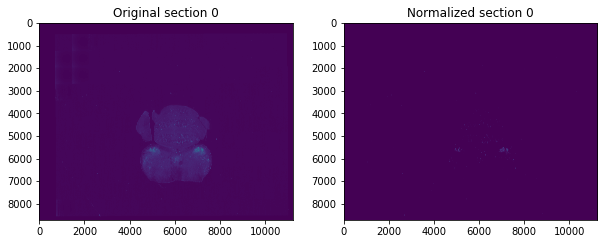

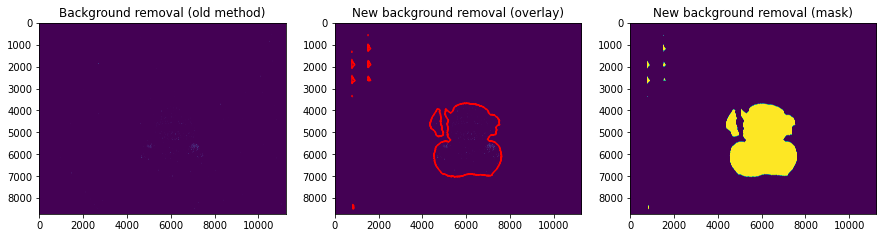

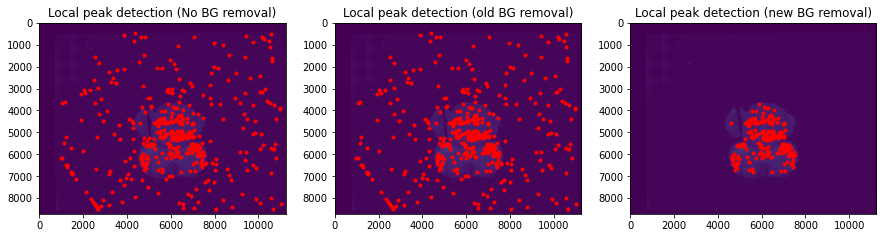

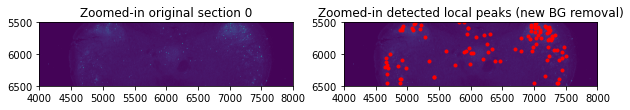

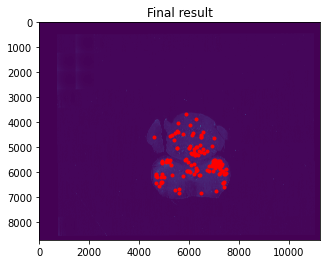

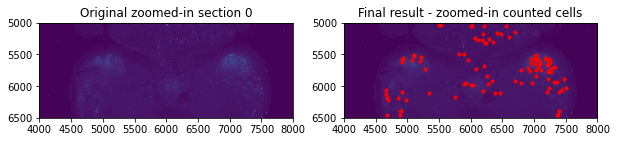

Number of detected cells: 131 


1 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0002_1_0.tif


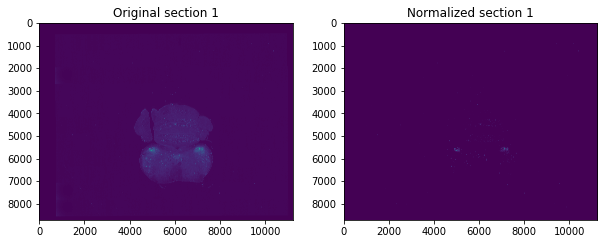

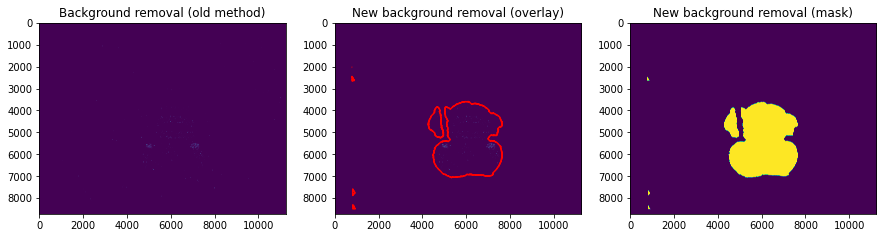

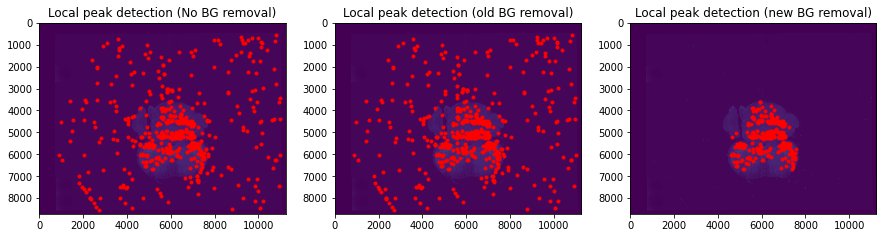

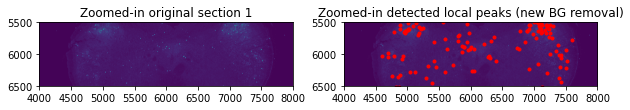

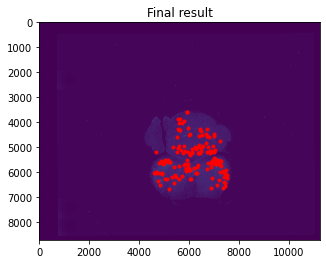

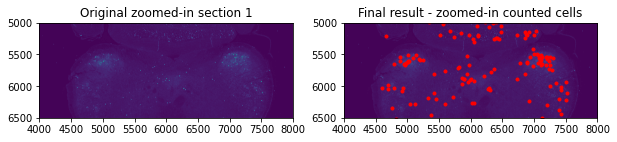

Number of detected cells: 168 


2 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0003_1_0.tif


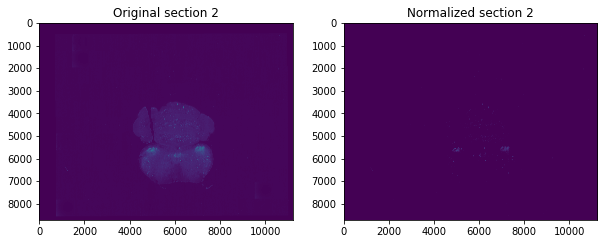

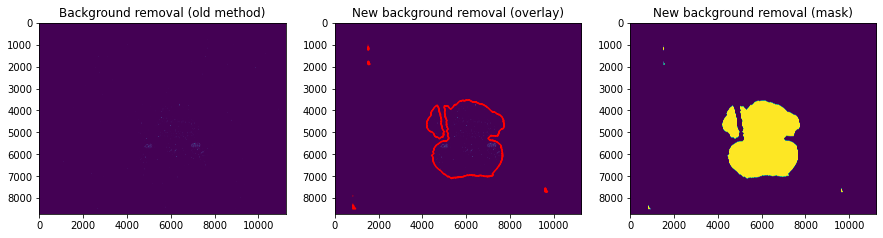

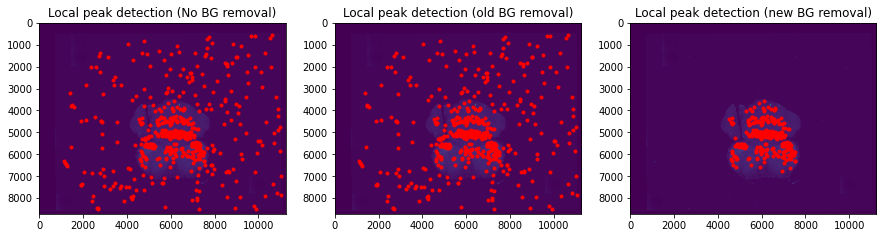

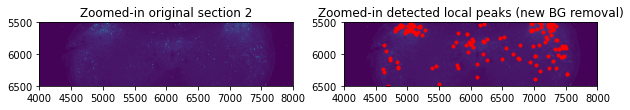

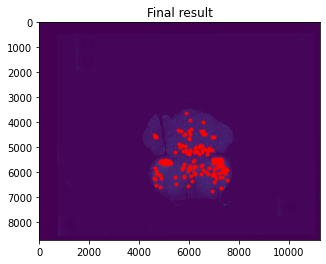

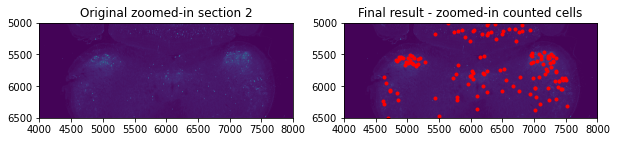

Number of detected cells: 169 


3 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0004_1_0.tif


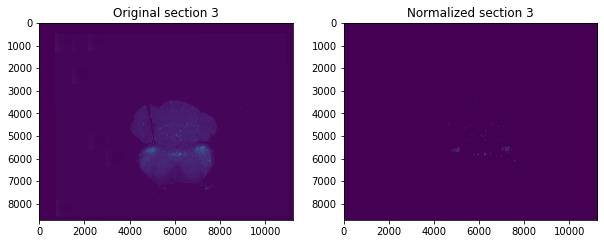

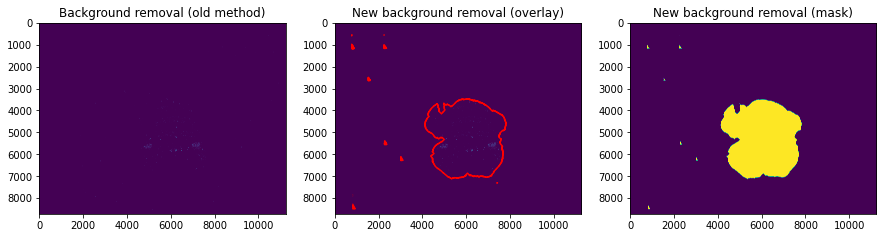

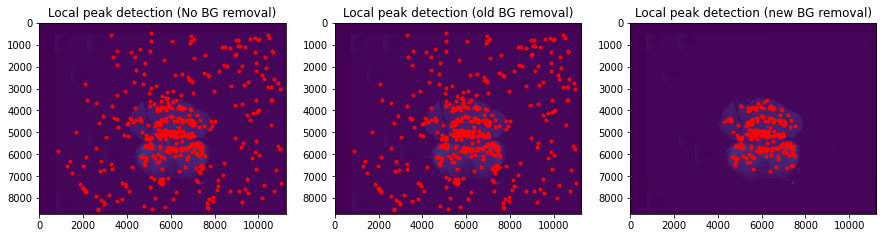

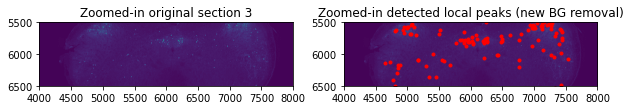

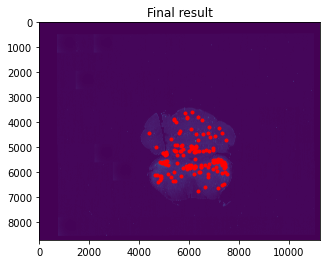

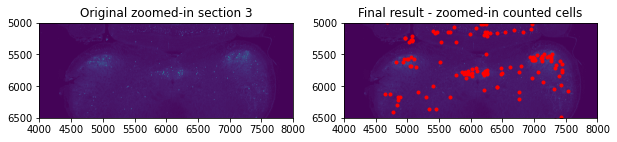

Number of detected cells: 162 


4 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0005_1_0.tif


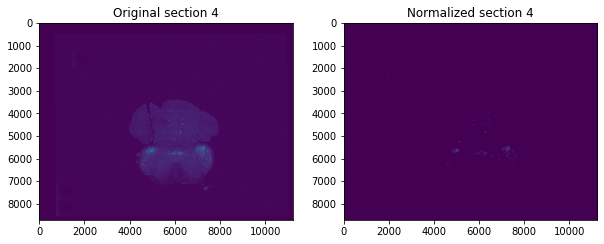

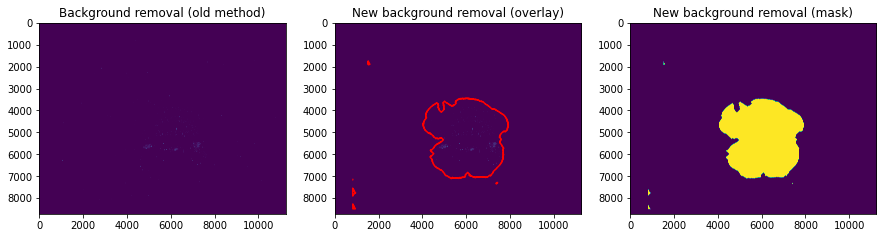

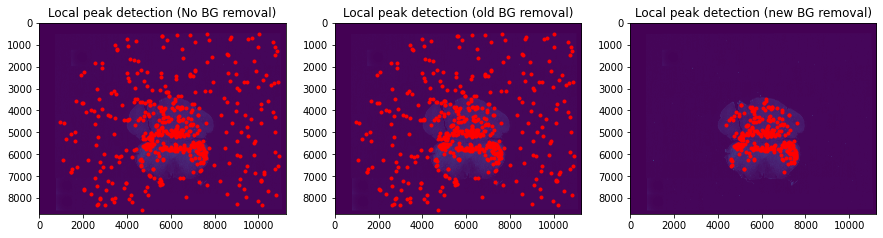

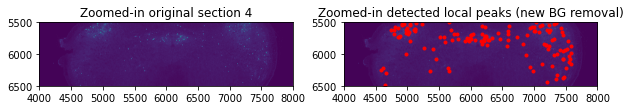

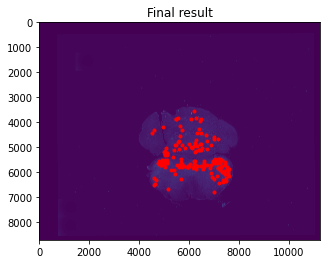

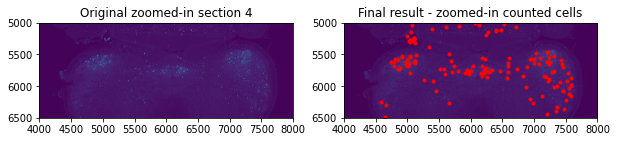

Number of detected cells: 179 


5 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0006_1_0.tif


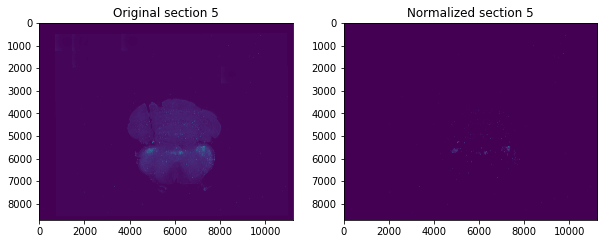

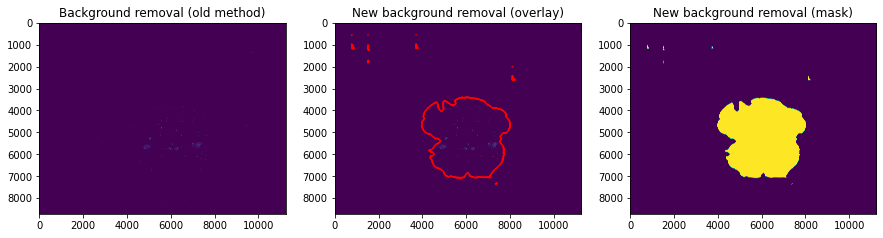

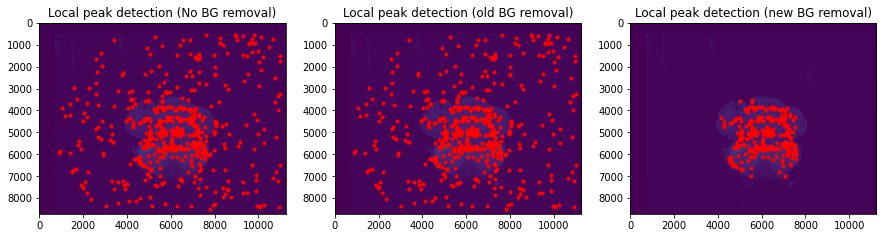

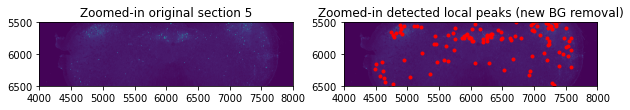

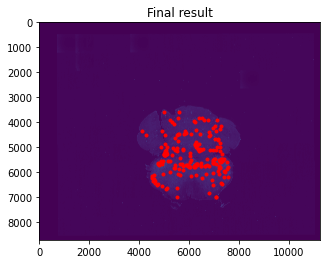

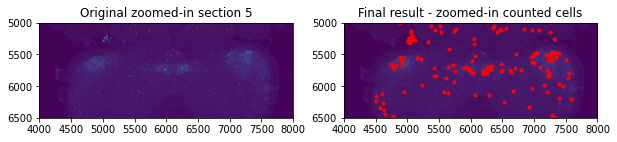

Number of detected cells: 205 


6 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0007_1_0.tif


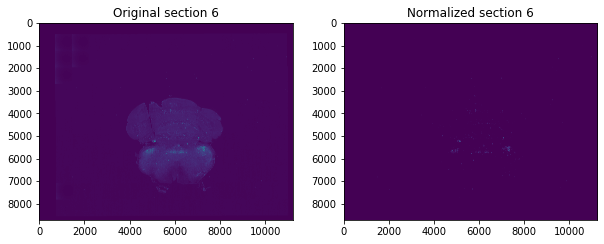

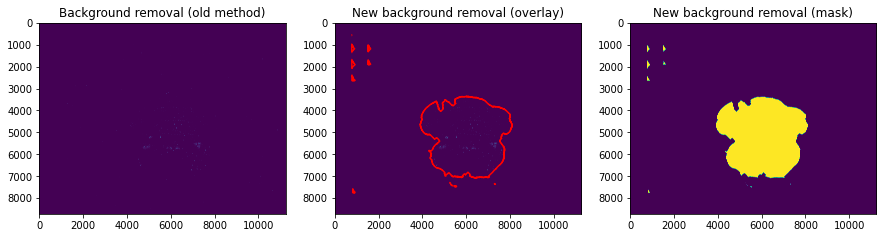

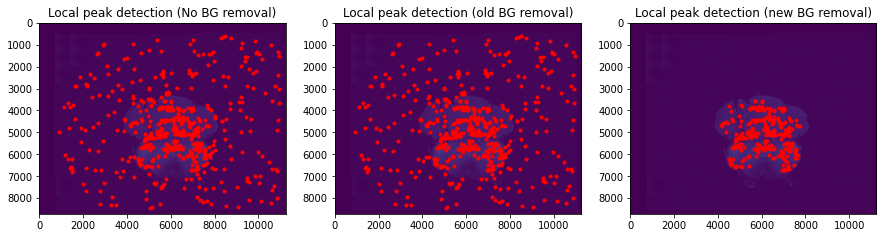

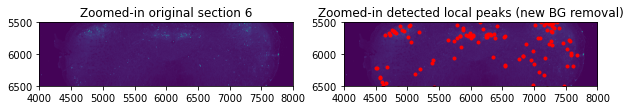

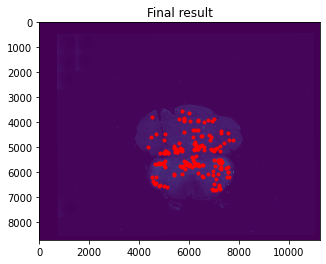

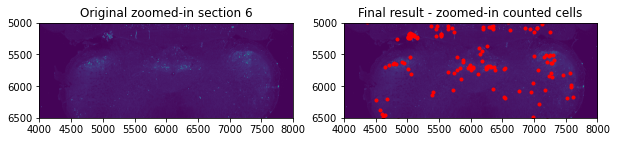

Number of detected cells: 188 


7 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0008_1_0.tif


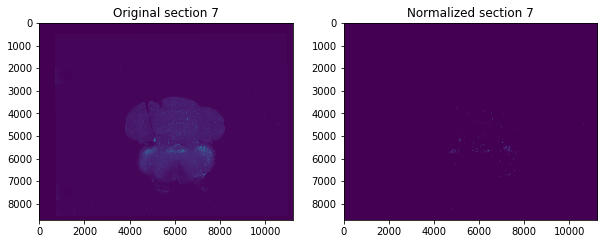

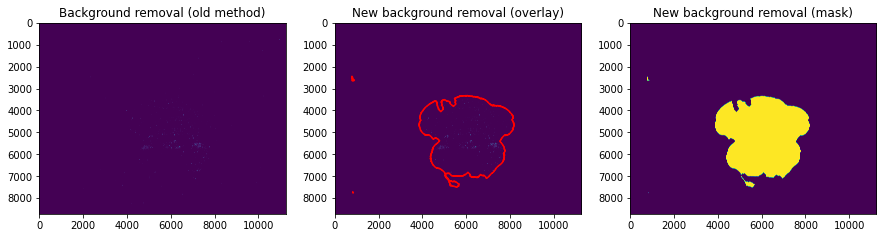

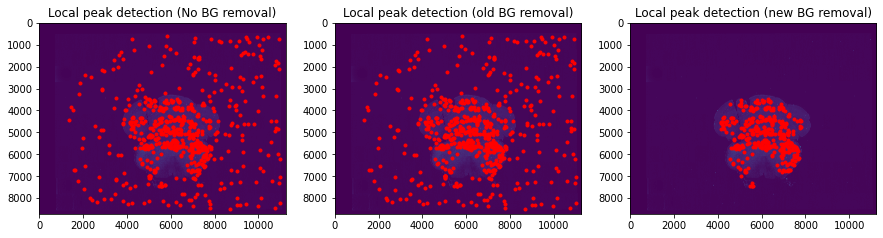

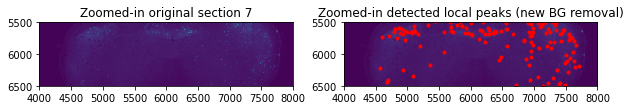

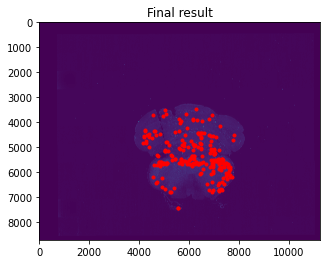

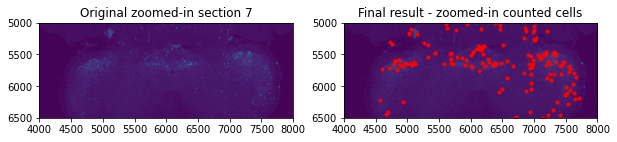

Number of detected cells: 232 


8 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0009_1_0.tif


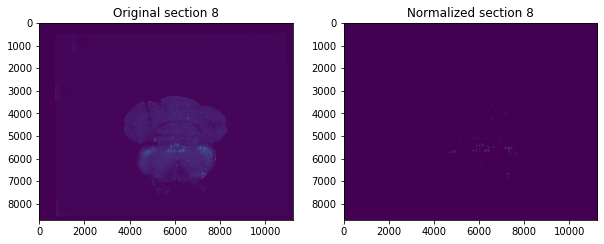

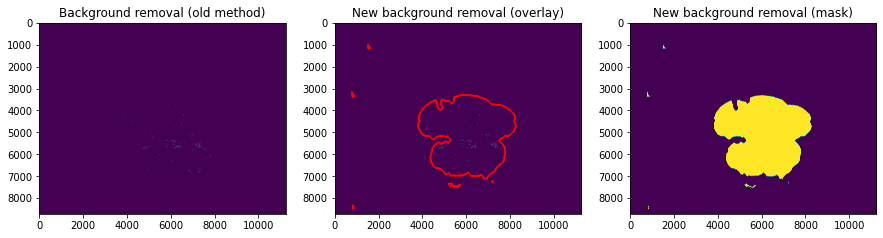

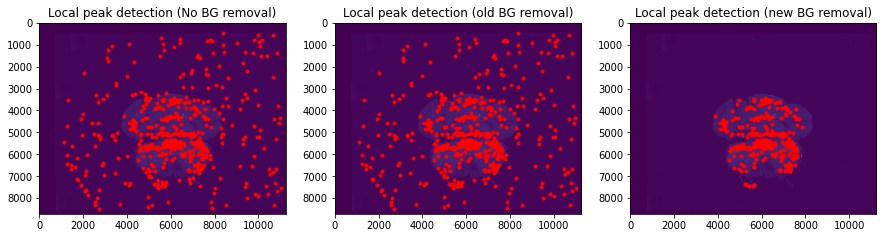

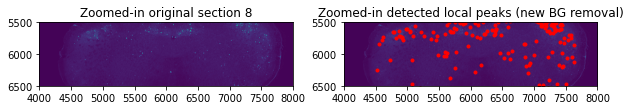

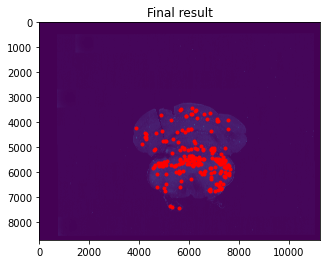

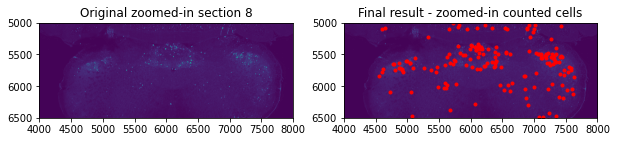

Number of detected cells: 236 


9 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0010_1_0.tif


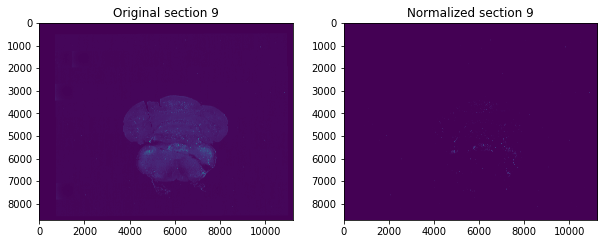

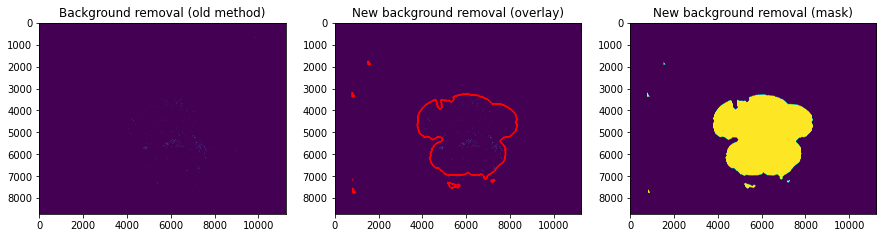

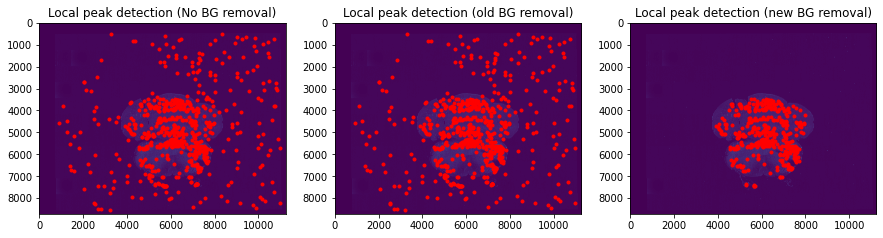

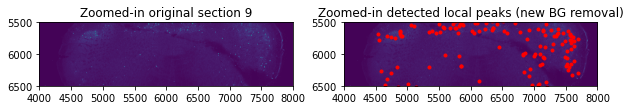

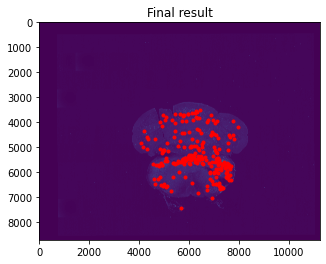

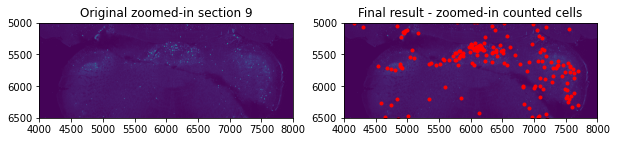

Number of detected cells: 252 


10 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0011_1_0.tif


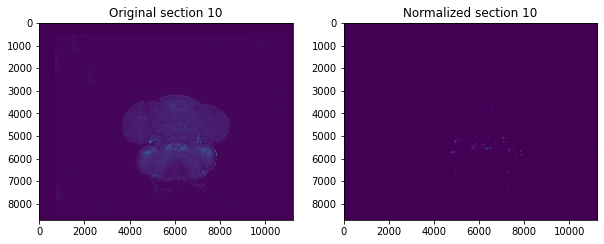

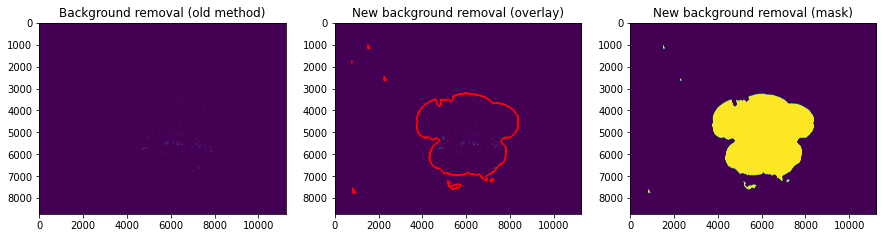

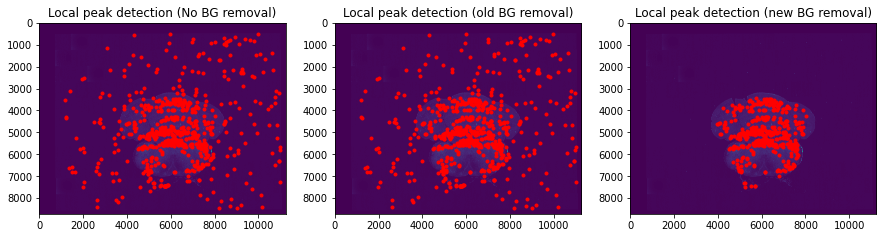

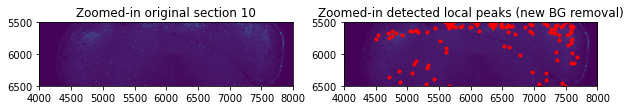

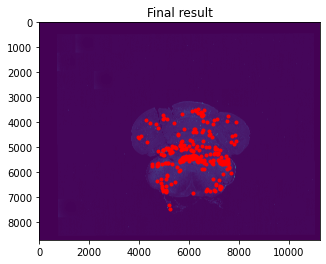

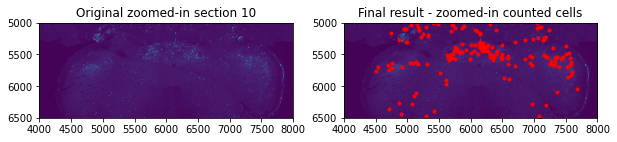

Number of detected cells: 262 


11 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0012_1_0.tif


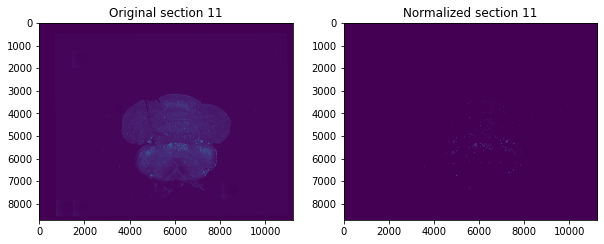

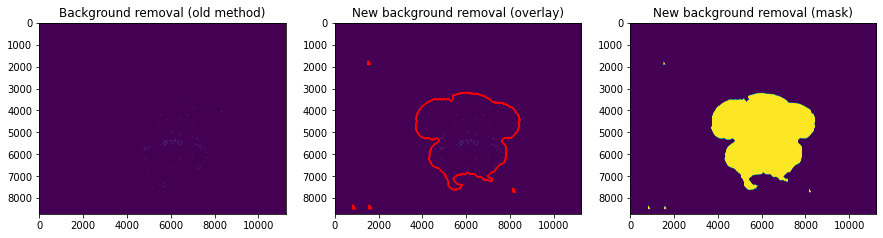

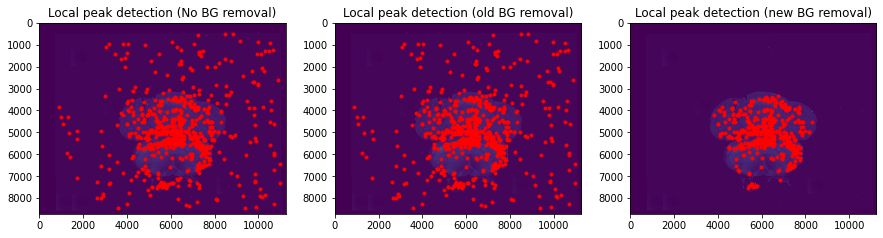

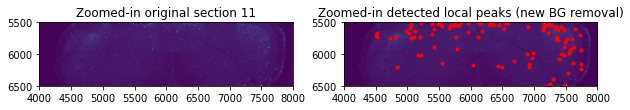

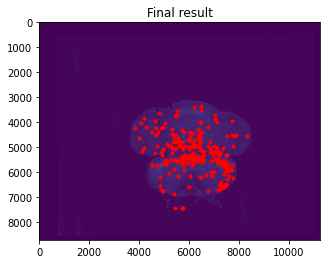

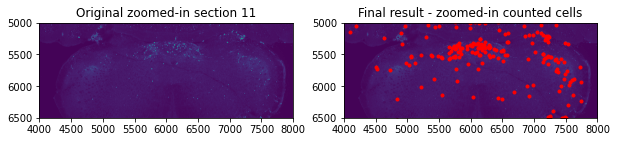

Number of detected cells: 292 


12 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0013_1_0.tif


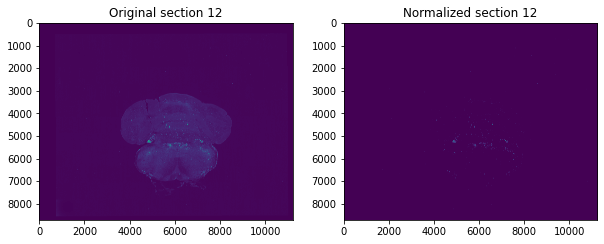

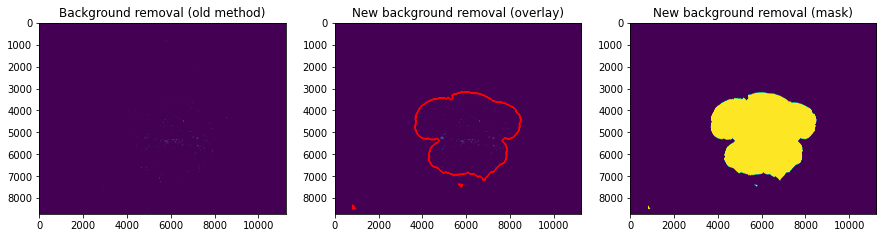

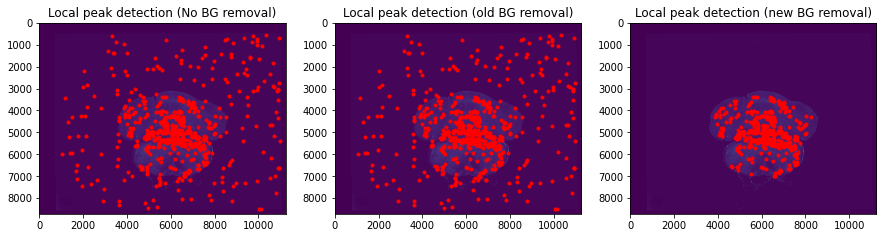

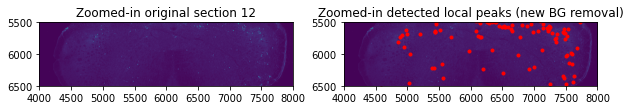

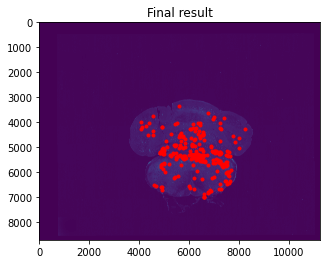

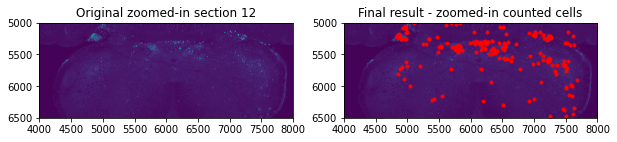

Number of detected cells: 279 


13 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0014_1_0.tif


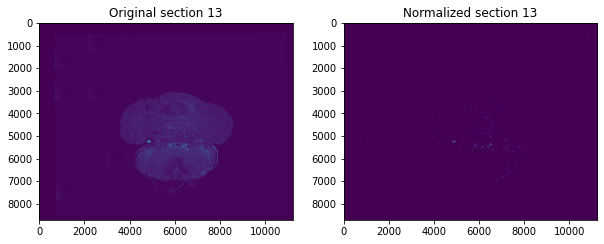

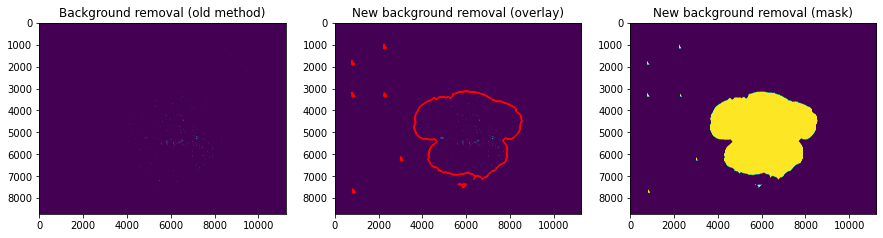

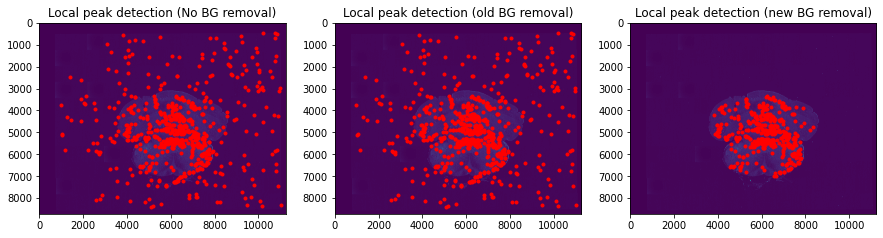

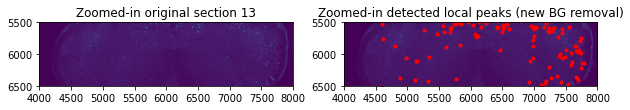

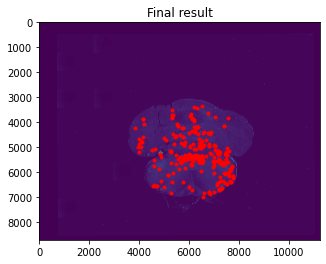

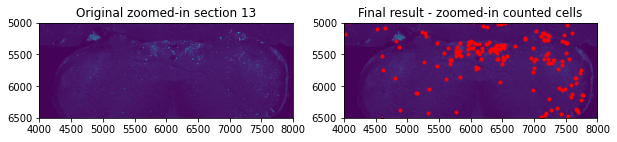

Number of detected cells: 272 


14 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0015_1_0.tif


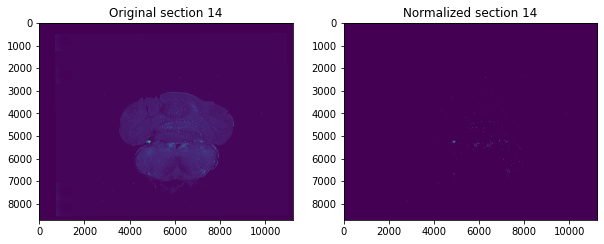

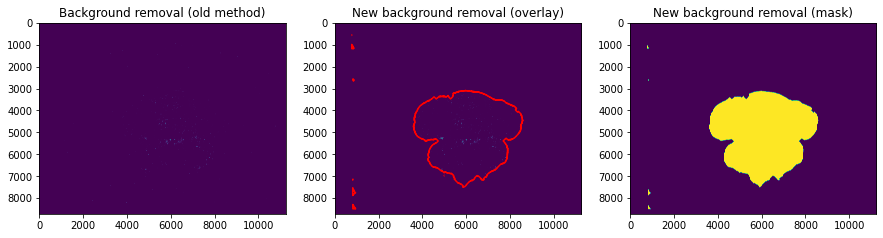

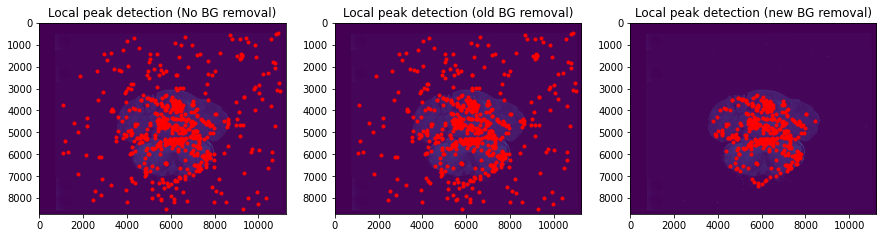

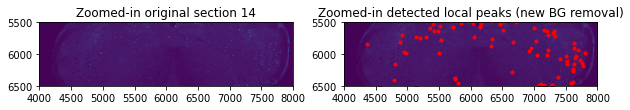

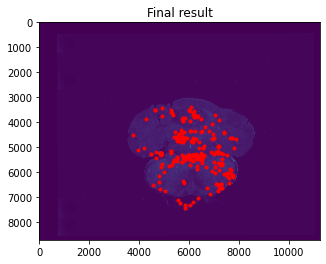

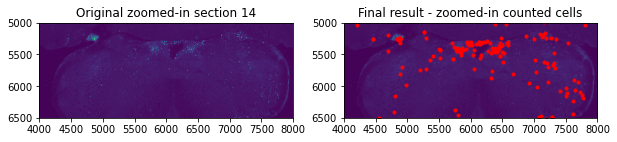

Number of detected cells: 248 


15 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0016_1_0.tif


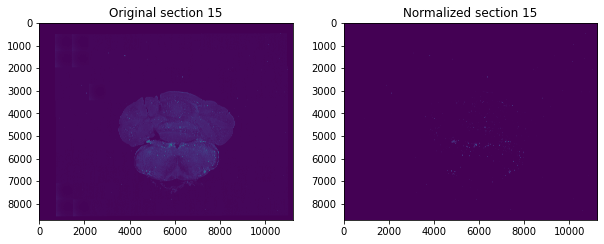

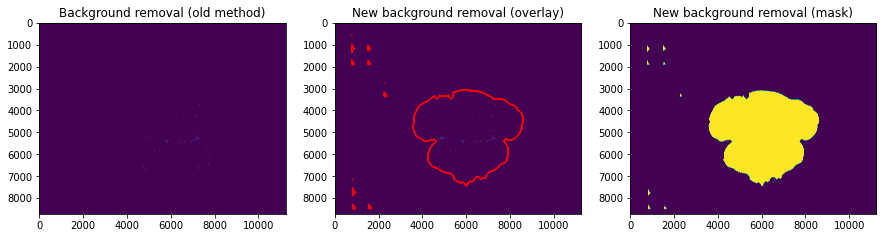

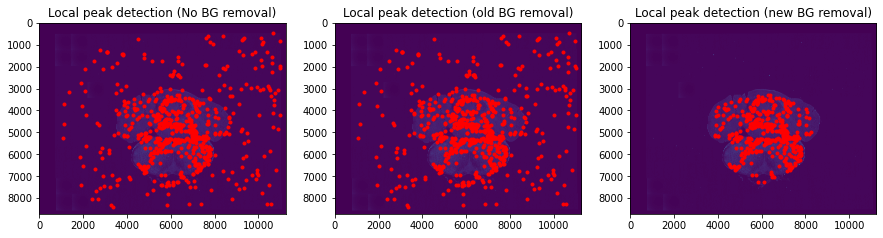

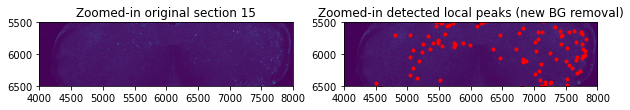

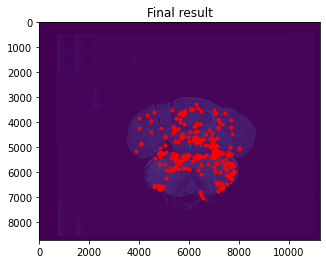

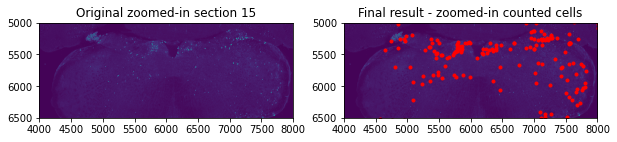

Number of detected cells: 276 


16 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0017_1_0.tif


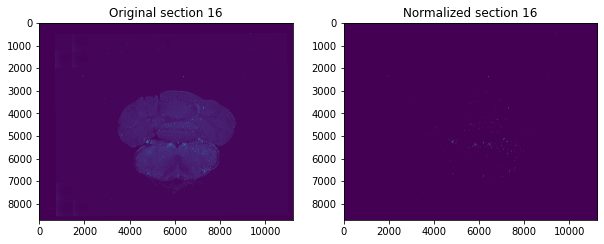

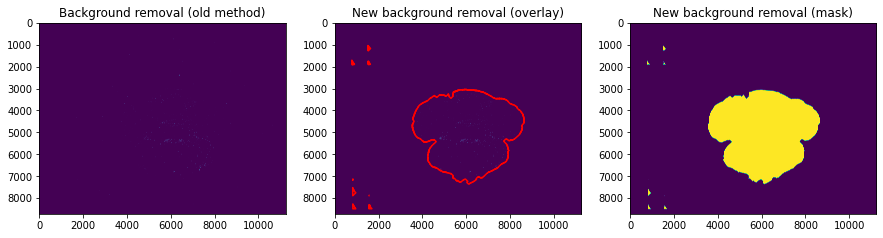

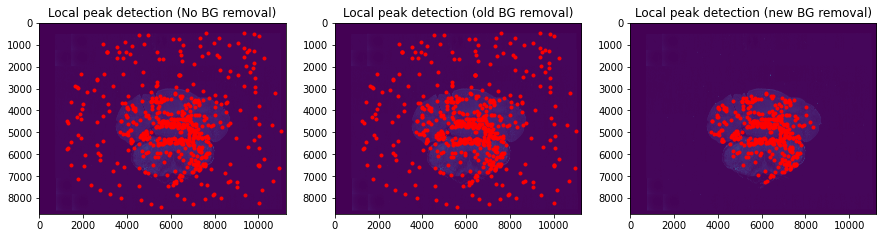

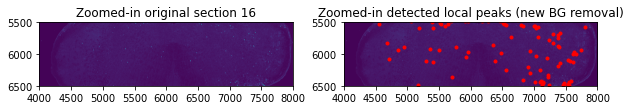

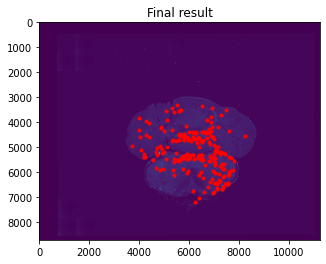

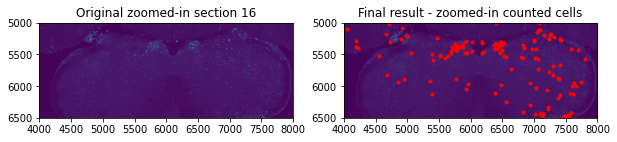

Number of detected cells: 234 


17 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0018_1_0.tif


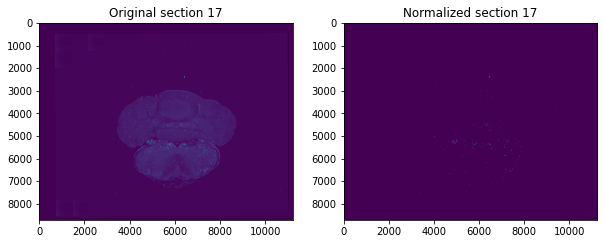

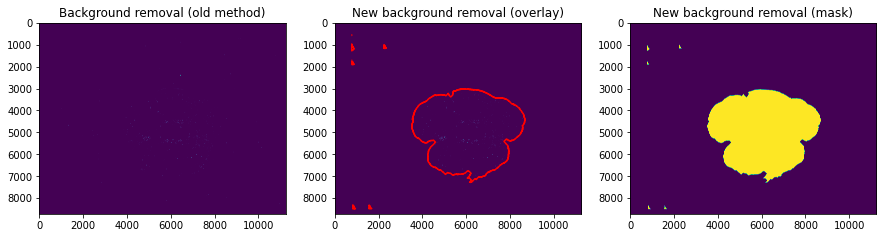

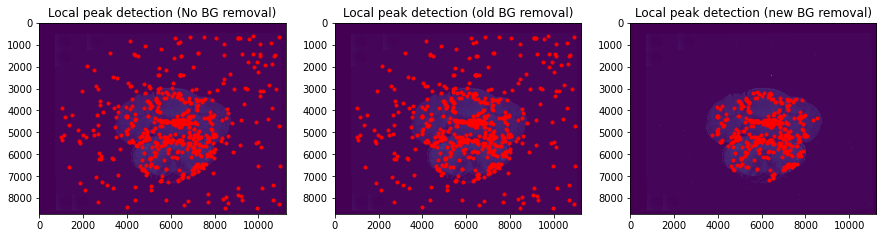

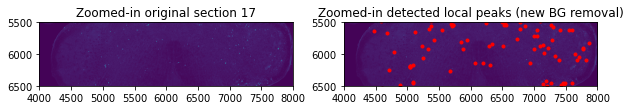

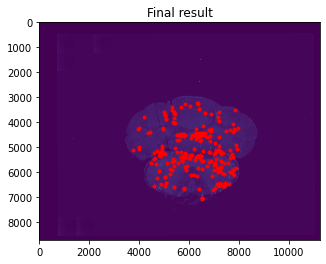

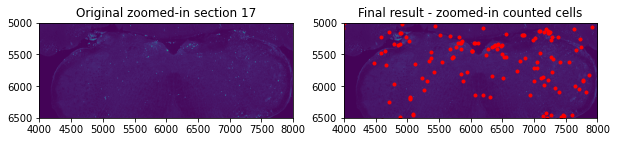

Number of detected cells: 239 


18 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0019_1_0.tif


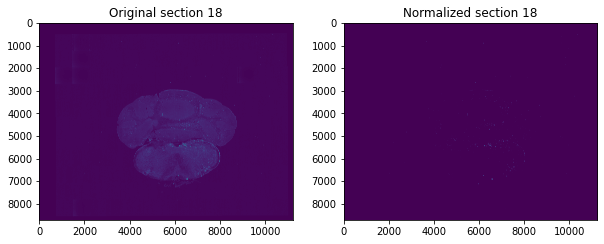

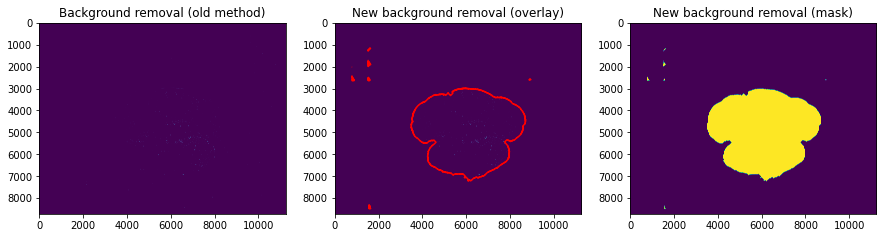

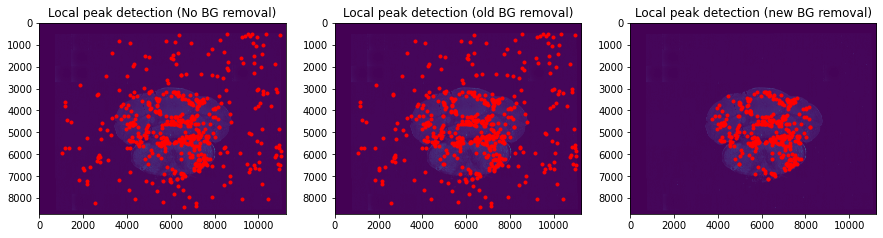

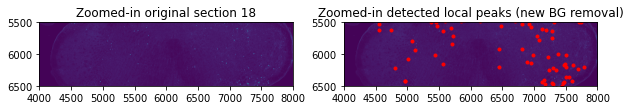

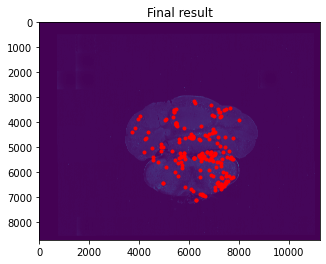

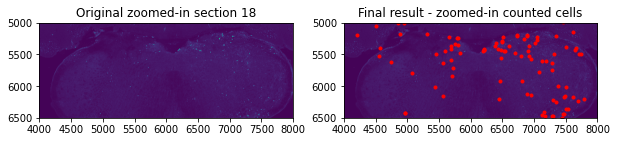

Number of detected cells: 182 


19 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0020_1_0.tif


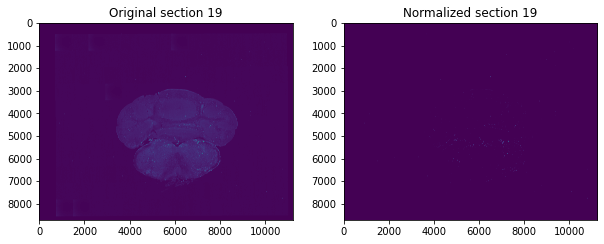

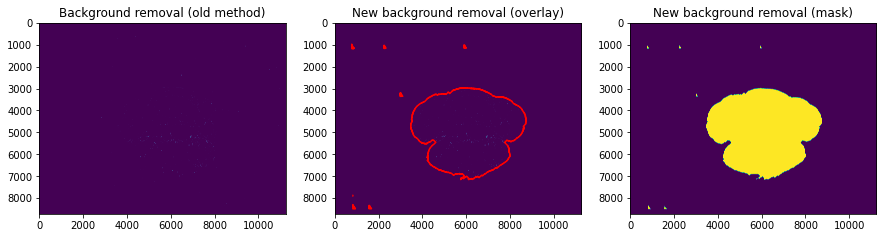

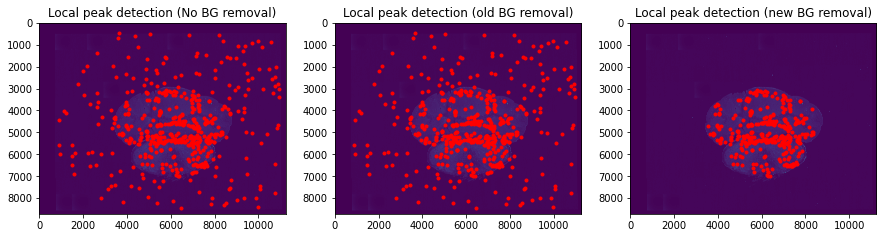

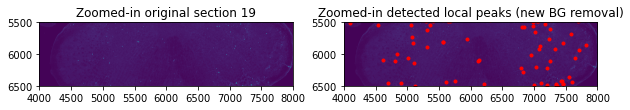

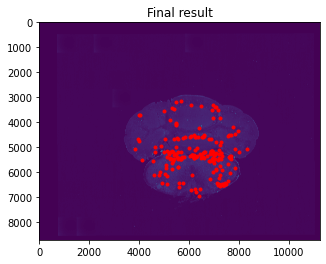

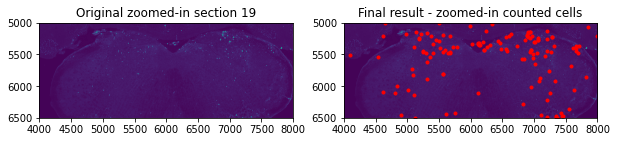

Number of detected cells: 194 


20 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0021_1_0.tif


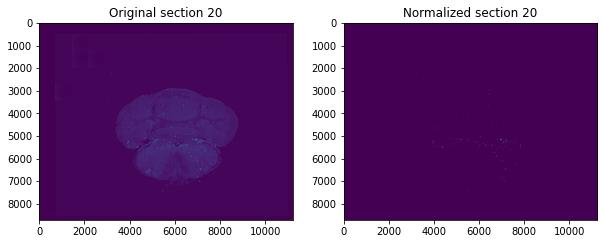

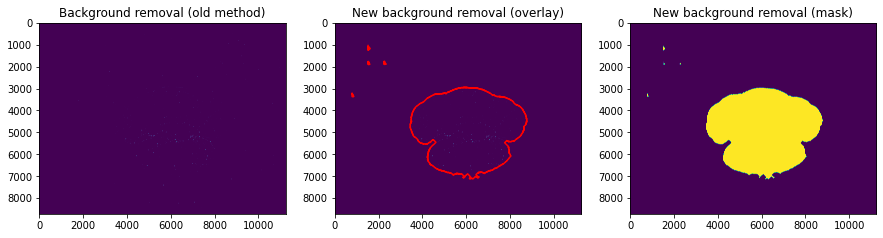

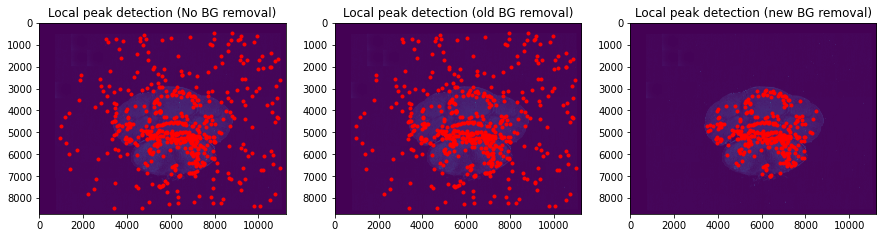

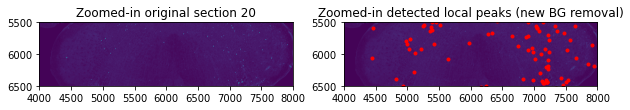

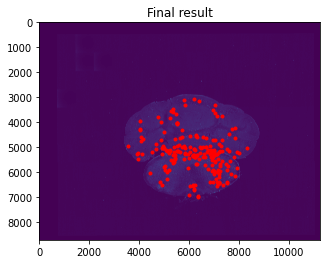

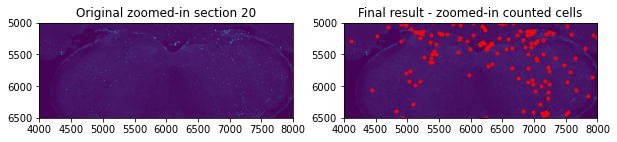

Number of detected cells: 213 


21 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0022_1_0.tif


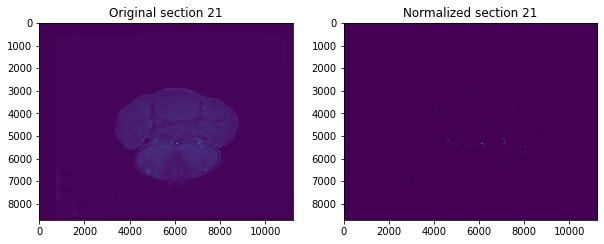

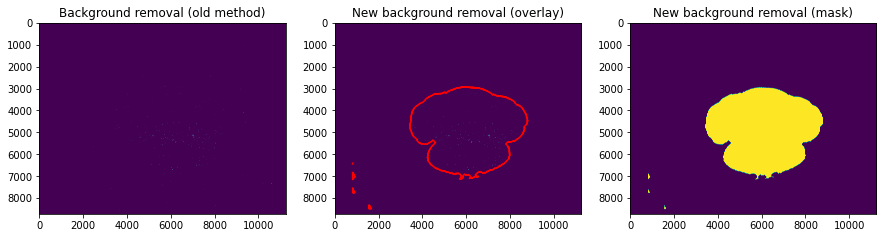

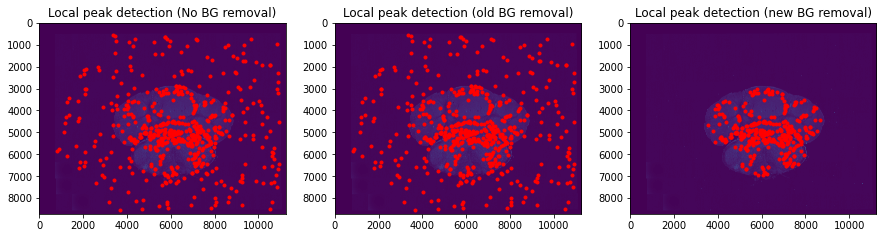

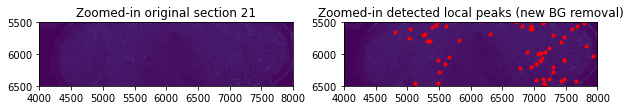

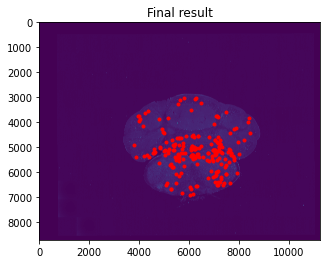

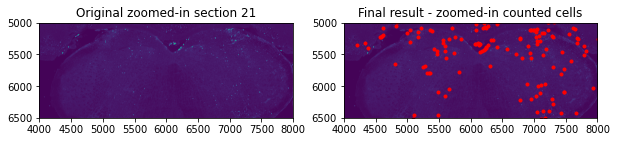

Number of detected cells: 214 


22 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0023_1_0.tif


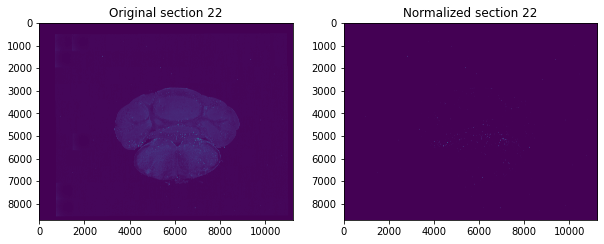

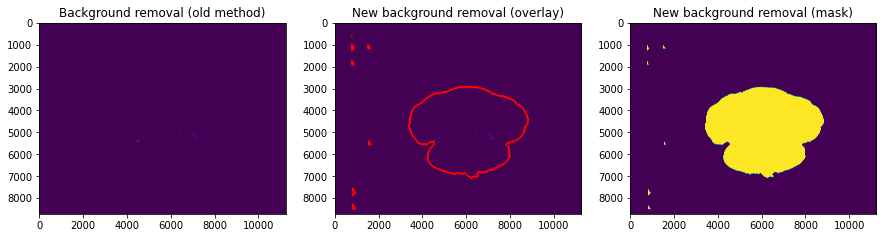

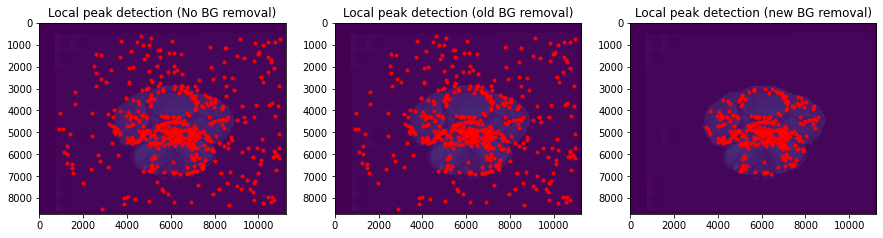

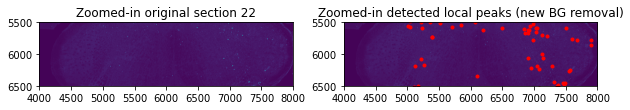

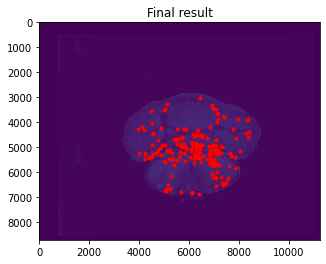

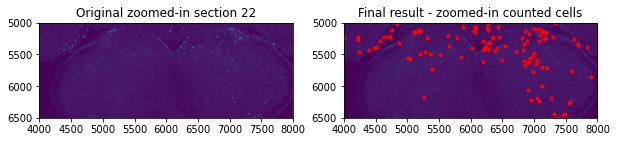

Number of detected cells: 215 


23 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0024_1_0.tif


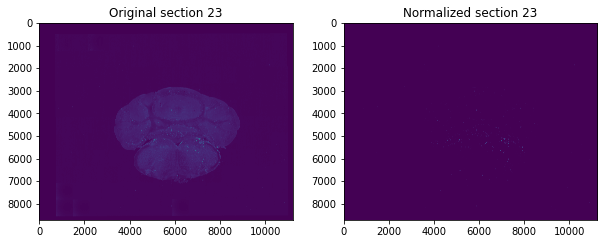

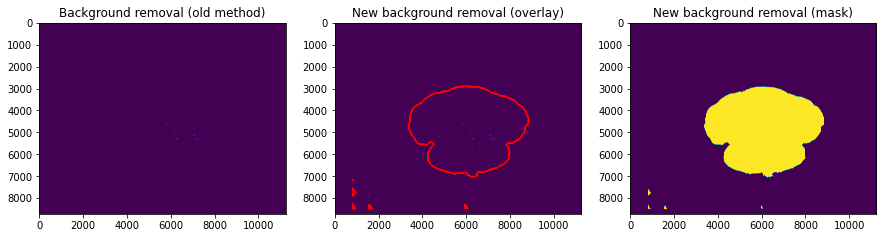

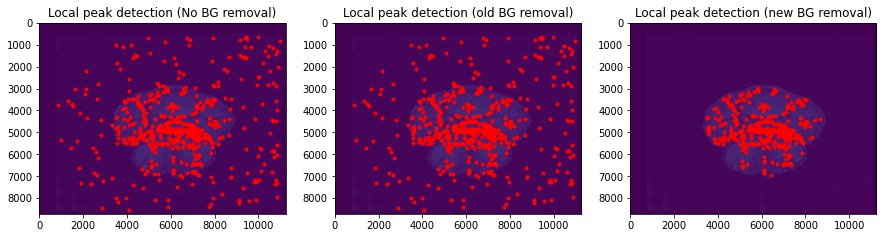

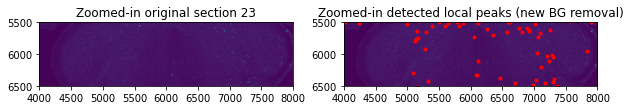

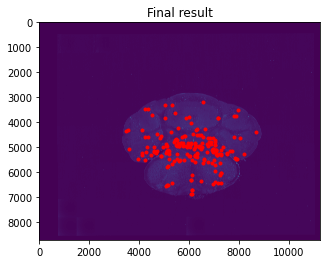

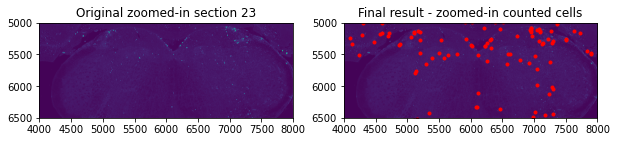

Number of detected cells: 186 


24 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0025_1_0.tif


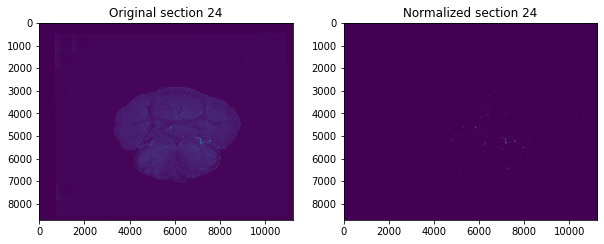

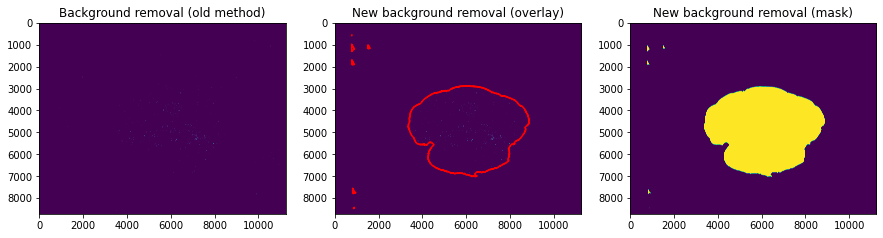

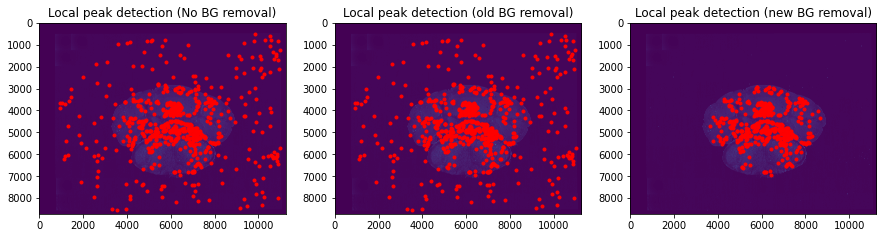

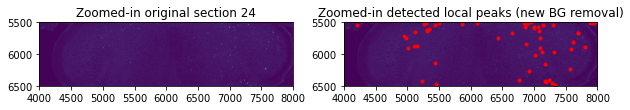

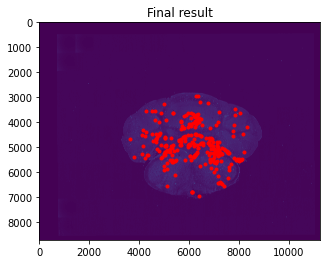

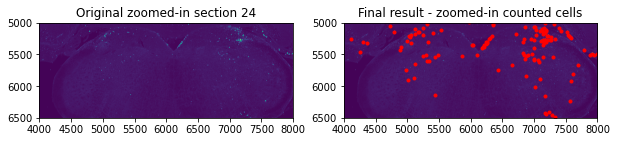

Number of detected cells: 289 


25 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0026_1_0.tif


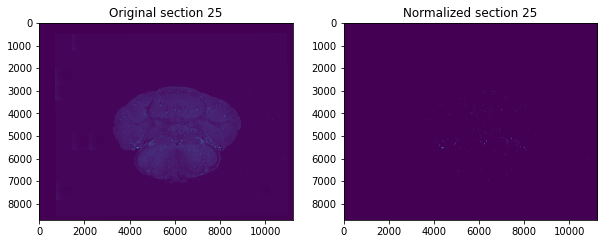

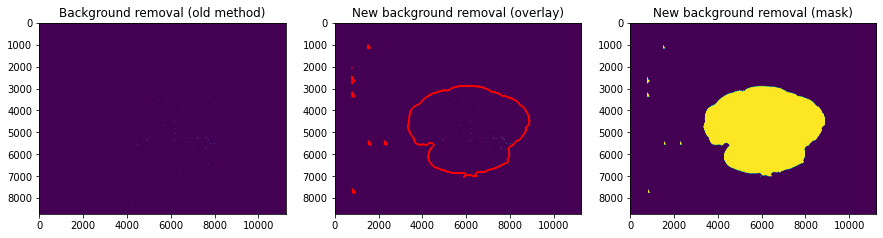

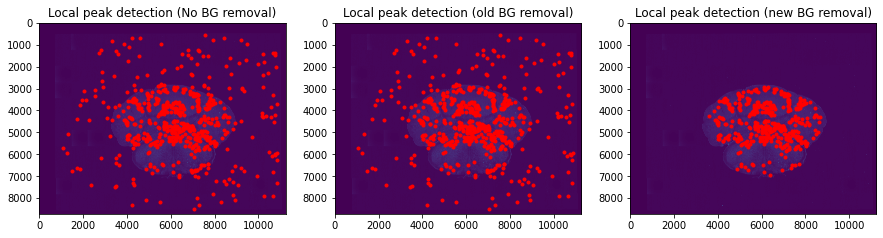

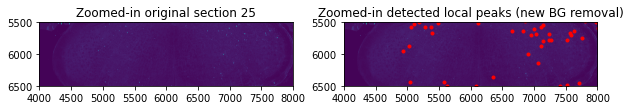

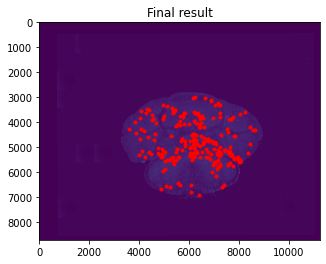

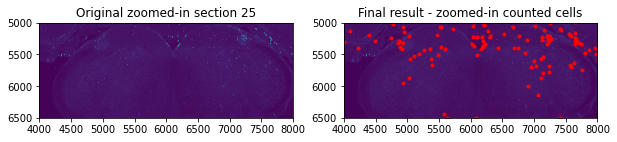

Number of detected cells: 249 


26 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0027_1_0.tif


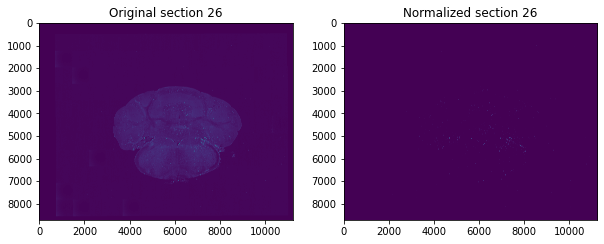

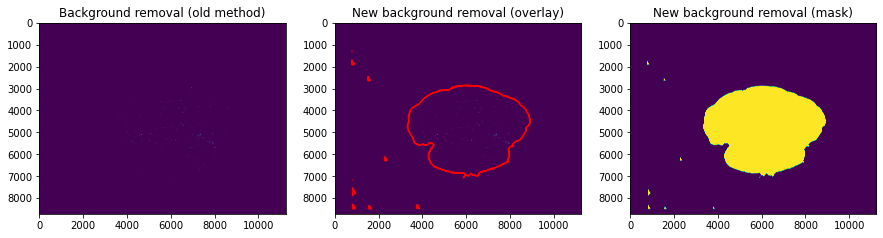

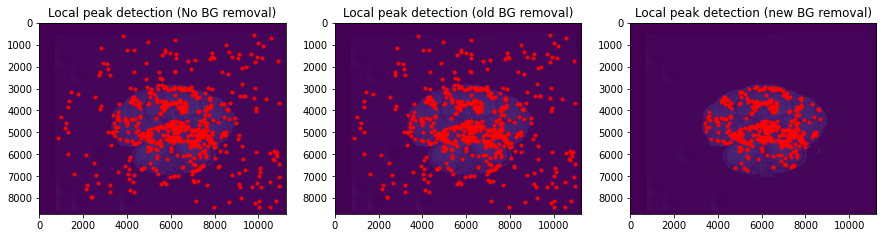

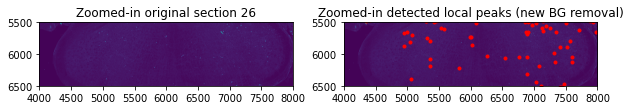

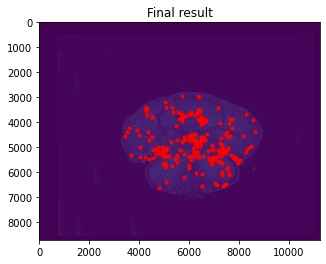

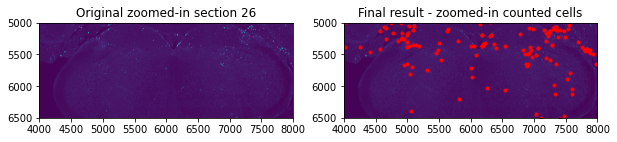

Number of detected cells: 244 


27 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0028_1_0.tif


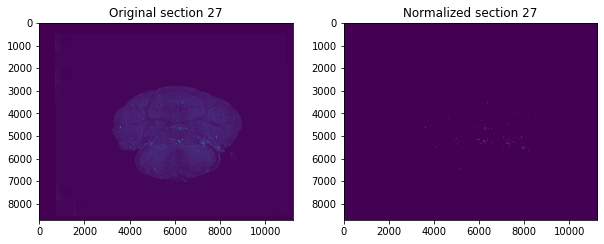

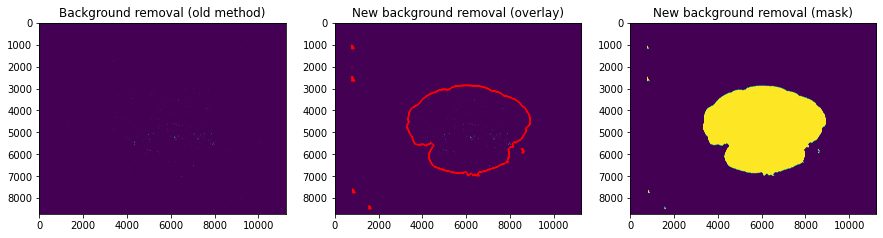

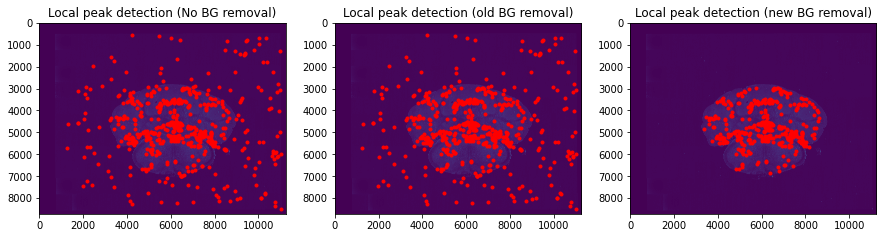

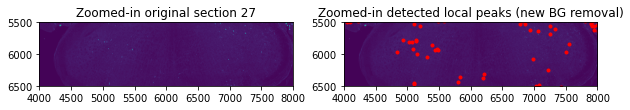

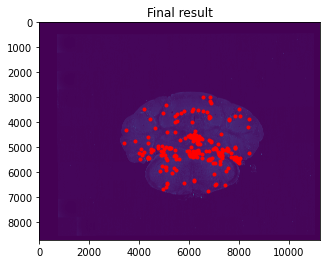

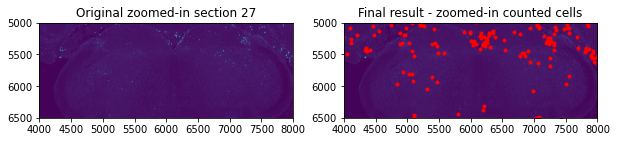

Number of detected cells: 233 


28 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0029_1_0.tif


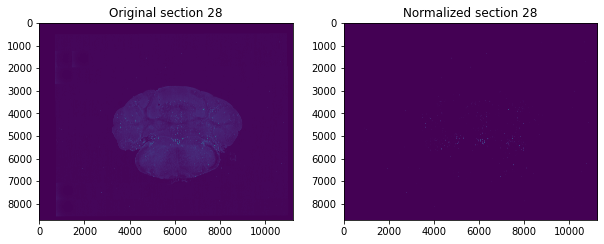

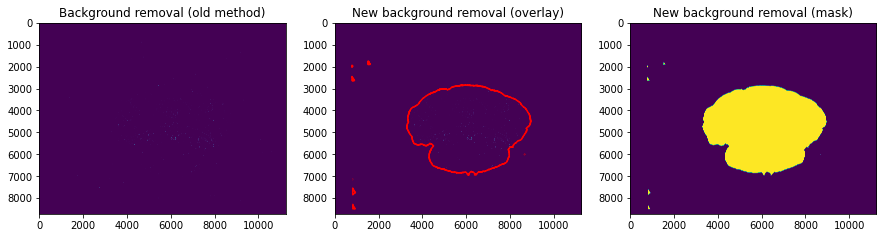

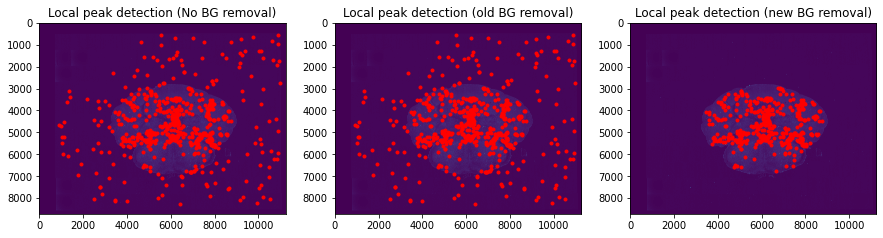

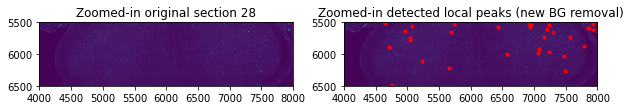

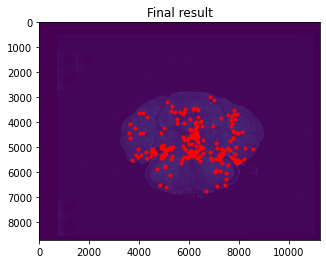

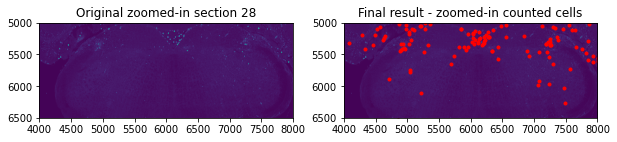

Number of detected cells: 222 


29 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0030_1_0.tif


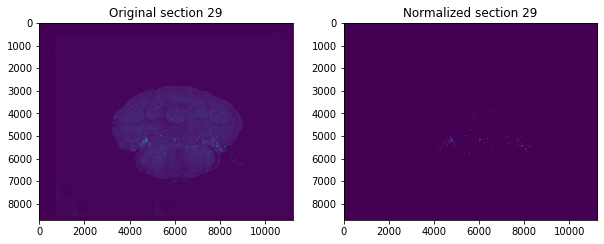

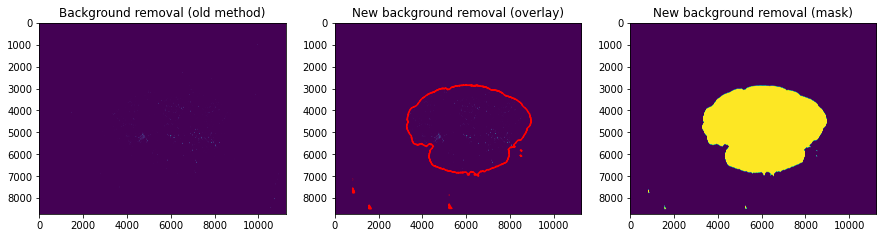

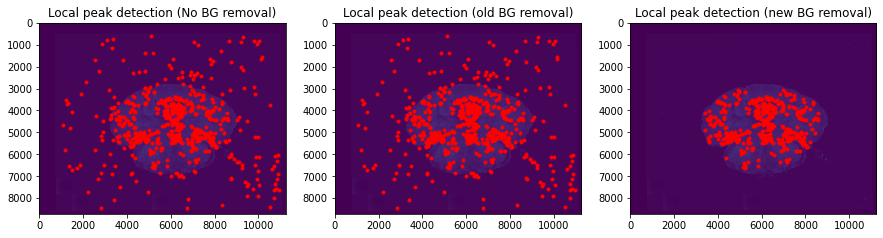

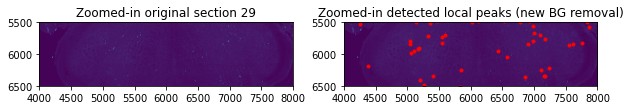

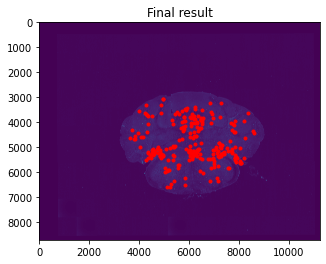

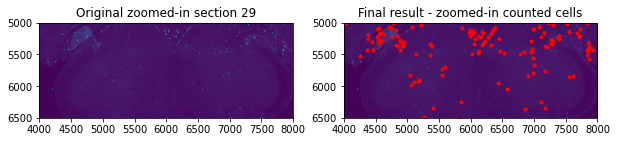

Number of detected cells: 253 


30 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0031_1_0.tif


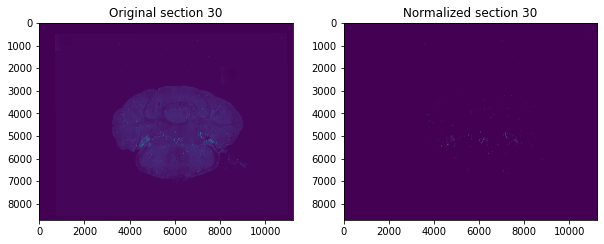

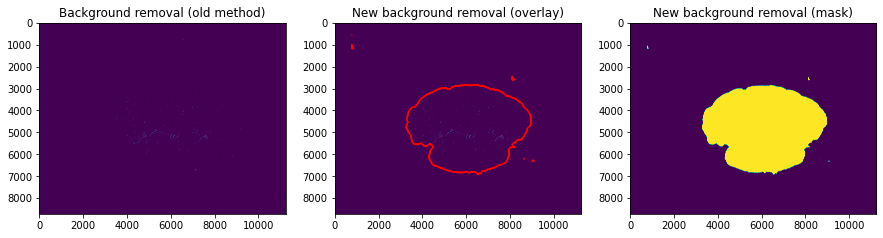

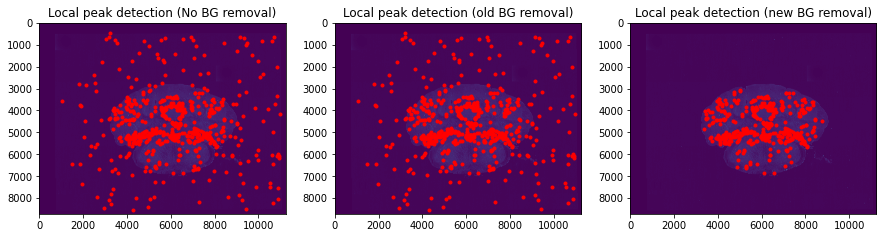

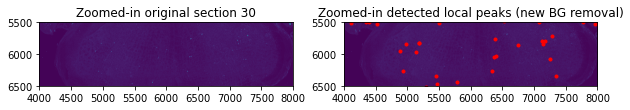

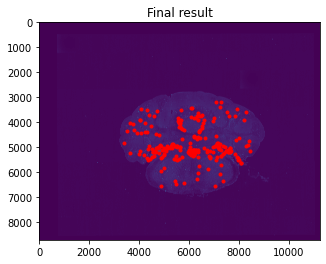

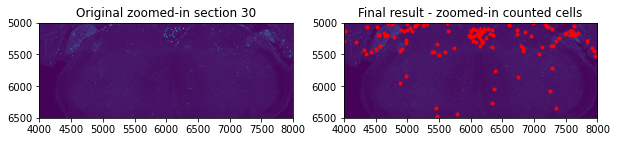

Number of detected cells: 235 


31 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0032_1_0.tif


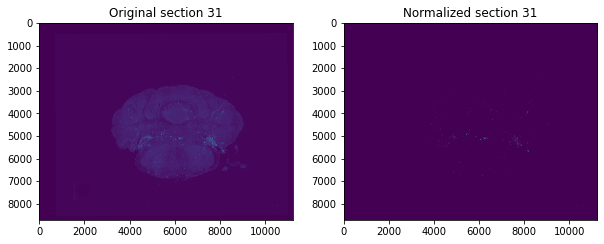

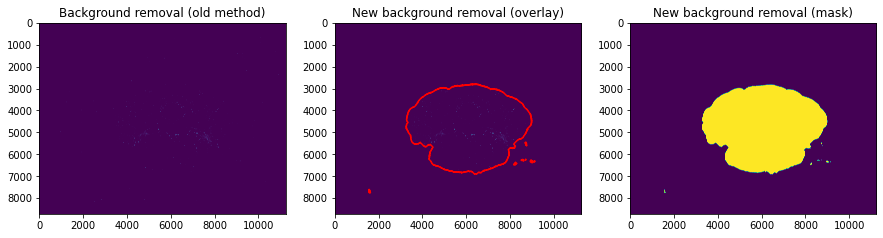

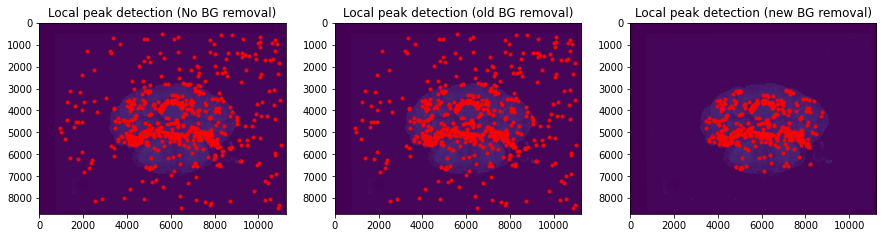

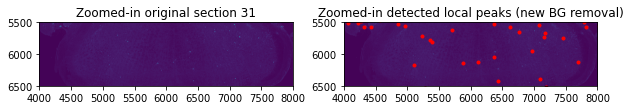

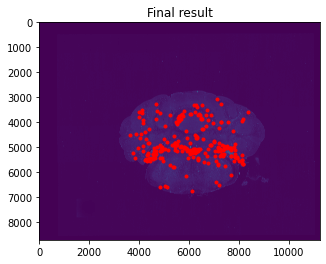

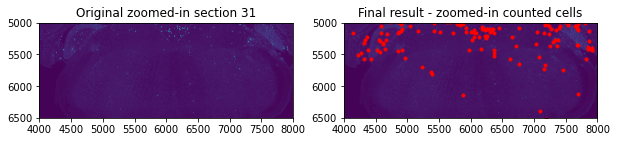

Number of detected cells: 244 


32 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0033_1_0.tif


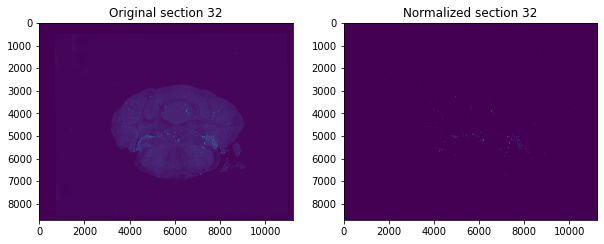

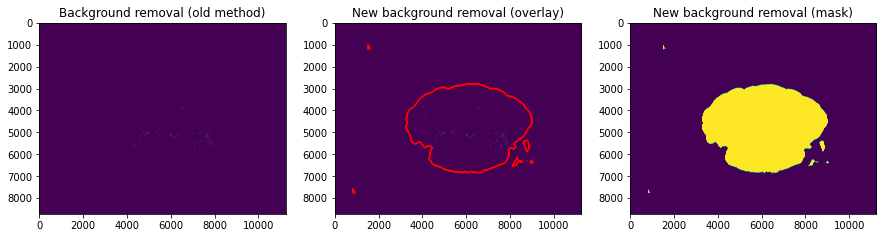

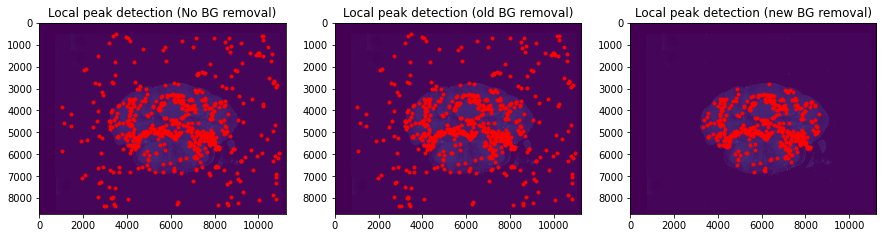

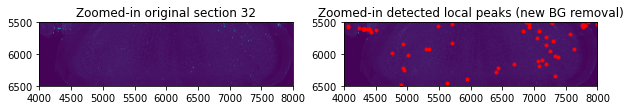

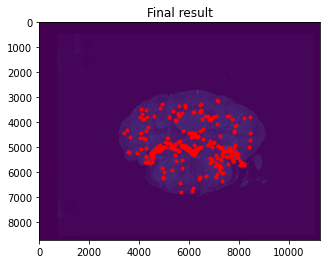

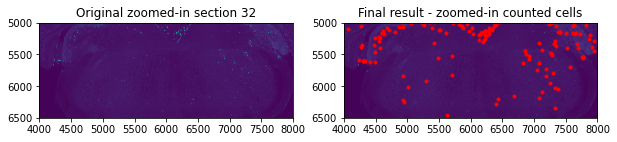

Number of detected cells: 256 


33 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0034_1_0.tif


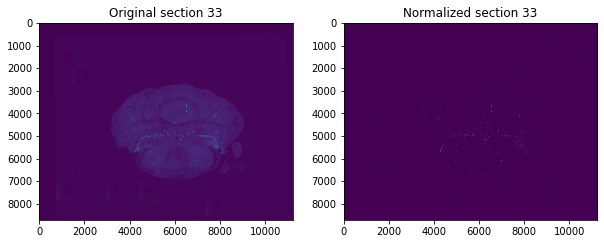

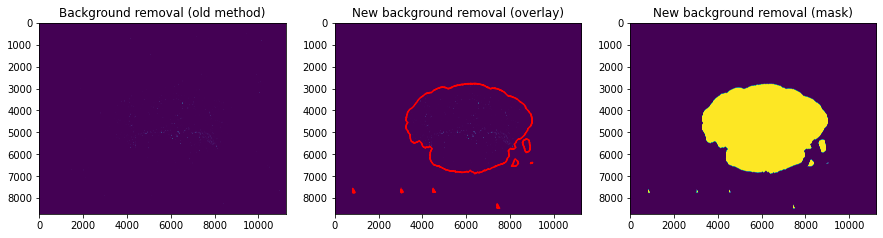

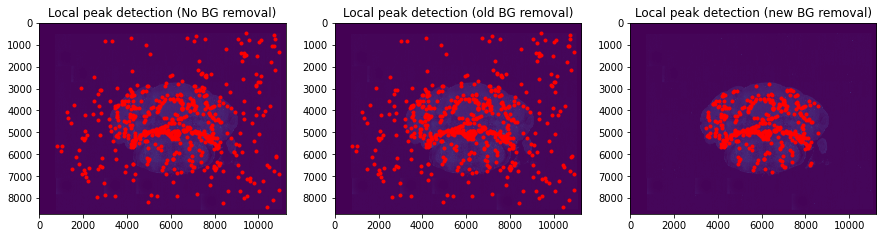

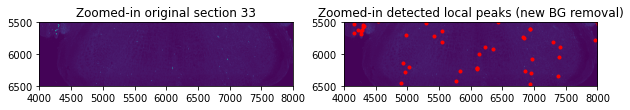

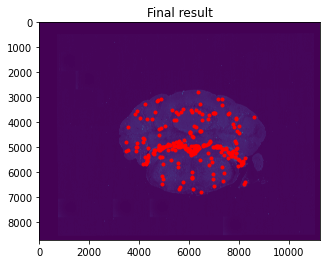

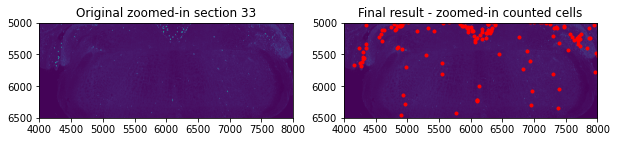

Number of detected cells: 263 


34 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0035_1_0.tif


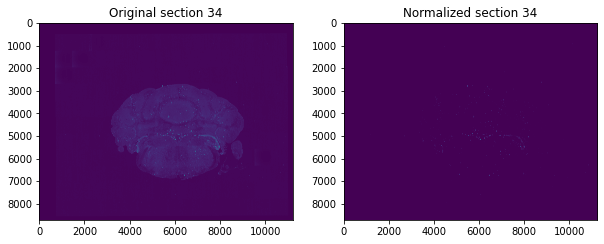

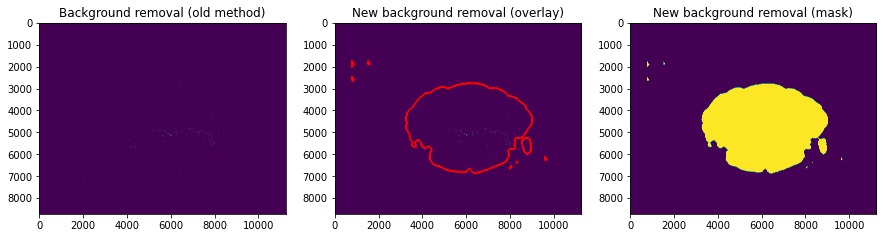

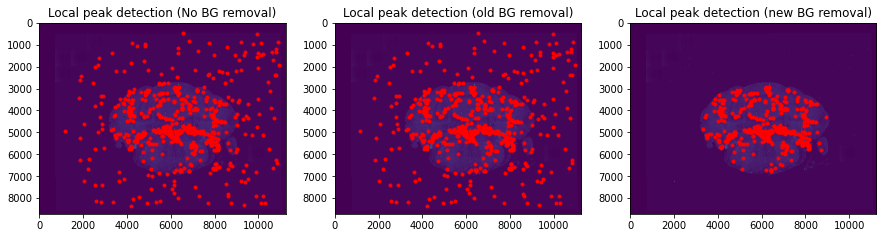

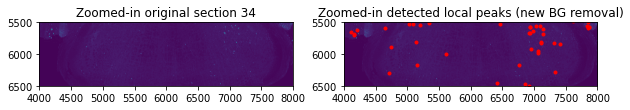

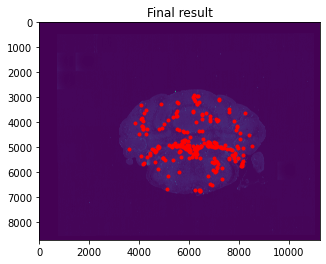

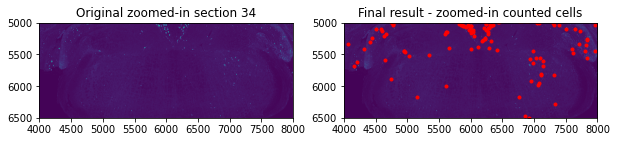

Number of detected cells: 246 


35 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0036_1_0.tif


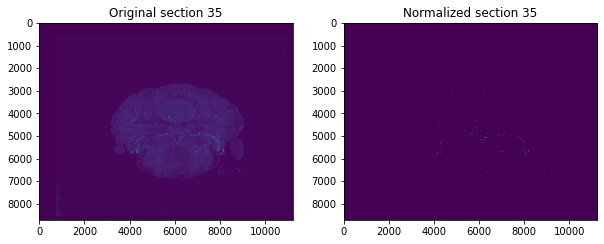

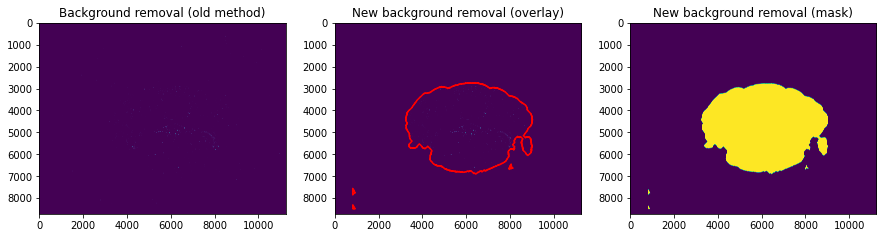

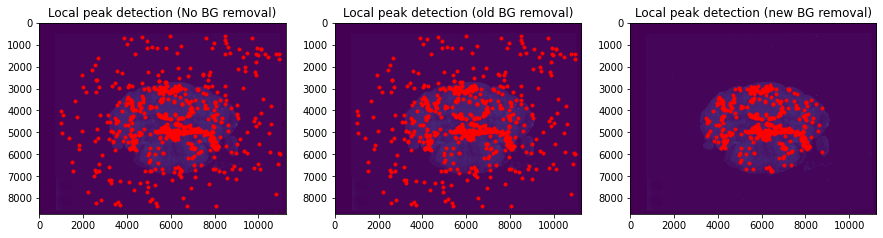

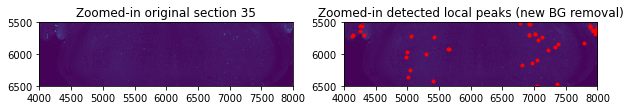

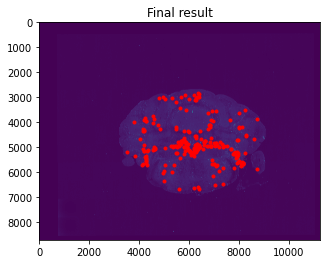

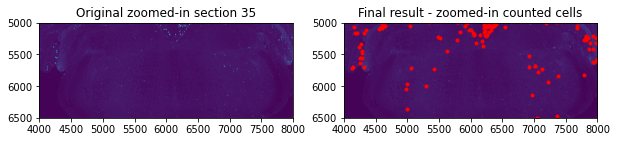

Number of detected cells: 240 


36 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0037_1_0.tif


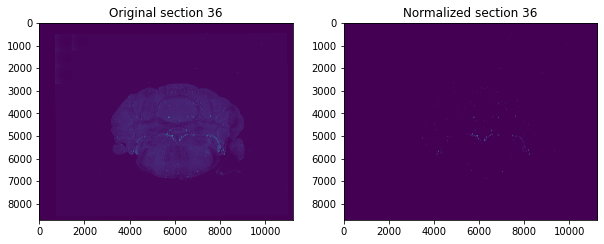

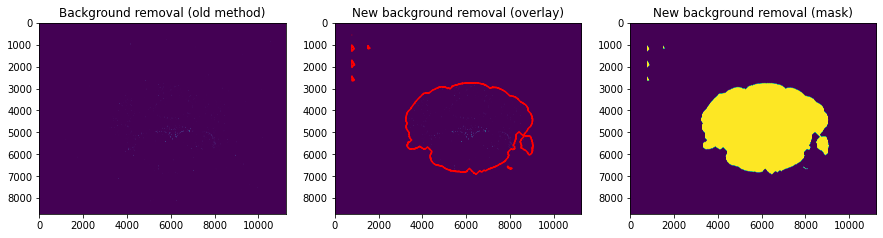

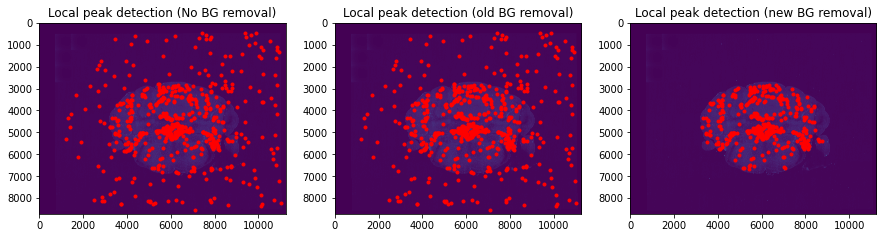

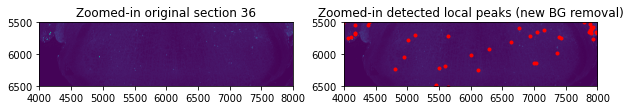

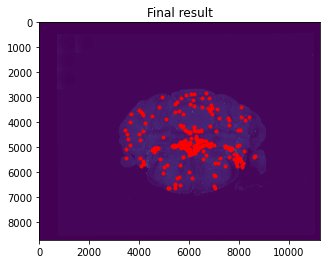

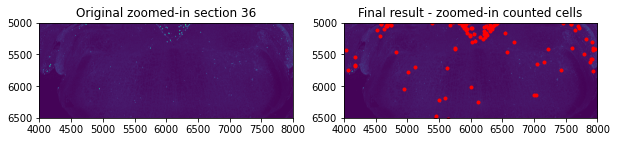

Number of detected cells: 259 


37 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0038_1_0.tif


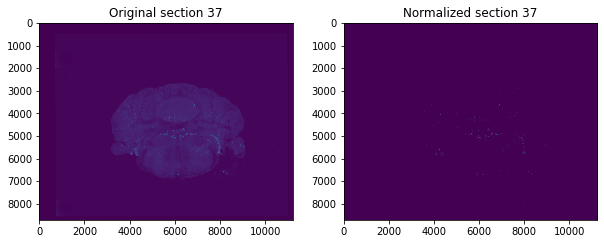

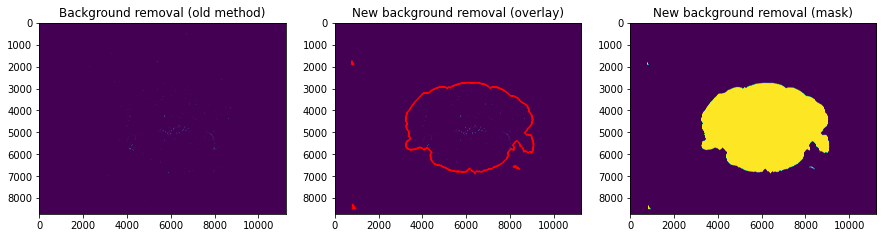

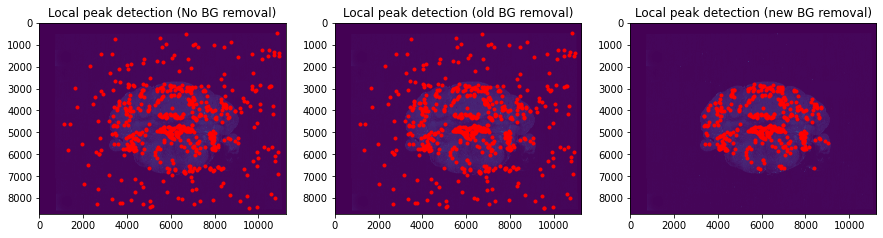

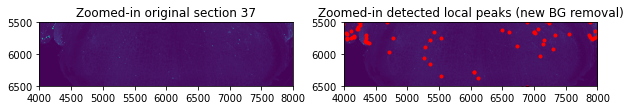

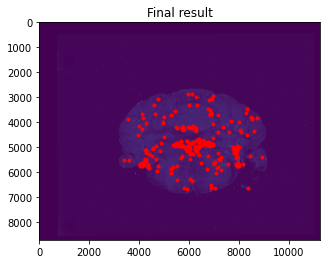

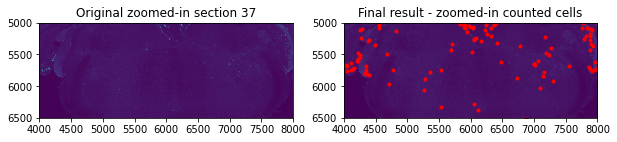

Number of detected cells: 255 


38 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0039_1_0.tif


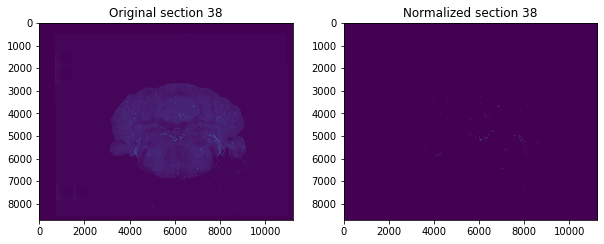

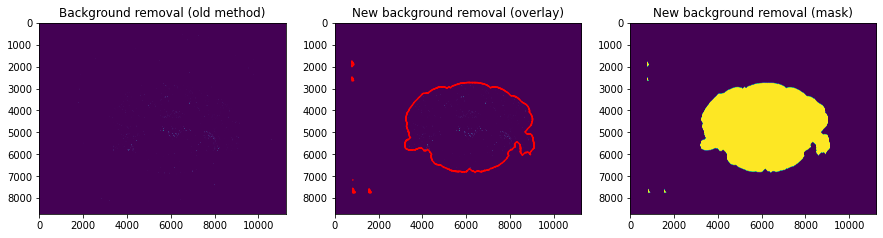

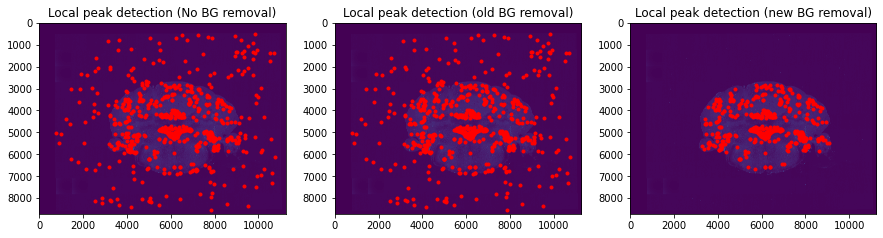

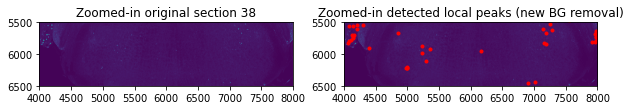

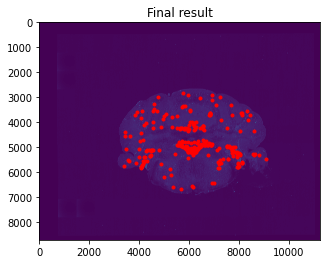

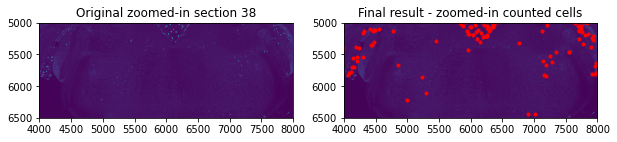

Number of detected cells: 258 


39 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0040_1_0.tif


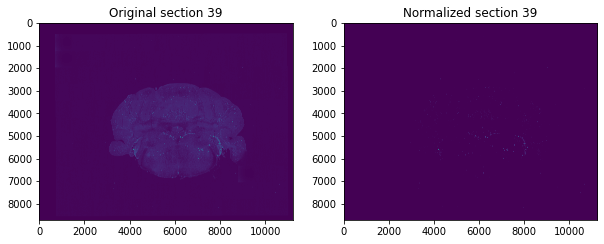

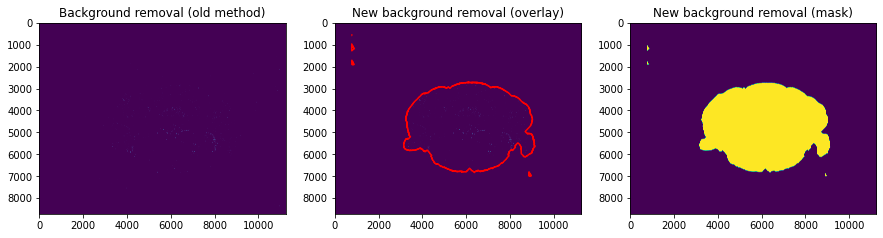

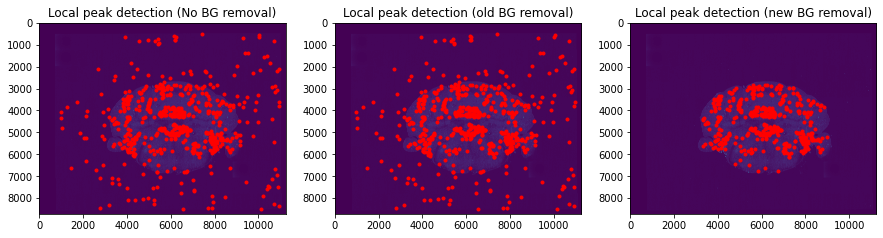

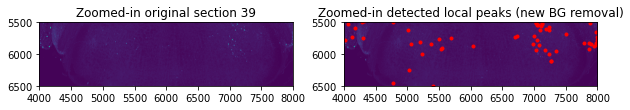

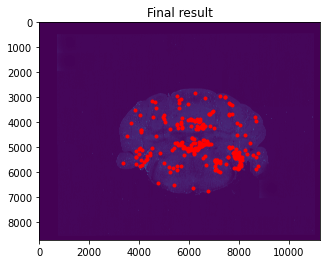

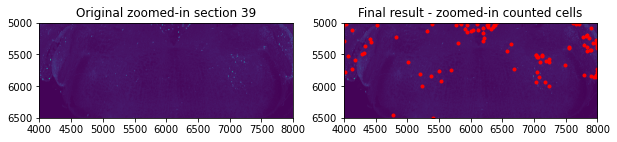

Number of detected cells: 237 


40 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0041_1_0.tif


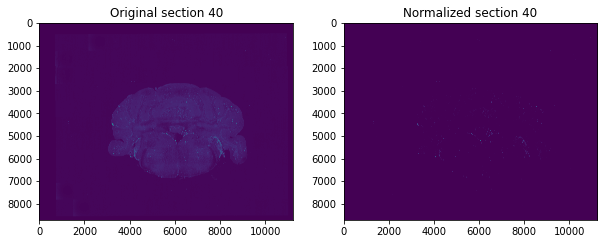

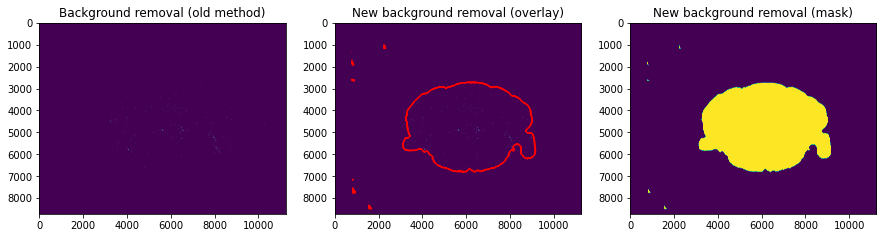

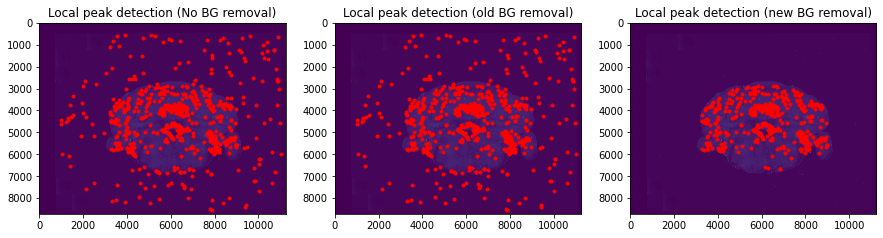

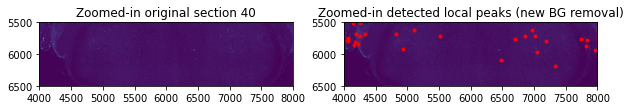

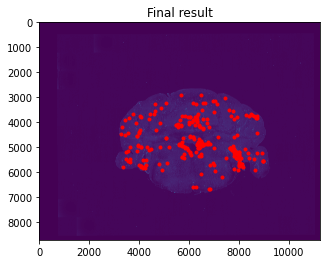

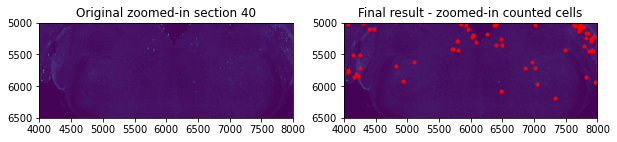

Number of detected cells: 244 


41 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0042_1_0.tif


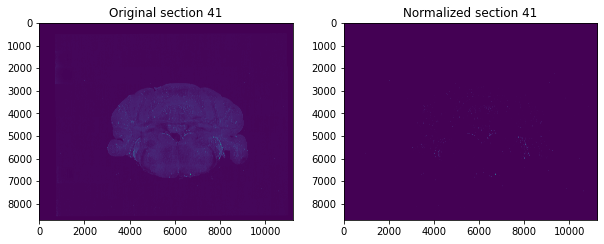

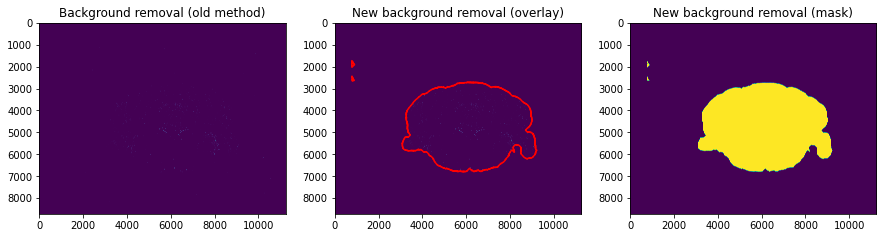

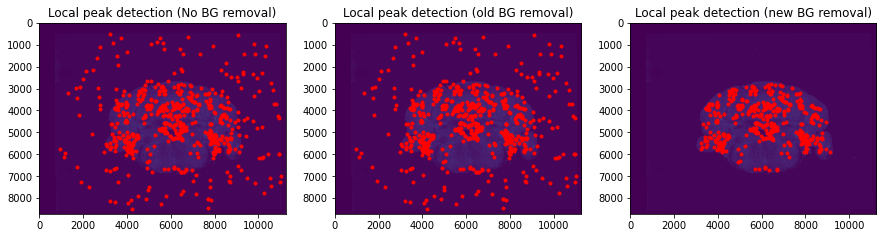

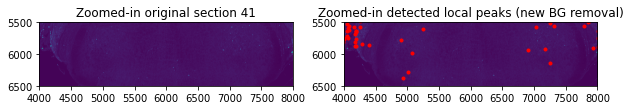

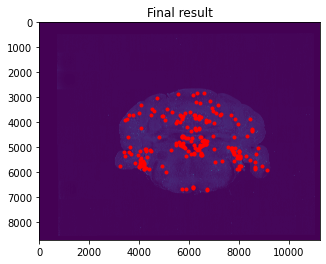

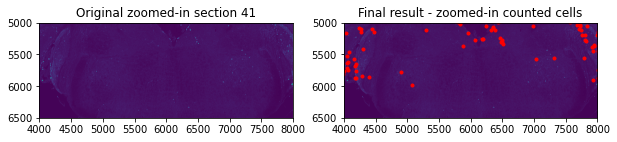

Number of detected cells: 209 


42 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0043_1_0.tif


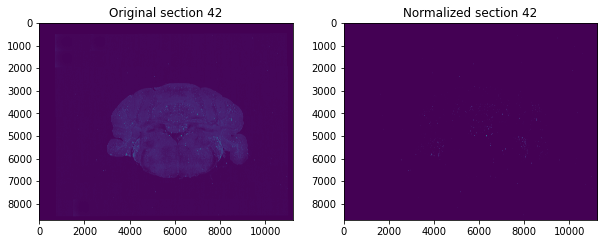

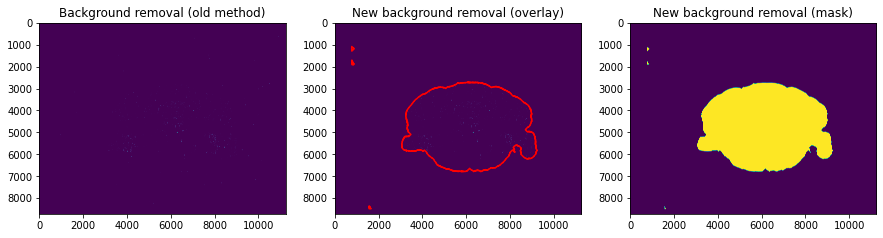

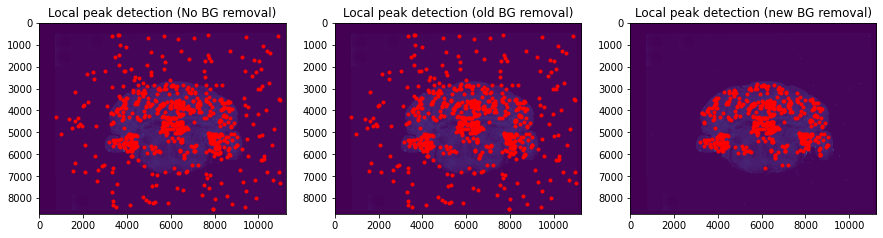

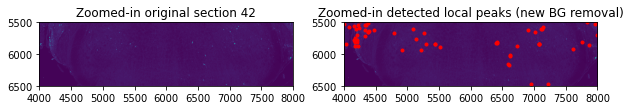

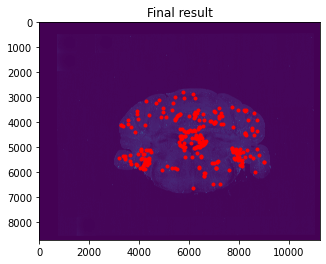

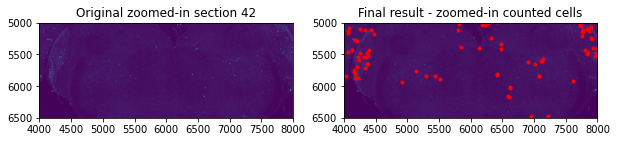

Number of detected cells: 249 


43 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0044_1_0.tif


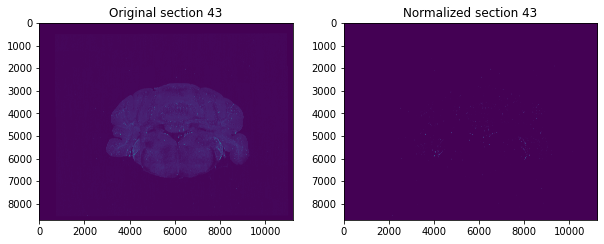

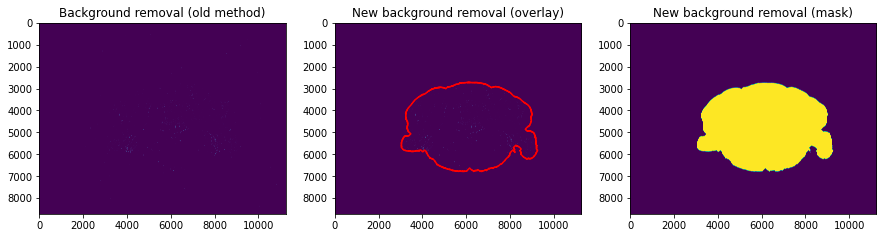

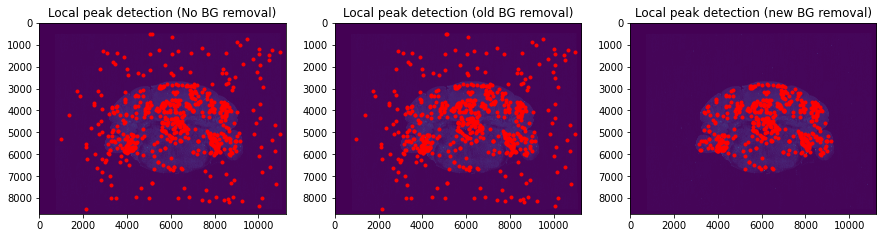

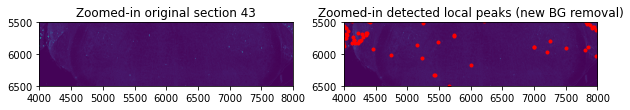

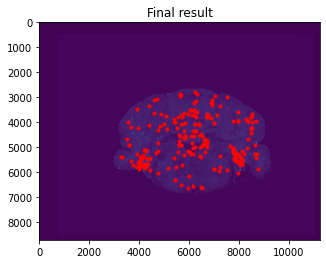

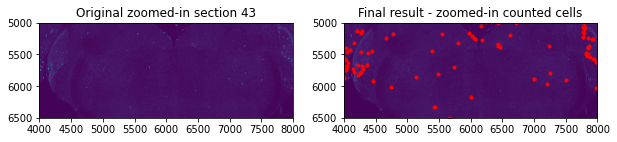

Number of detected cells: 232 


44 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0045_1_0.tif


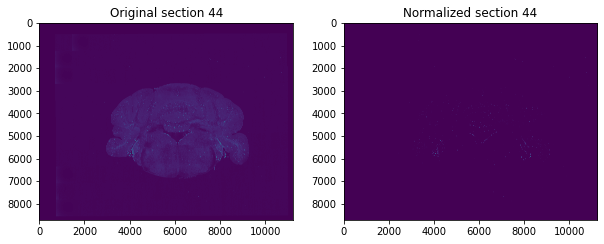

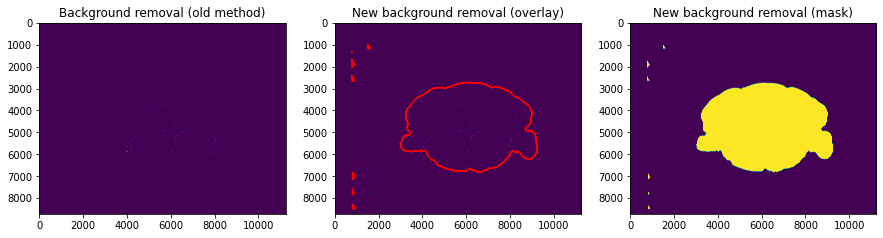

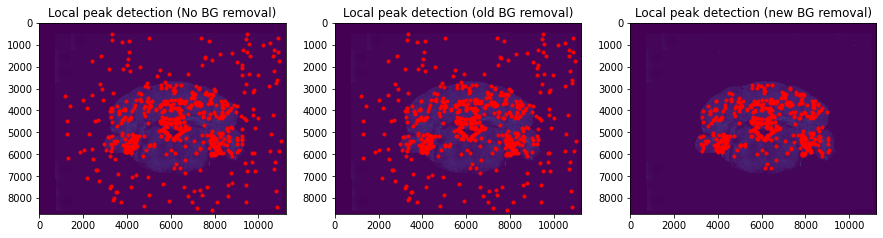

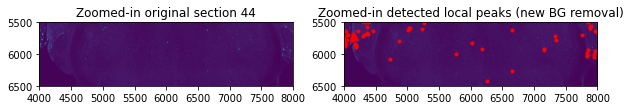

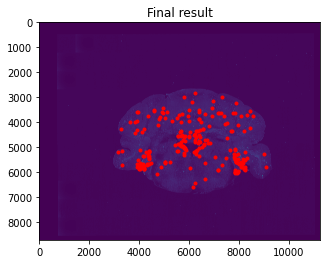

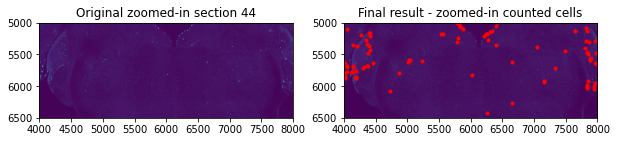

Number of detected cells: 228 


45 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0046_1_0.tif


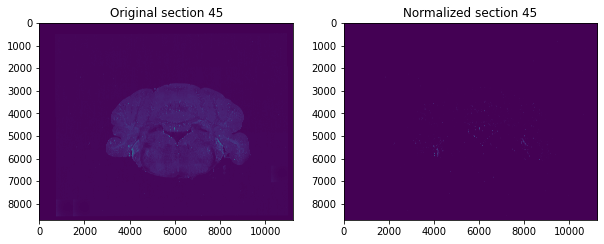

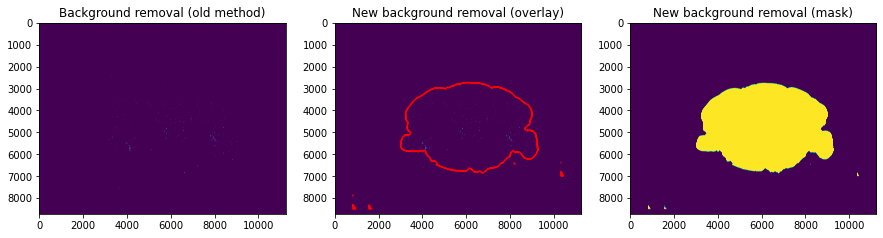

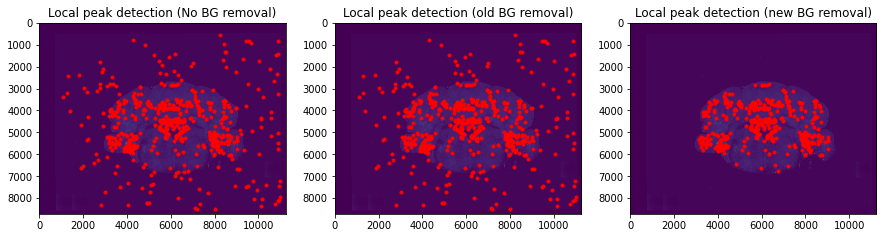

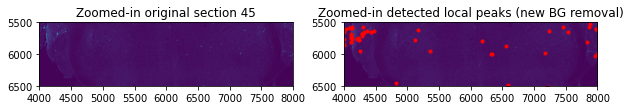

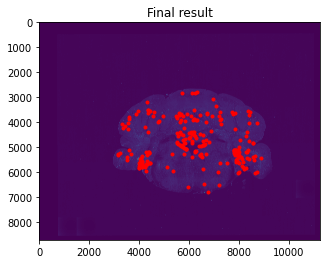

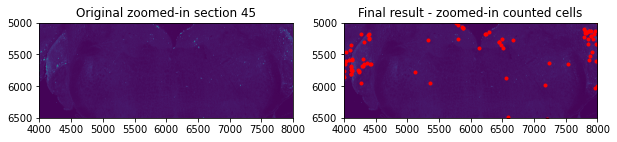

Number of detected cells: 231 


46 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0047_1_0.tif


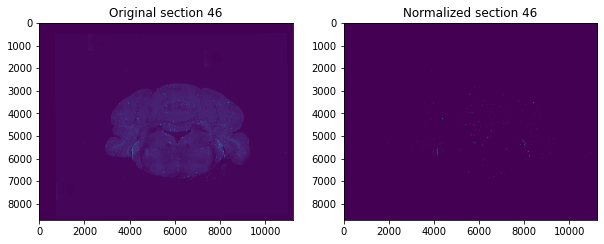

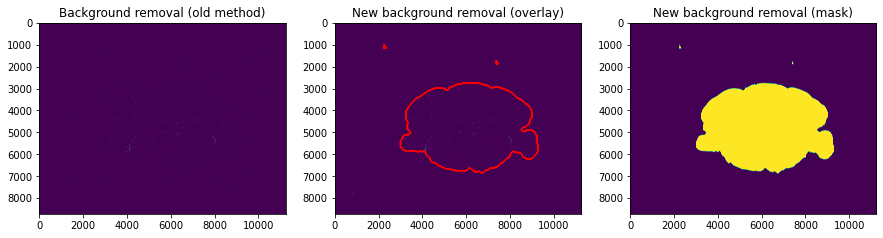

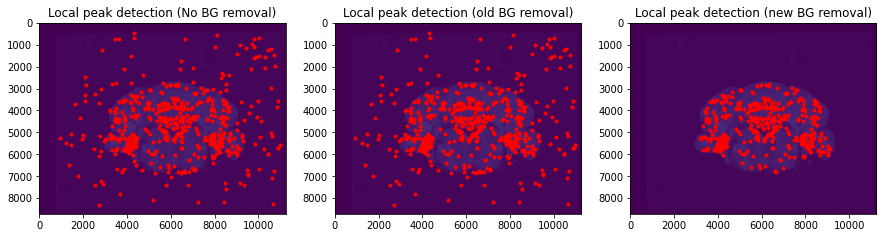

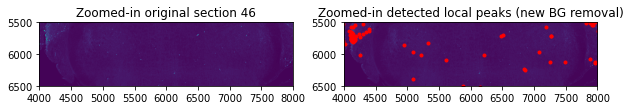

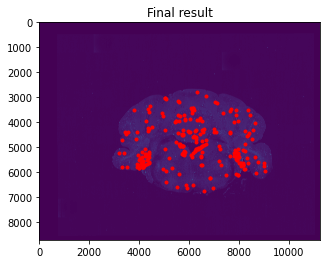

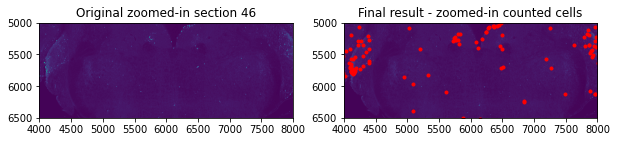

Number of detected cells: 244 


47 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0048_1_0.tif


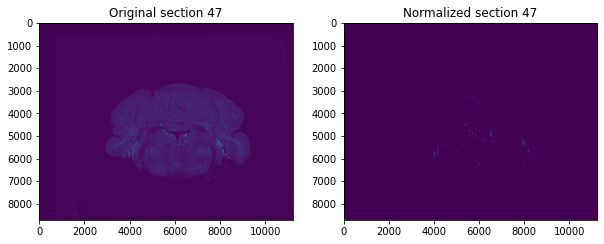

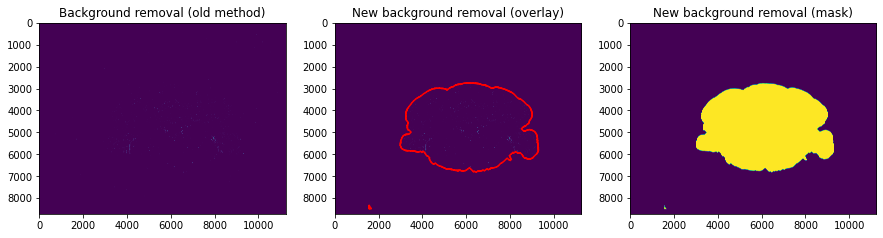

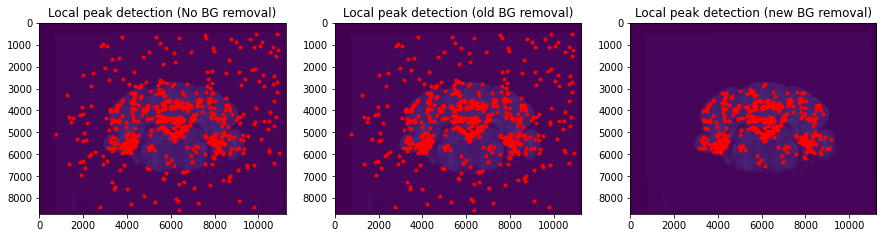

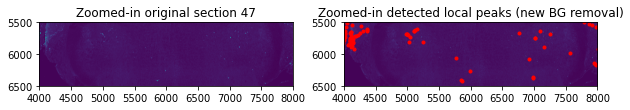

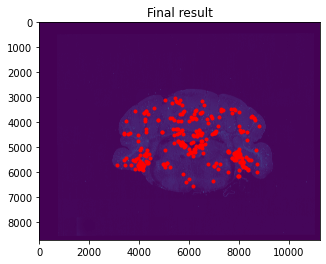

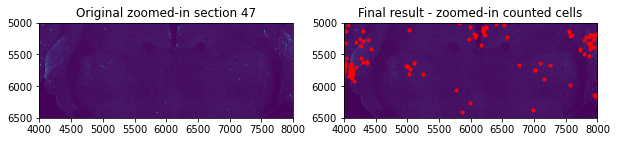

Number of detected cells: 300 


48 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0049_1_0.tif


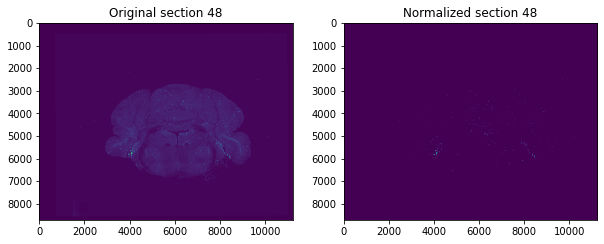

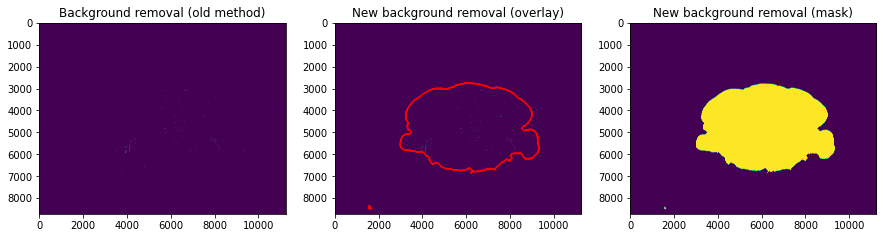

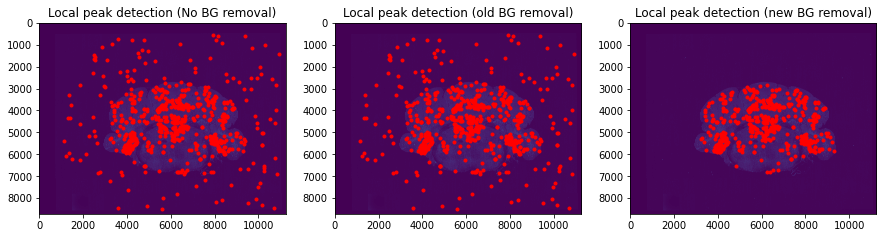

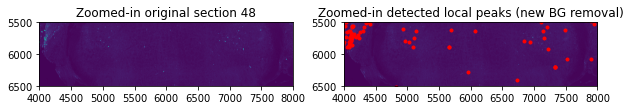

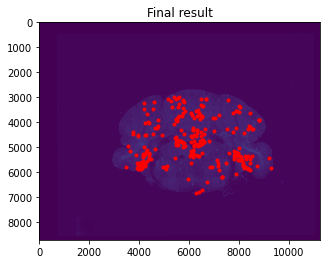

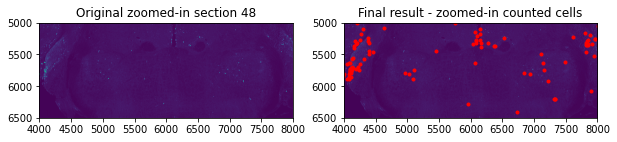

Number of detected cells: 272 


49 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0050_1_0.tif


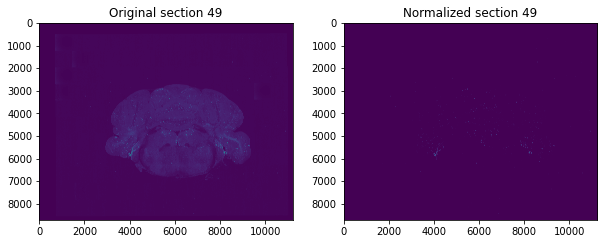

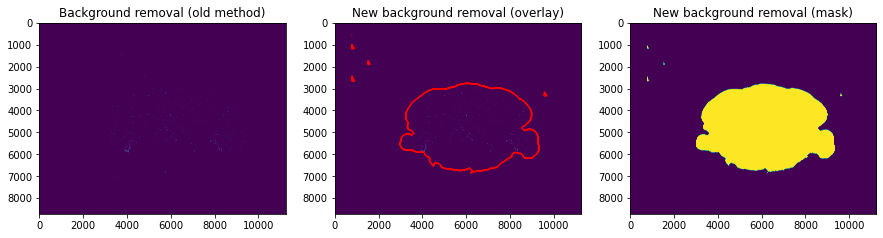

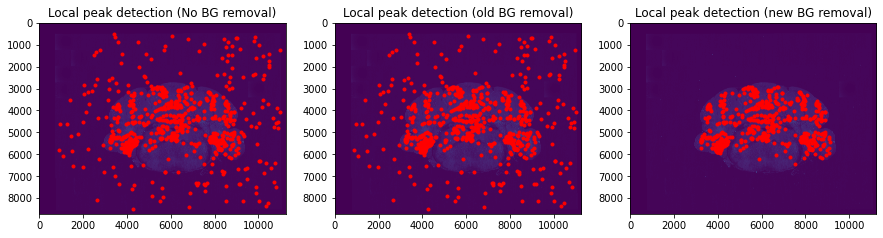

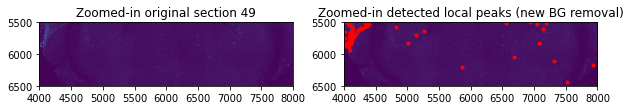

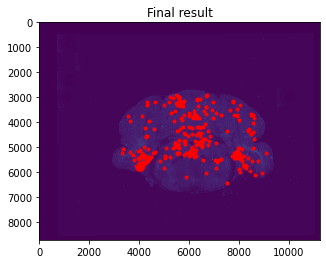

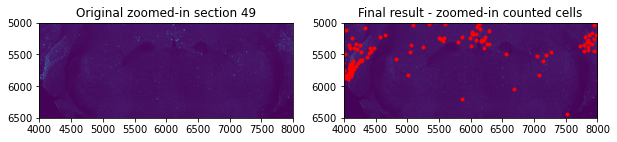

Number of detected cells: 299 


50 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0051_1_0.tif


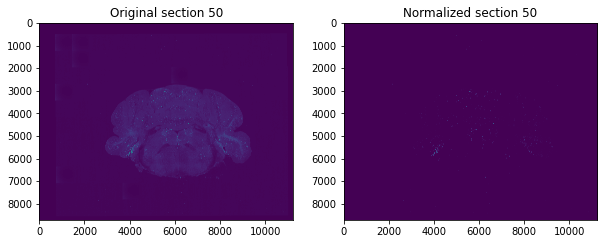

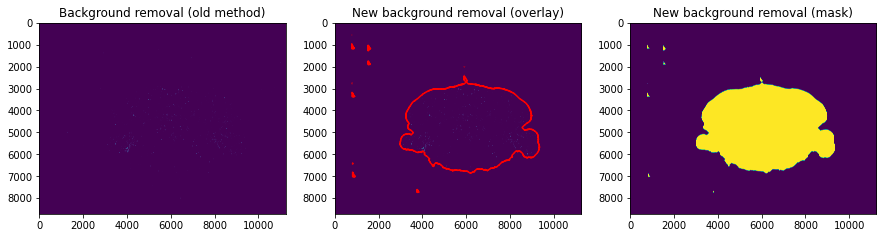

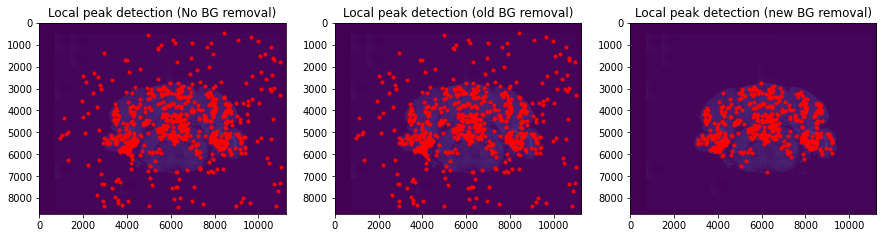

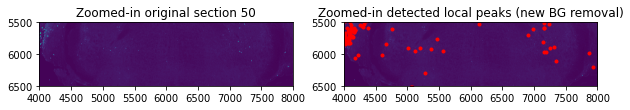

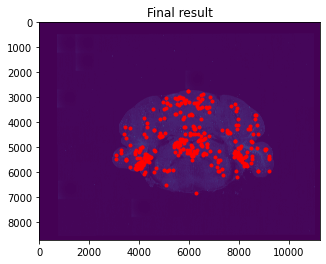

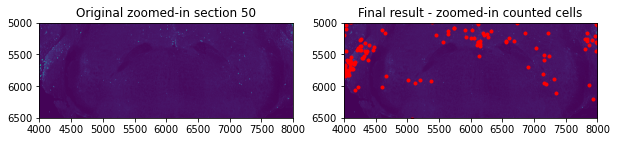

Number of detected cells: 341 


51 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0052_1_0.tif


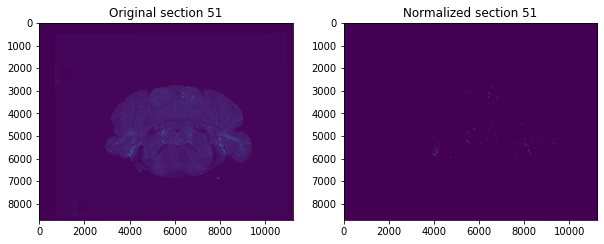

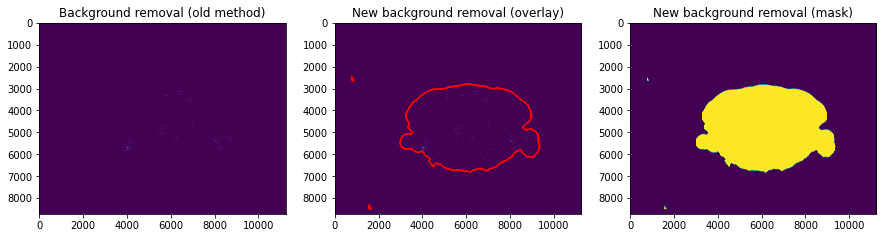

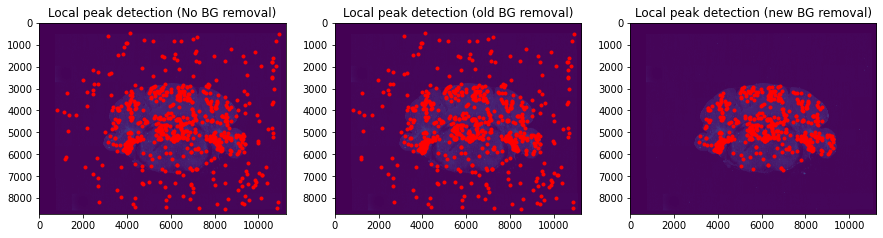

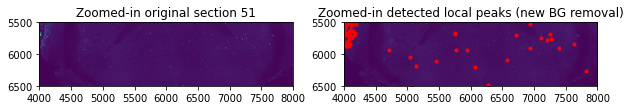

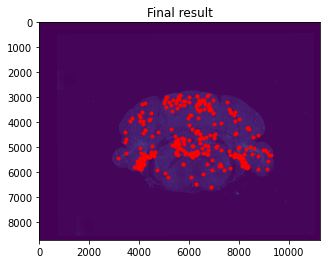

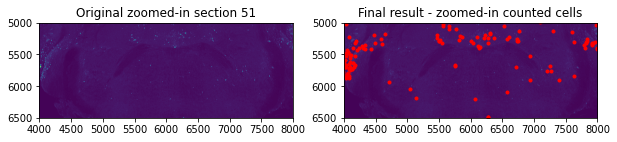

Number of detected cells: 320 


52 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0053_1_0.tif


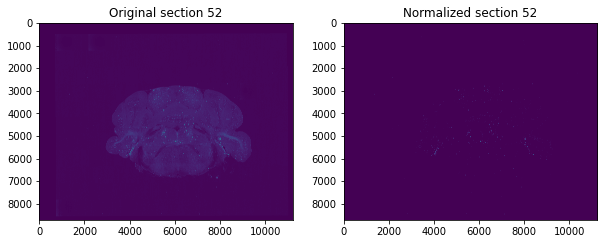

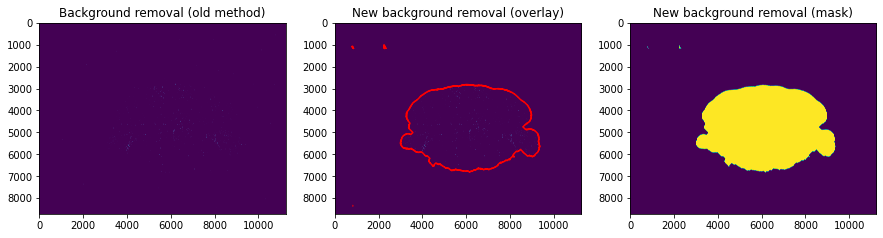

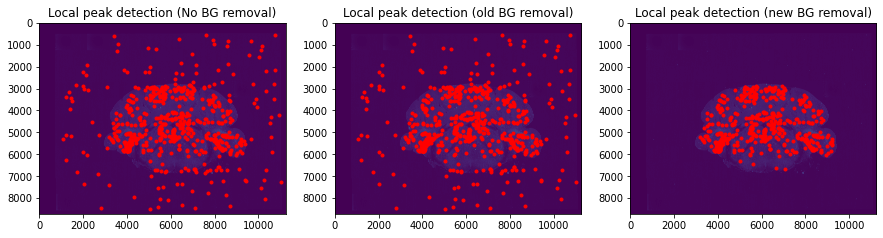

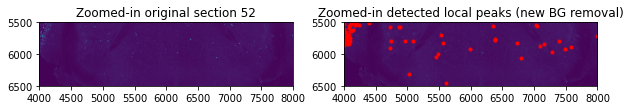

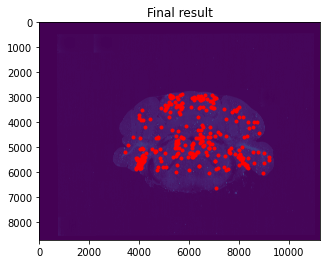

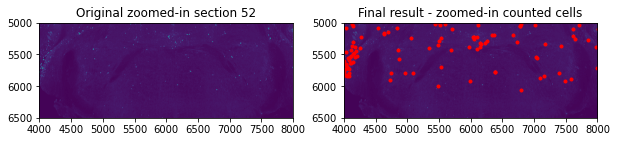

Number of detected cells: 298 


53 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0054_1_0.tif


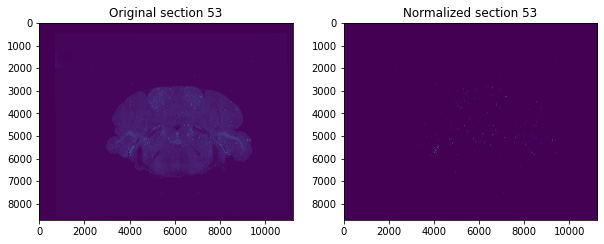

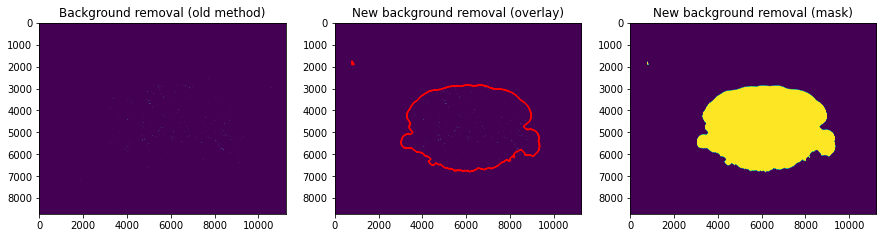

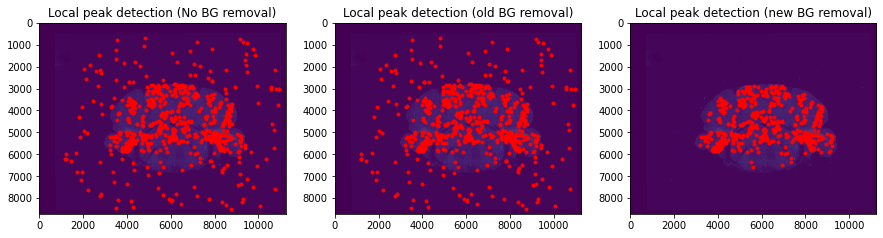

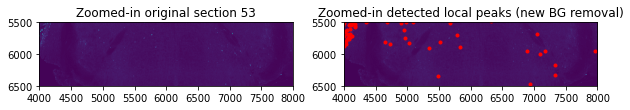

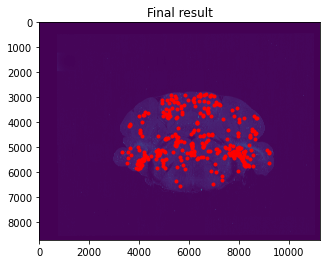

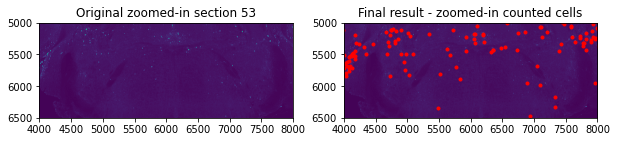

Number of detected cells: 329 


54 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0055_1_0.tif


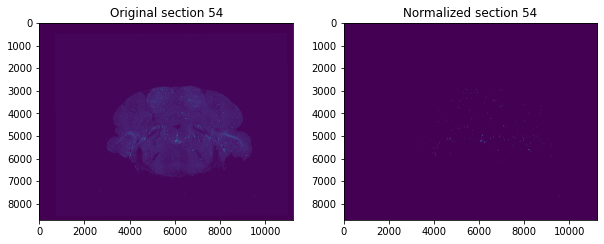

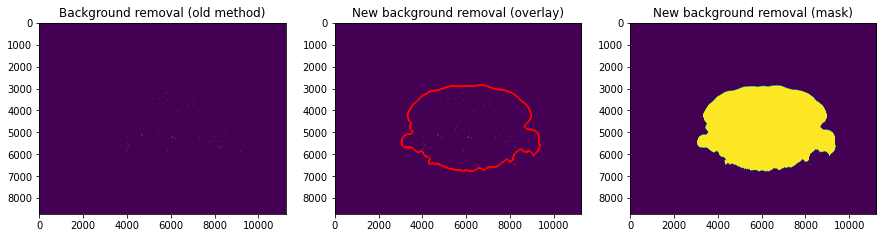

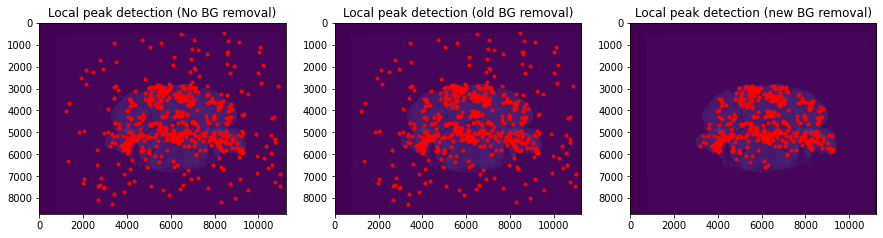

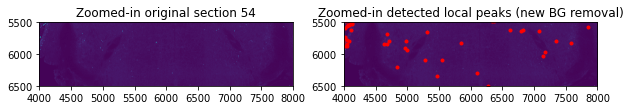

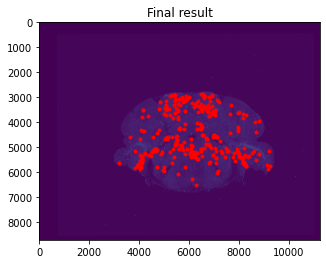

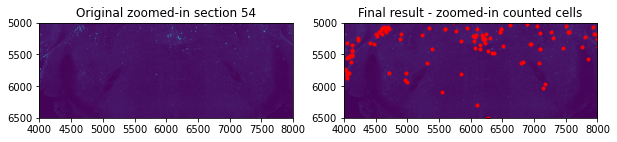

Number of detected cells: 299 


55 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0056_1_0.tif


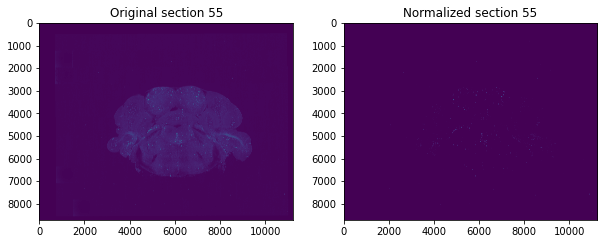

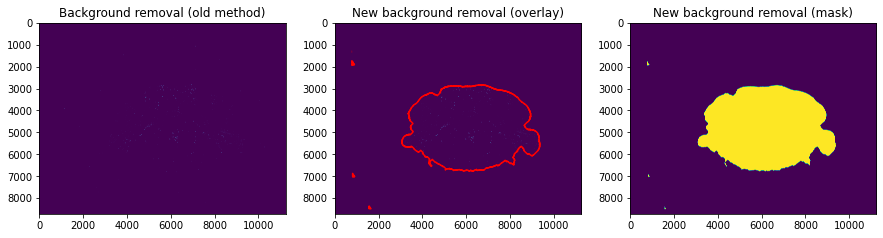

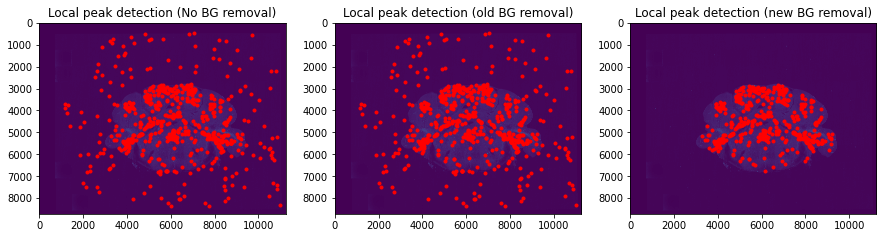

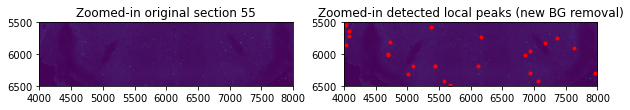

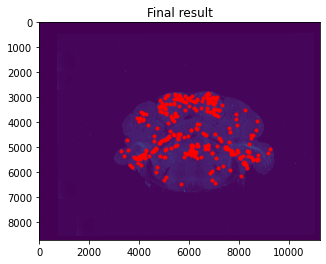

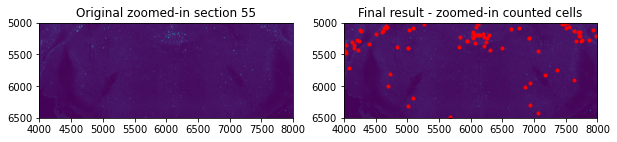

Number of detected cells: 299 


56 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0057_1_0.tif


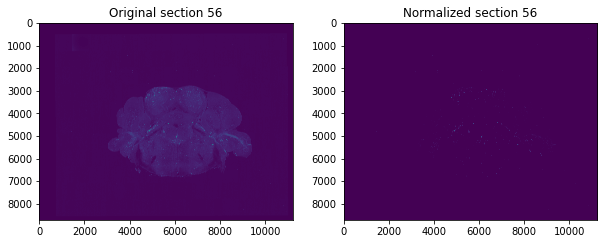

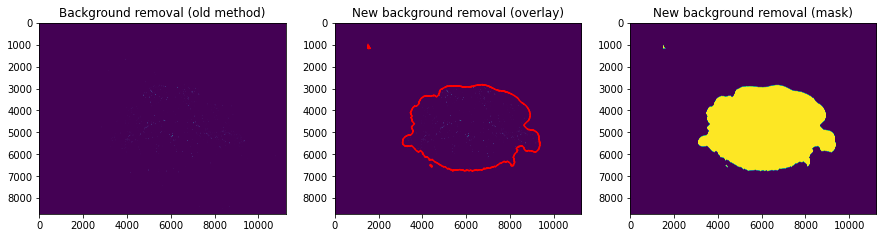

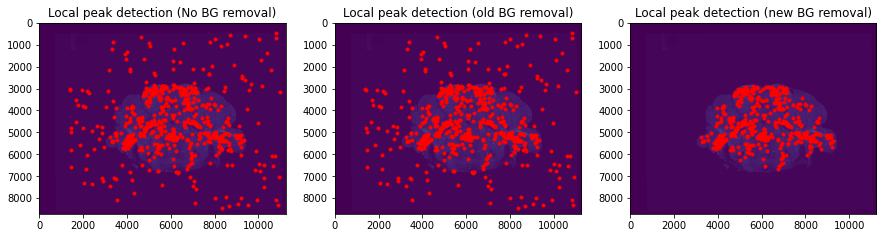

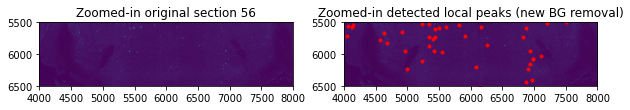

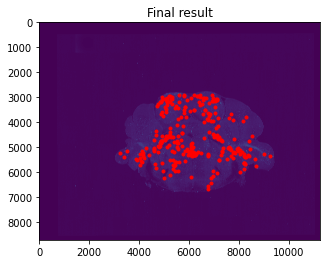

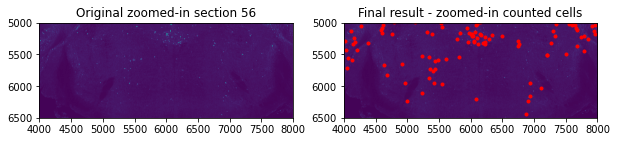

Number of detected cells: 278 


57 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0058_1_0.tif


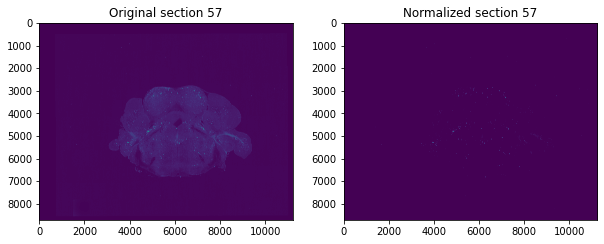

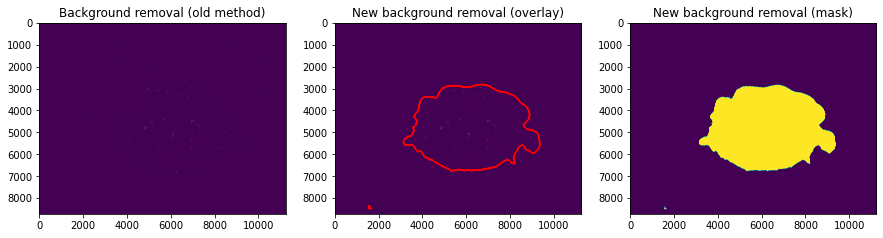

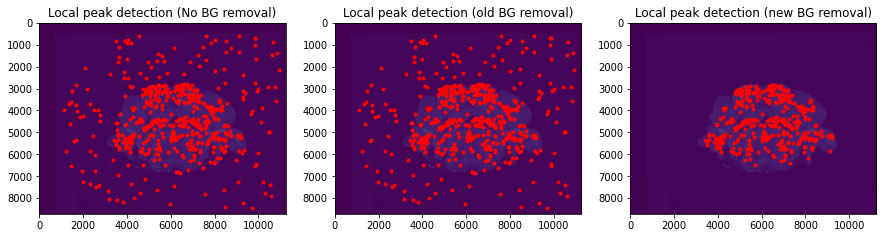

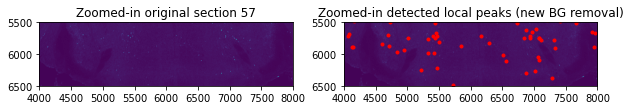

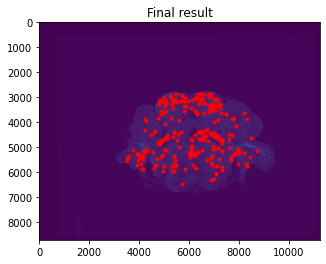

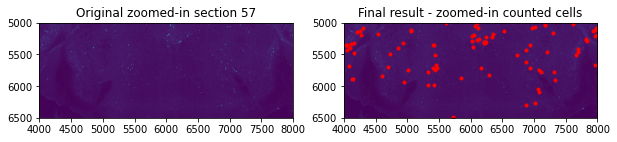

Number of detected cells: 280 


58 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0059_1_0.tif


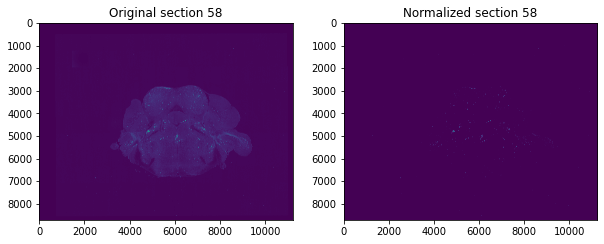

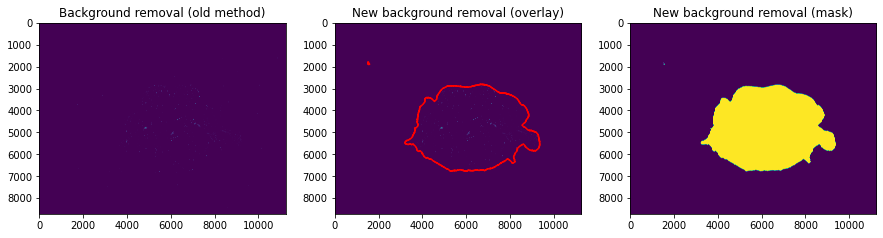

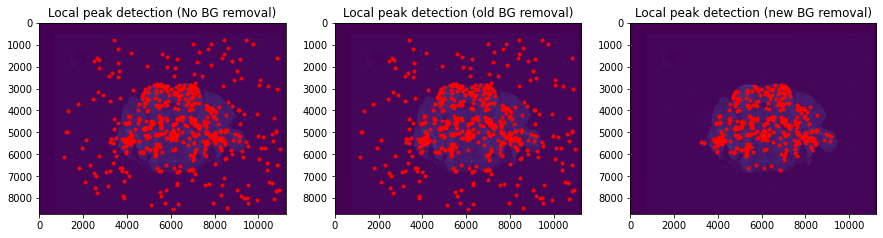

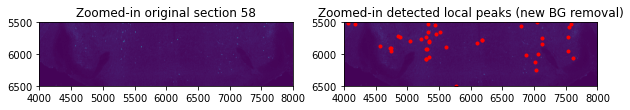

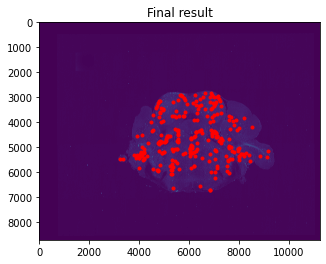

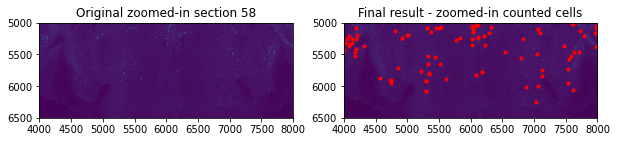

Number of detected cells: 283 


59 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0060_1_0.tif


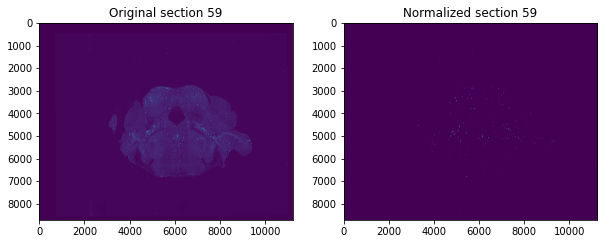

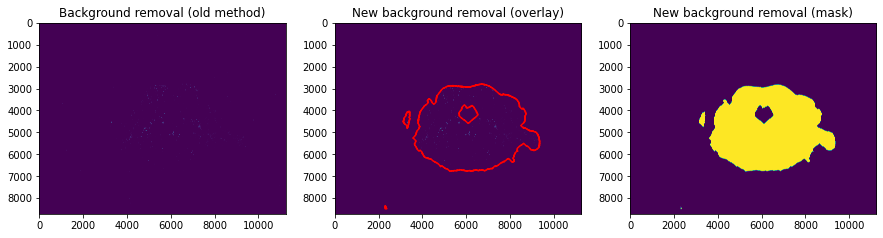

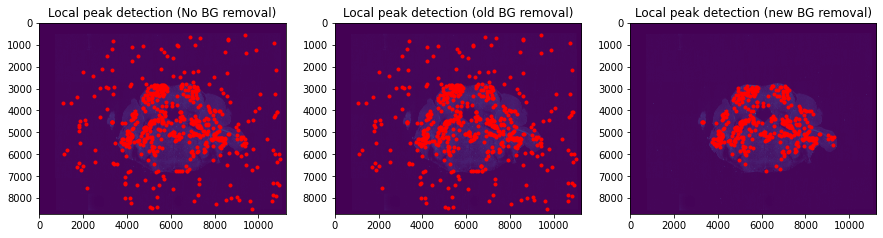

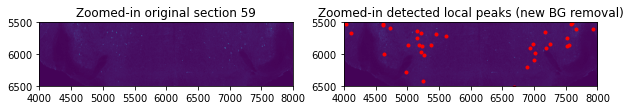

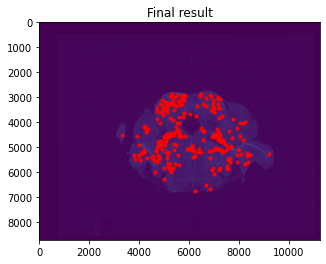

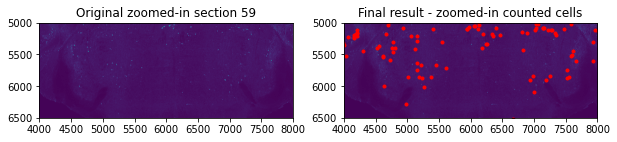

Number of detected cells: 283 


60 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0061_1_0.tif


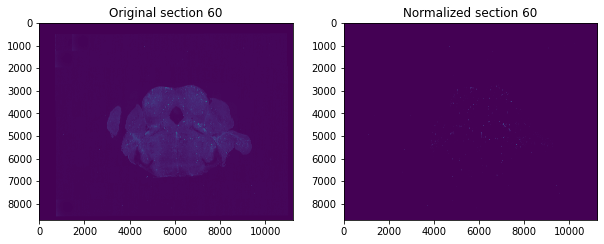

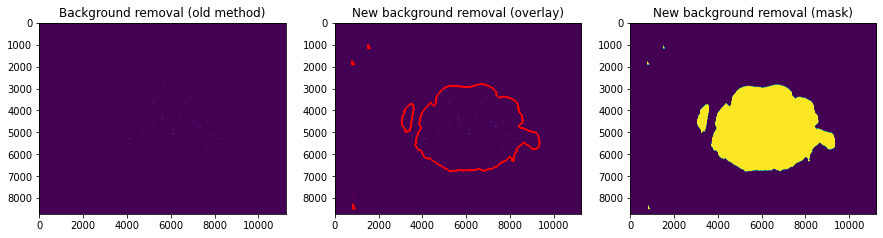

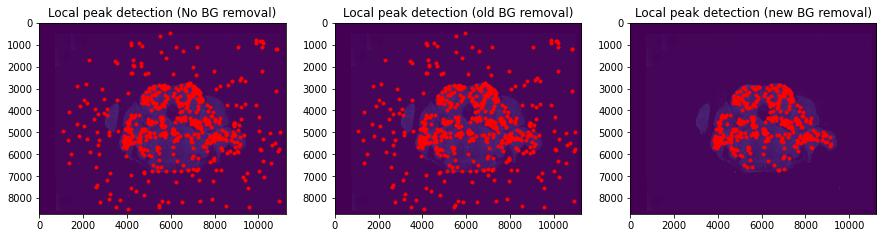

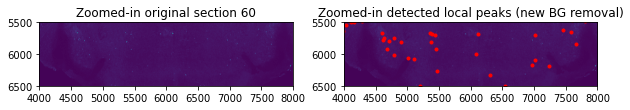

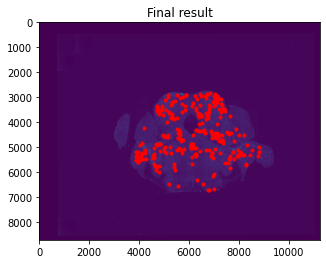

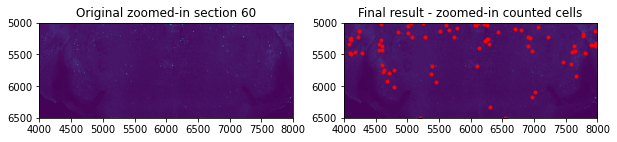

Number of detected cells: 276 


61 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0062_1_0.tif


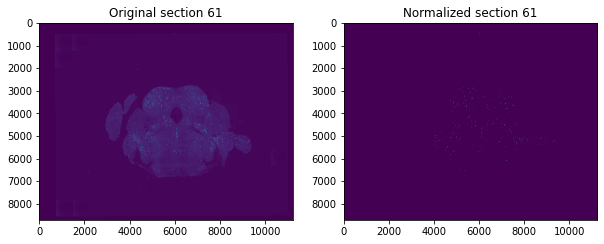

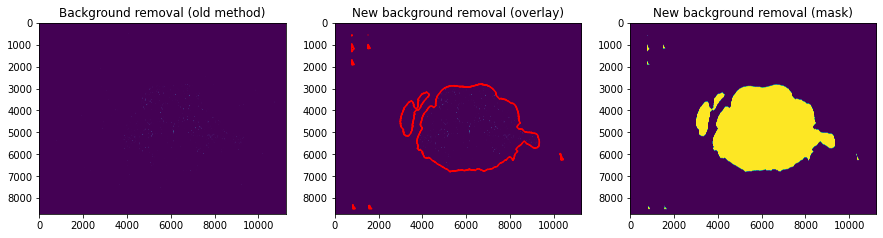

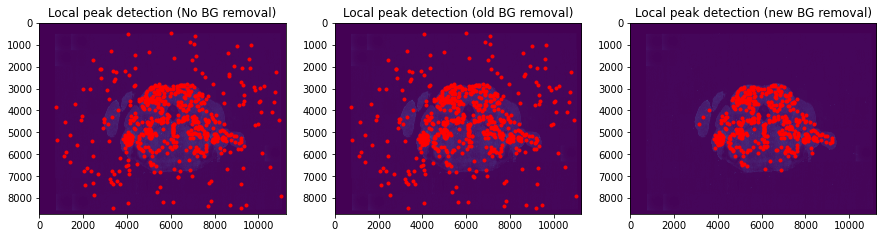

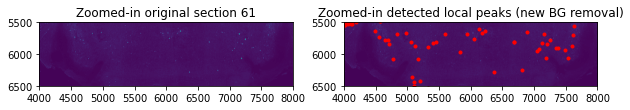

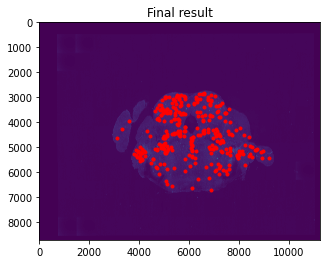

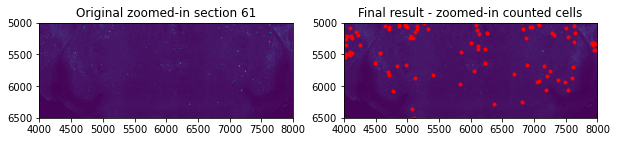

Number of detected cells: 314 


62 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0063_1_0.tif


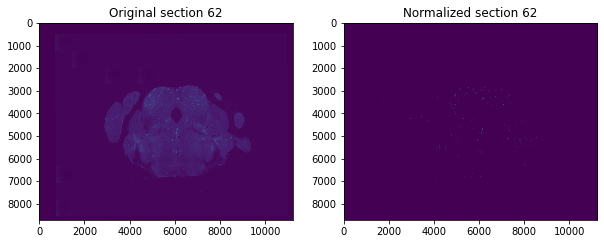

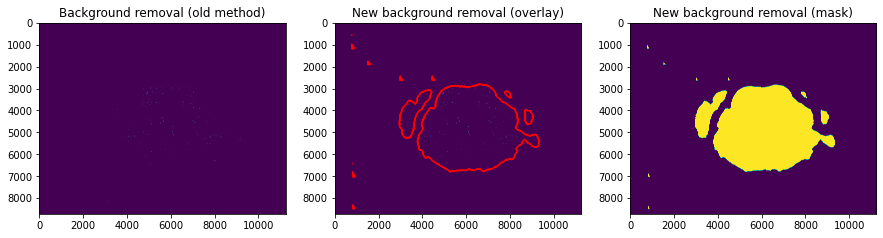

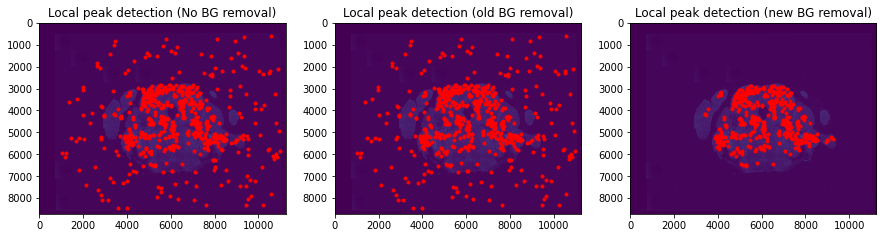

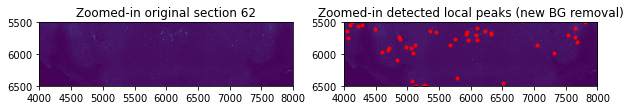

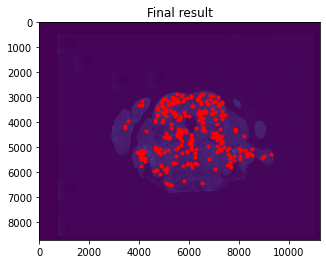

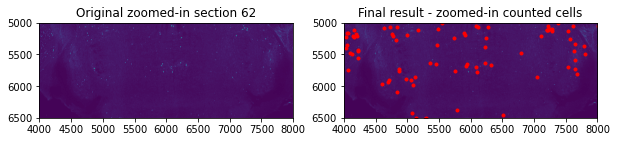

Number of detected cells: 301 


63 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0064_1_0.tif


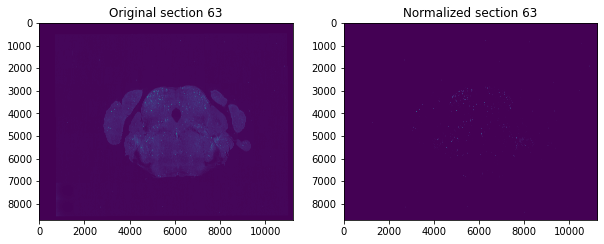

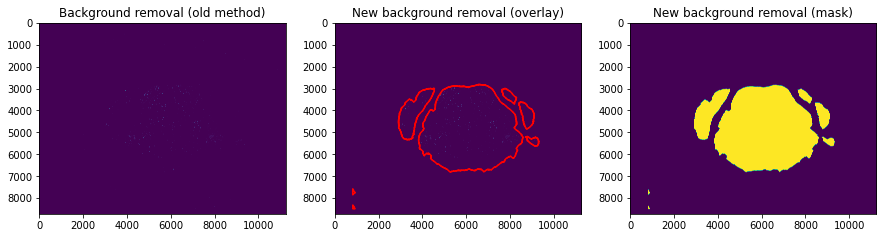

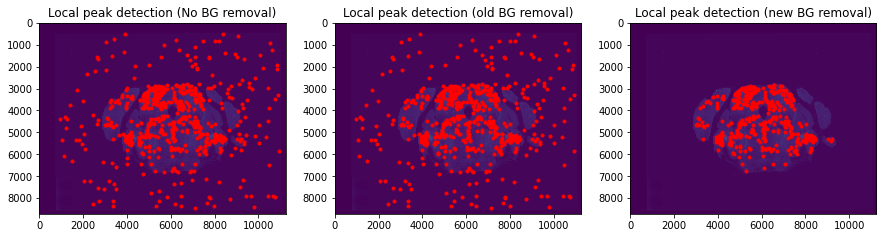

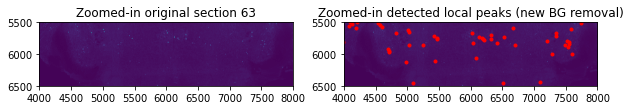

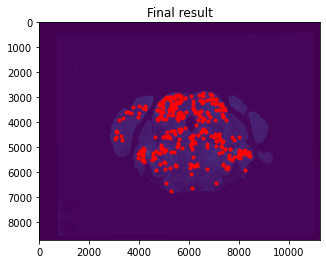

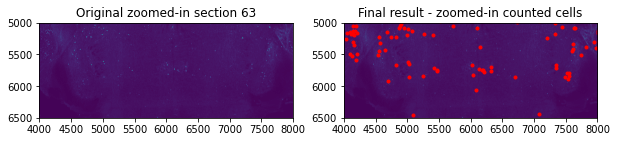

Number of detected cells: 331 


64 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0065_1_0.tif


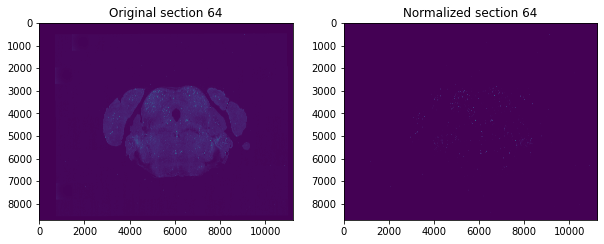

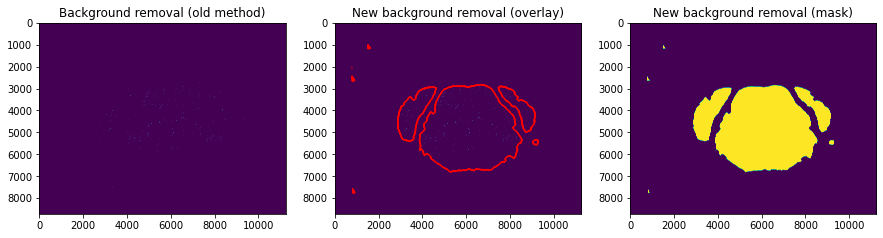

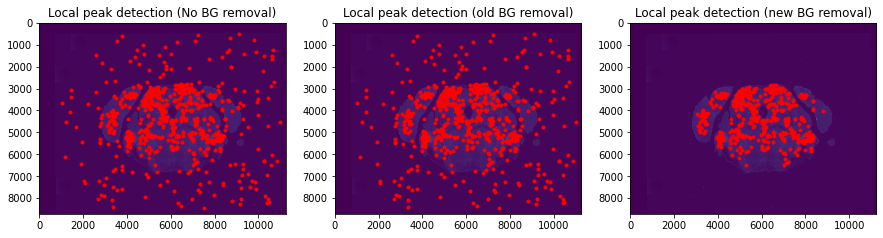

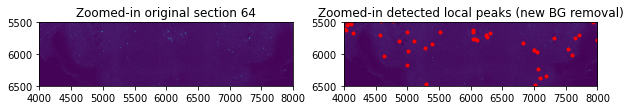

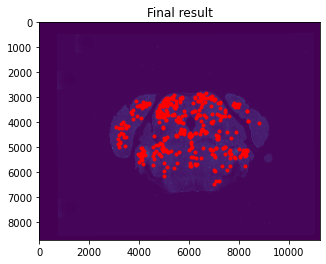

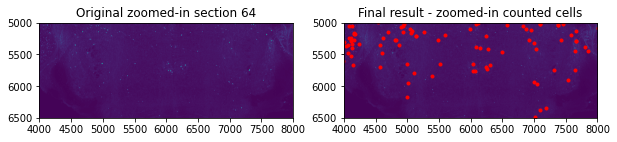

Number of detected cells: 355 


65 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0066_1_0.tif


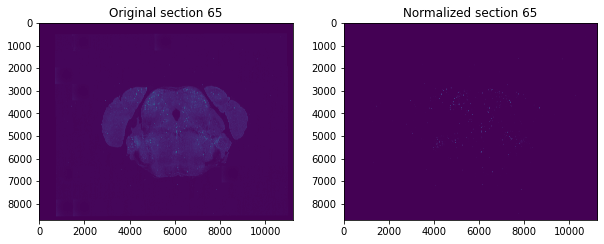

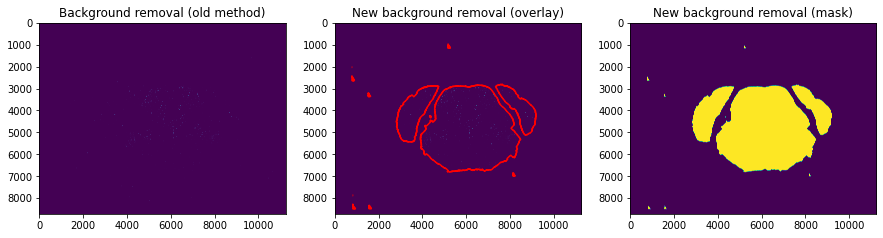

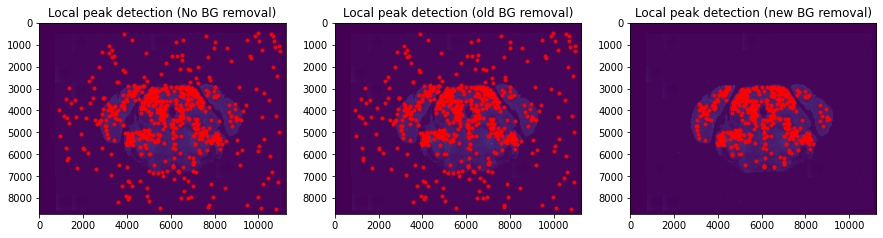

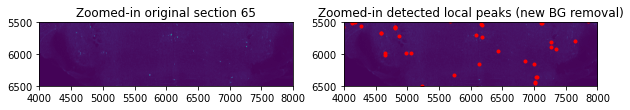

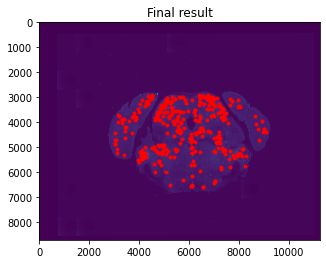

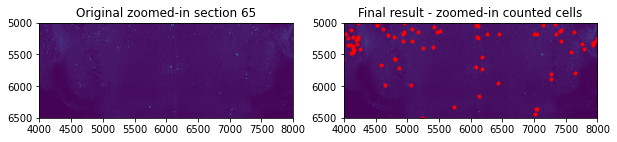

Number of detected cells: 339 


66 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0067_1_0.tif


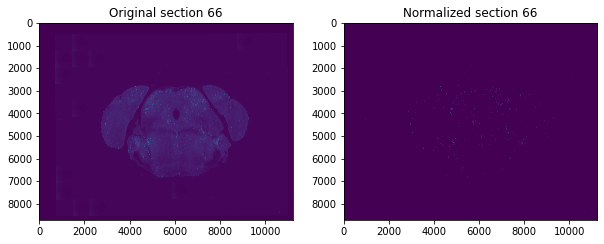

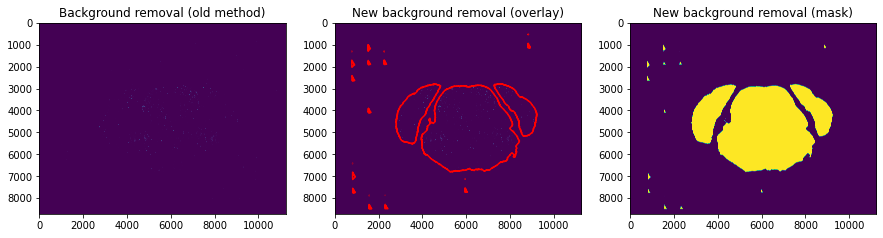

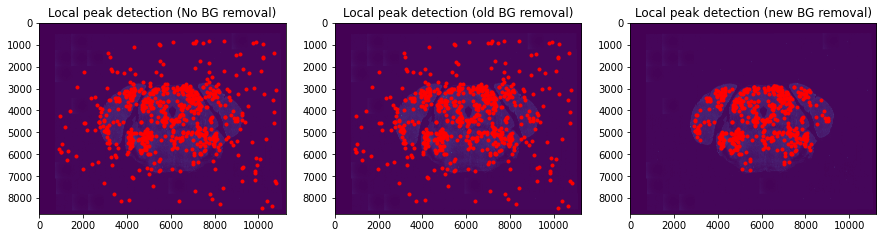

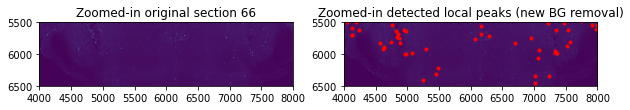

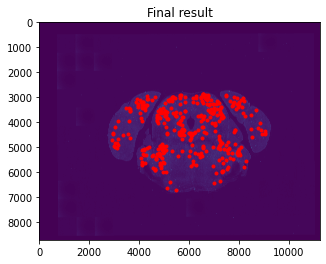

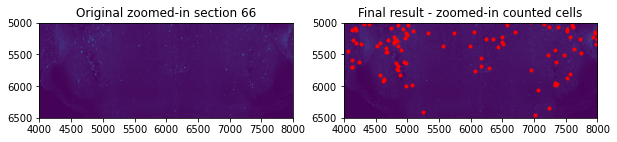

Number of detected cells: 371 


67 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0068_1_0.tif


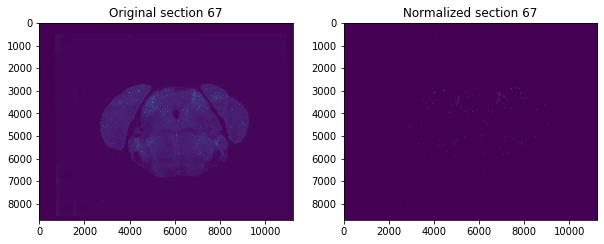

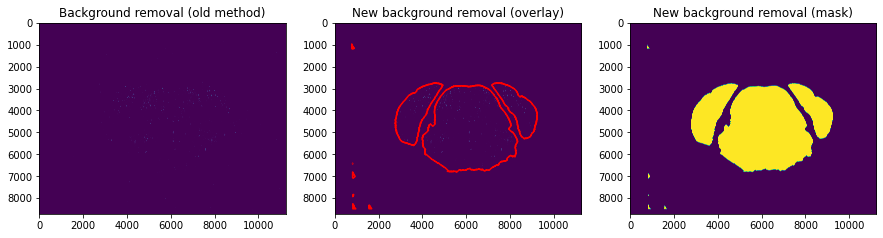

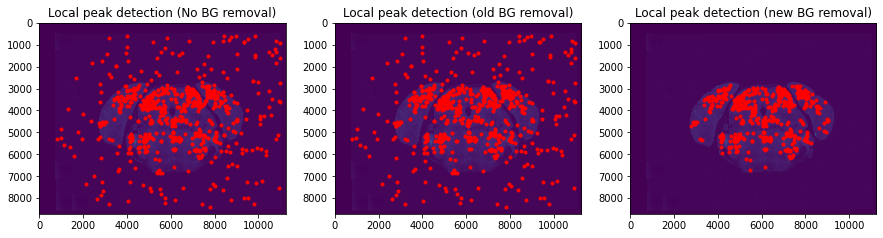

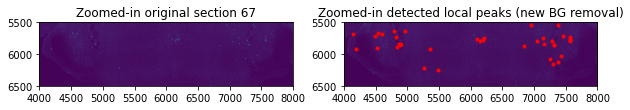

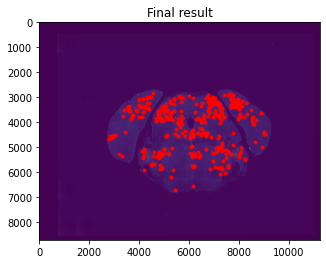

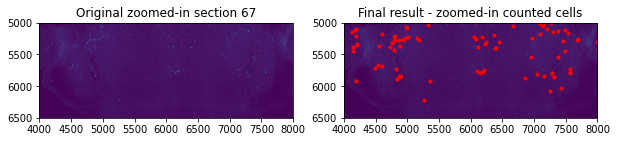

Number of detected cells: 371 


68 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0069_1_0.tif


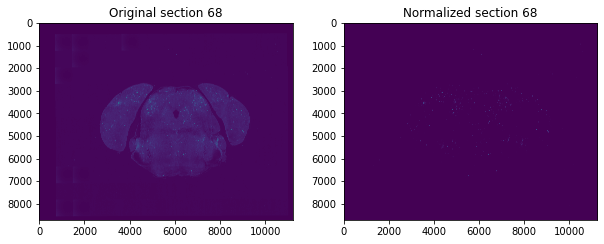

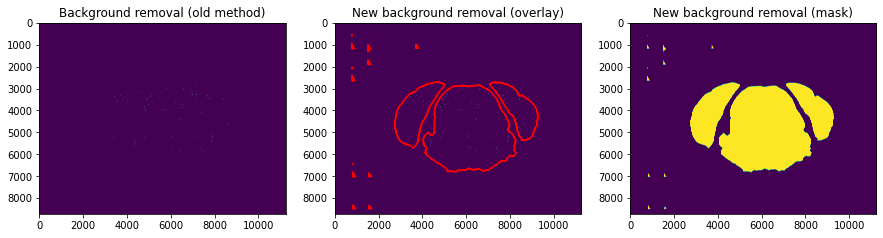

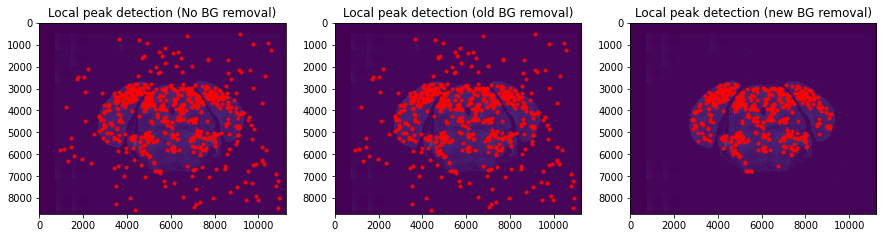

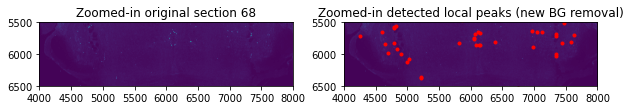

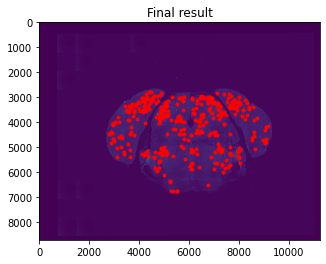

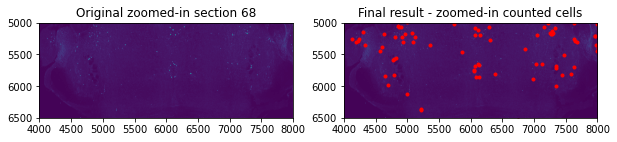

Number of detected cells: 364 


69 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0070_1_0.tif


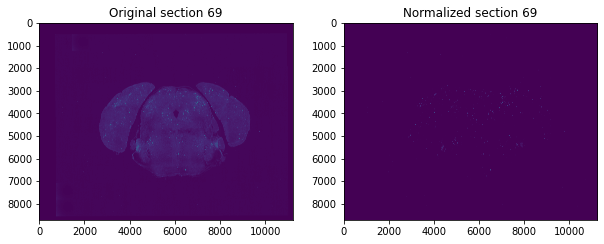

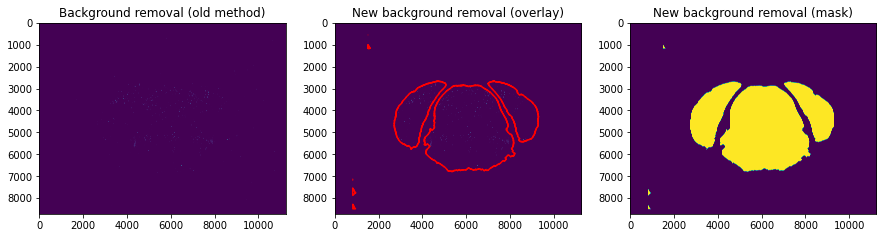

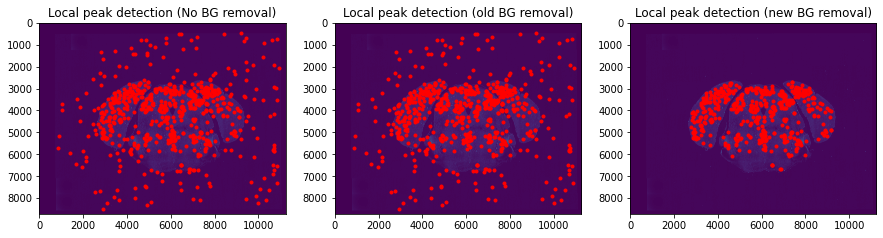

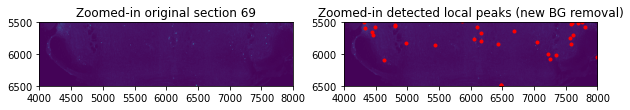

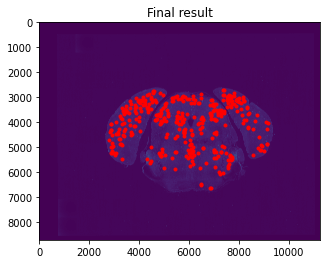

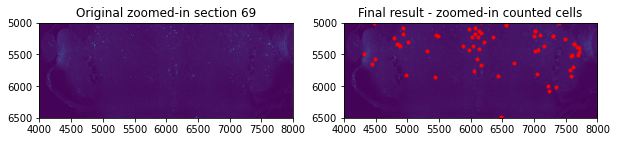

Number of detected cells: 379 


70 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0071_1_0.tif


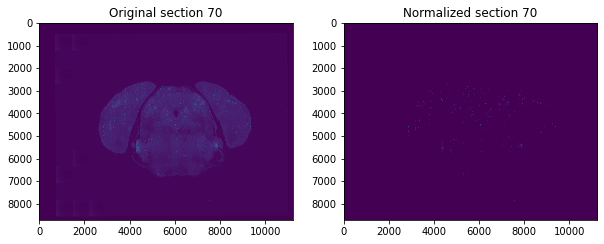

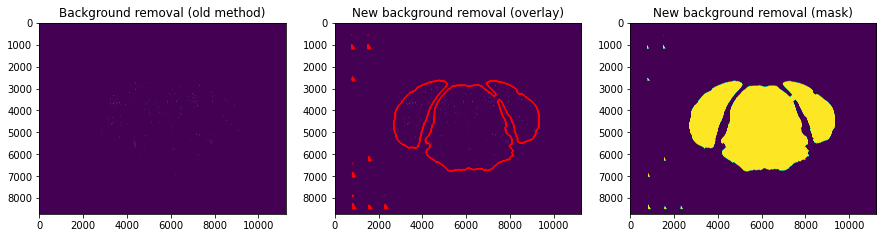

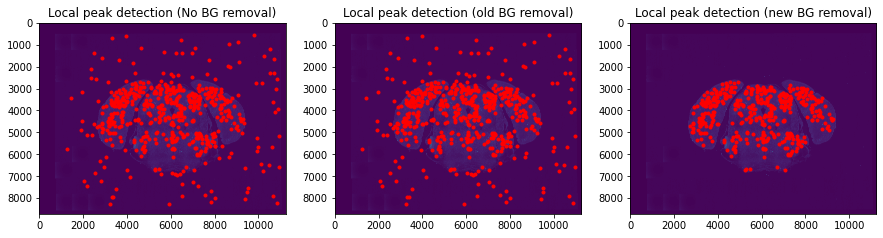

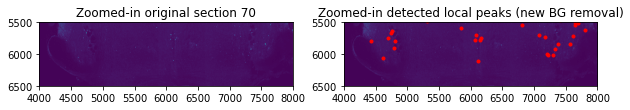

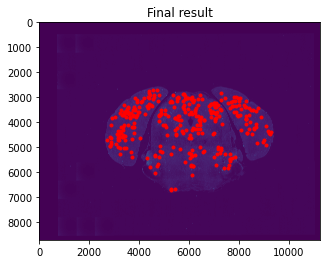

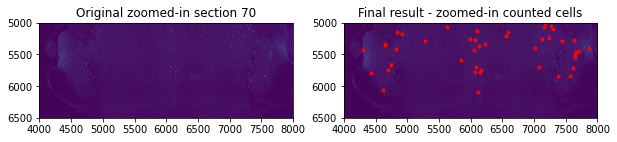

Number of detected cells: 333 


71 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0072_1_0.tif


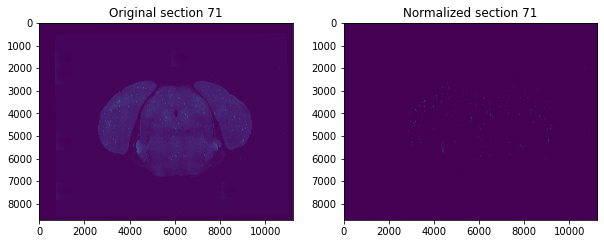

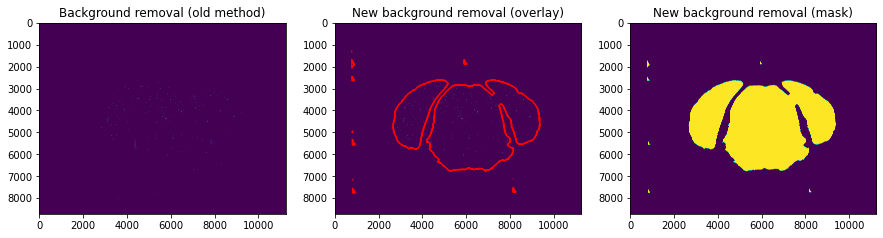

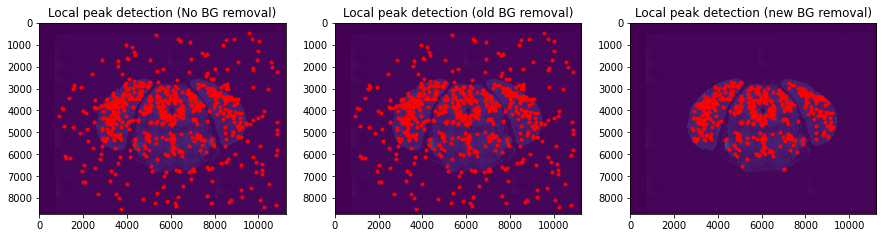

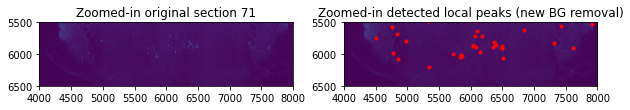

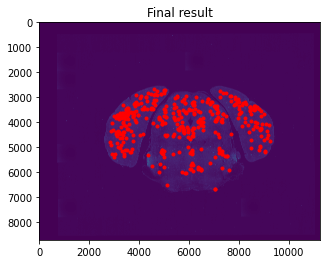

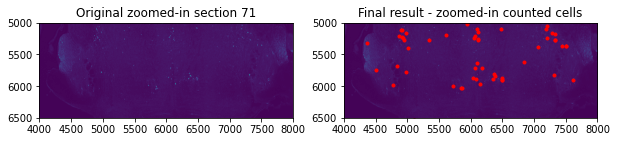

Number of detected cells: 393 


72 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0073_1_0.tif


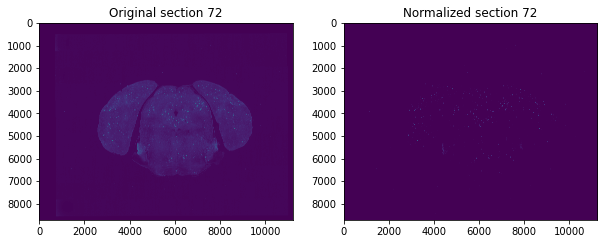

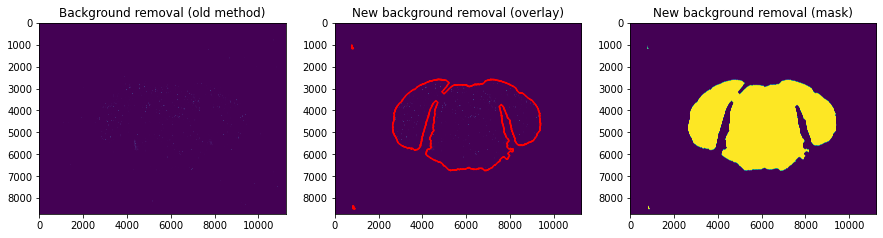

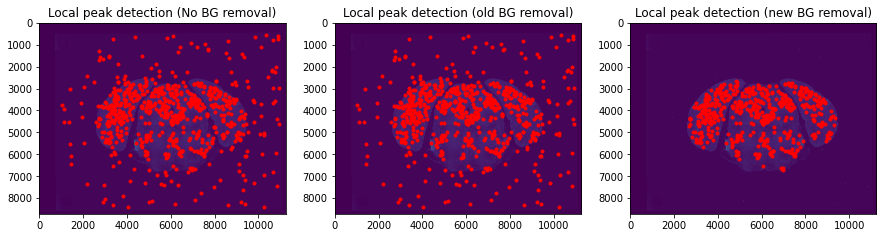

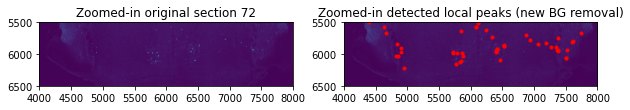

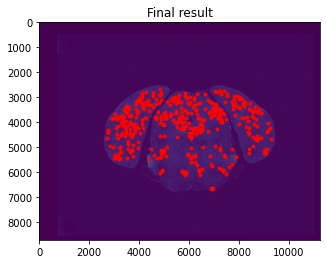

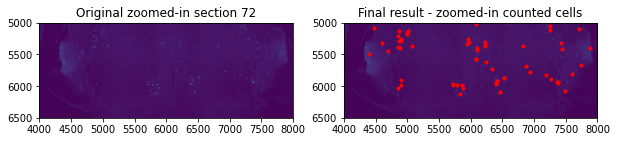

Number of detected cells: 435 


73 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0074_1_0.tif


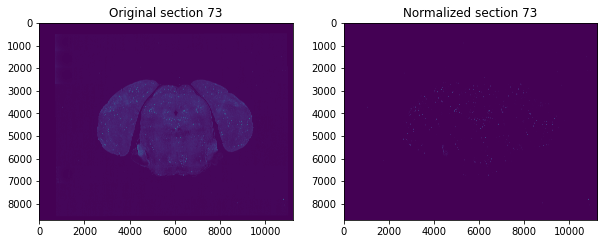

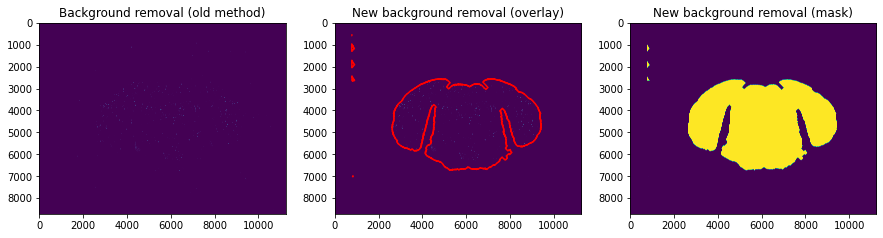

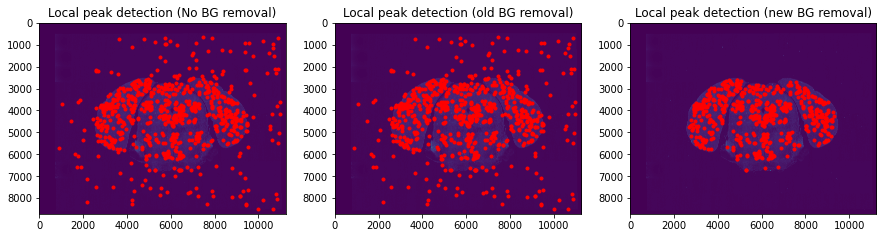

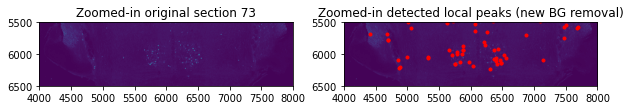

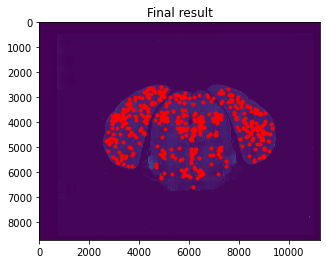

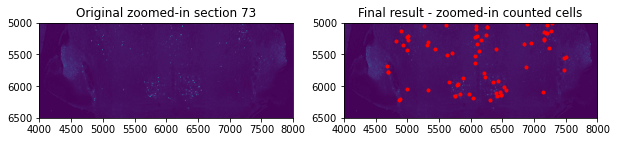

Number of detected cells: 500 


74 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0075_1_0.tif


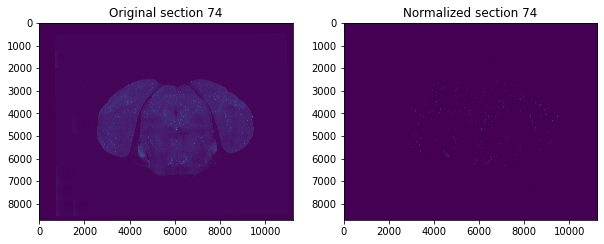

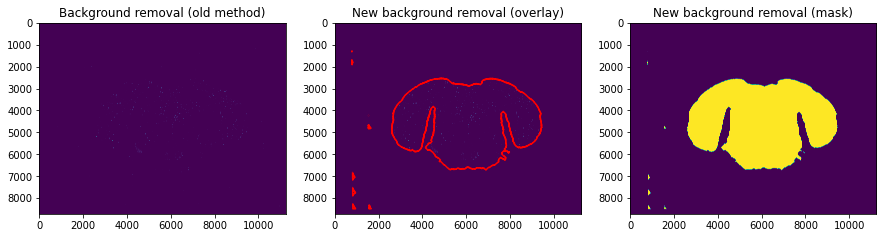

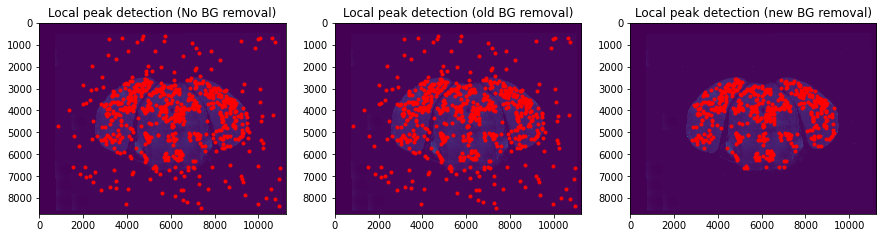

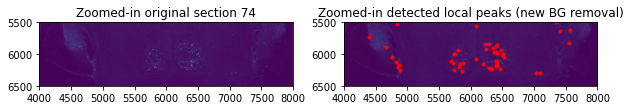

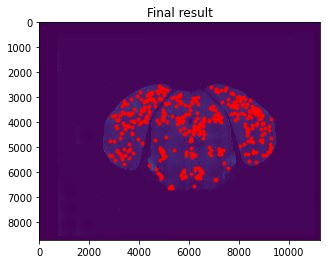

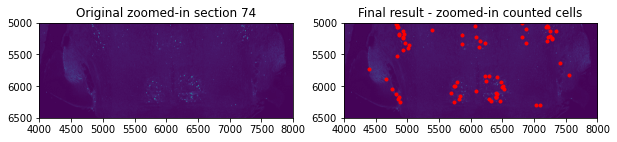

Number of detected cells: 422 


75 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0076_1_0.tif


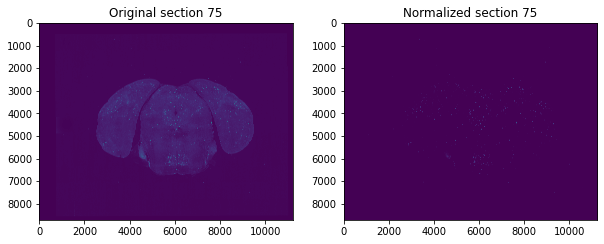

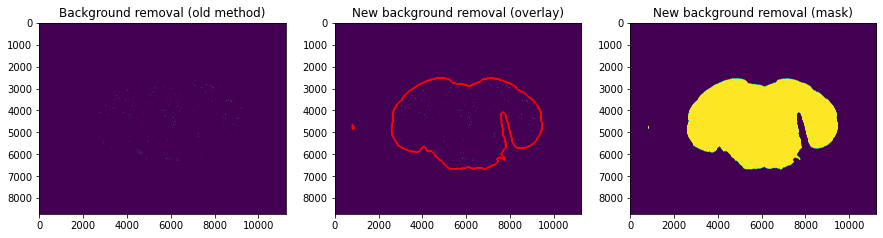

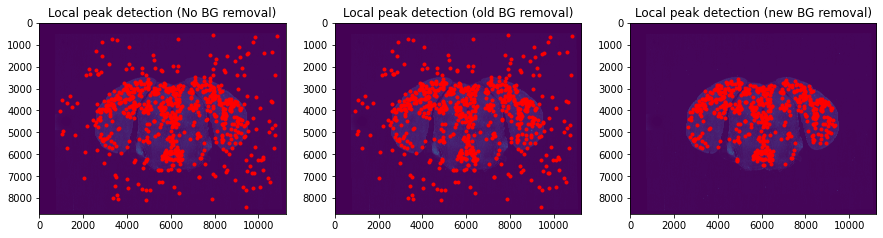

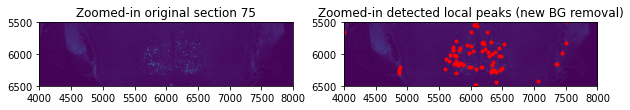

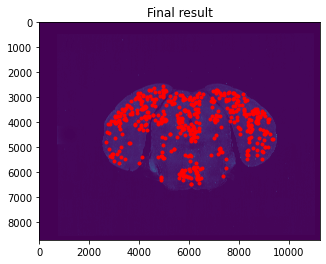

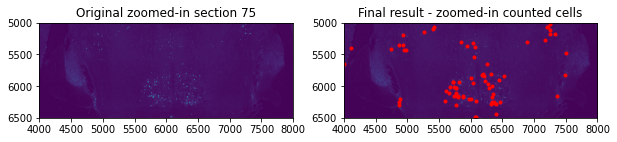

Number of detected cells: 491 


76 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0077_1_0.tif


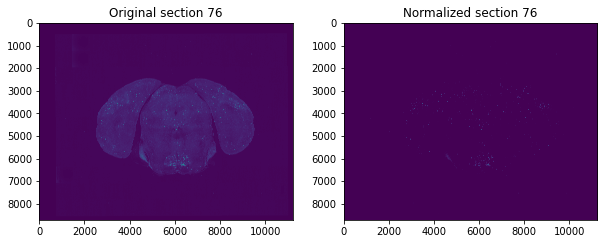

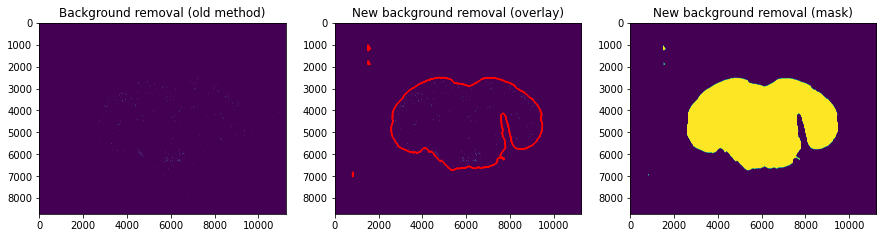

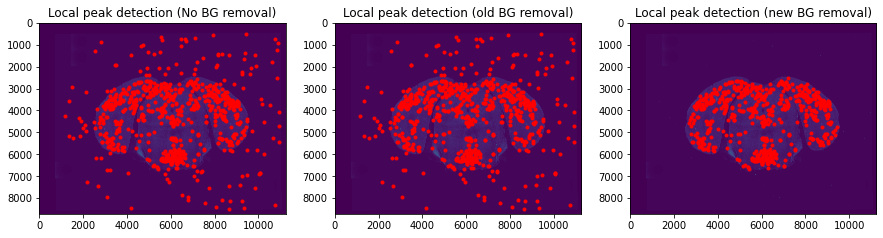

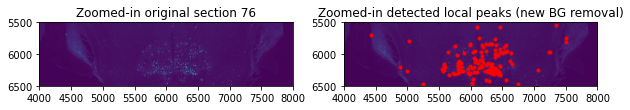

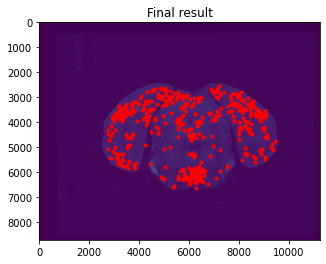

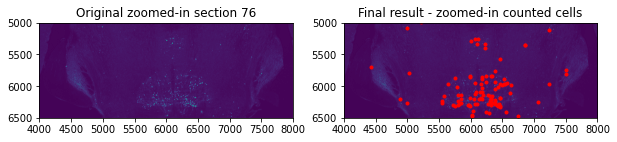

Number of detected cells: 497 


77 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0078_1_0.tif


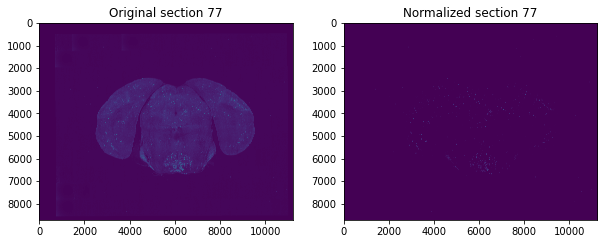

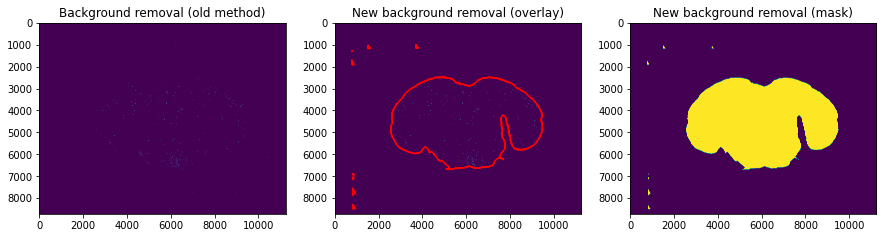

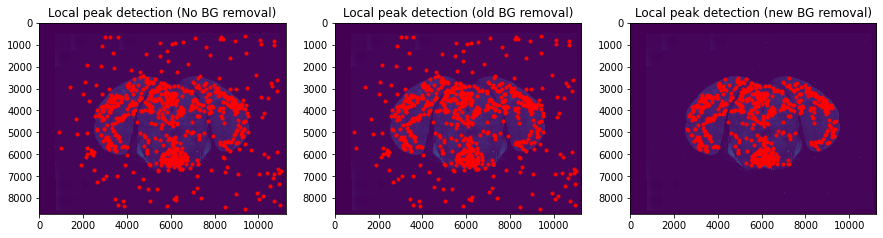

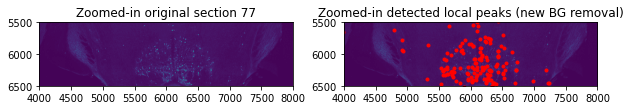

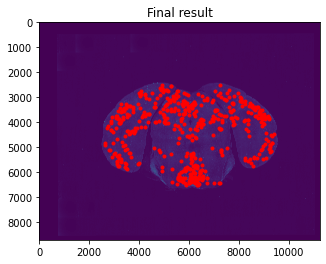

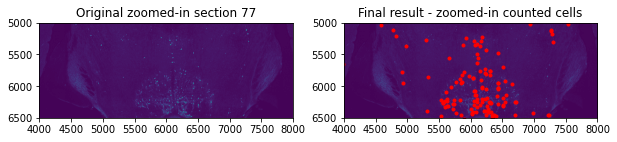

Number of detected cells: 523 


78 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0079_1_0.tif


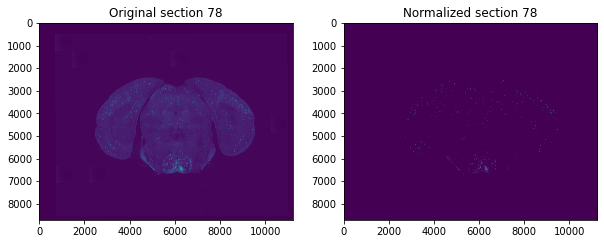

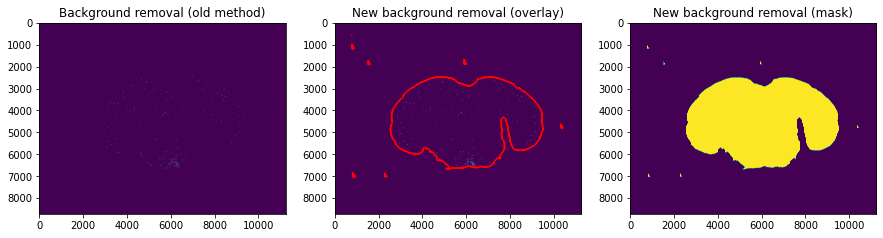

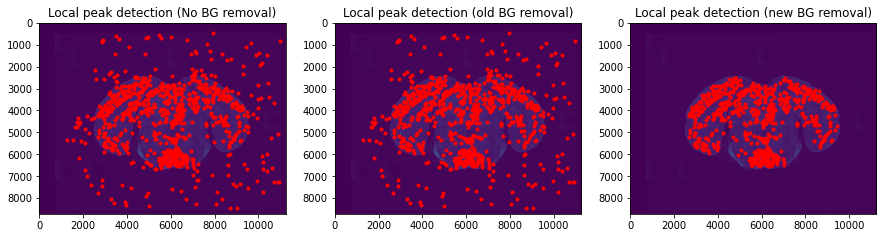

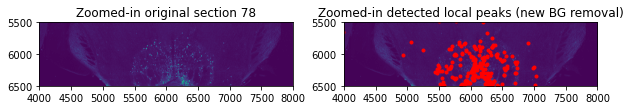

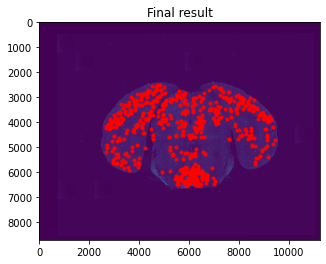

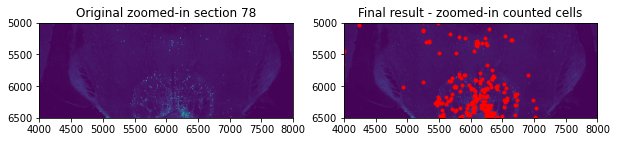

Number of detected cells: 634 


79 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0080_1_0.tif


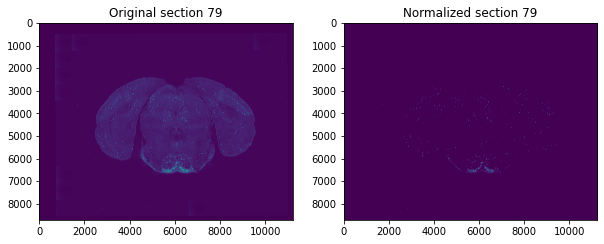

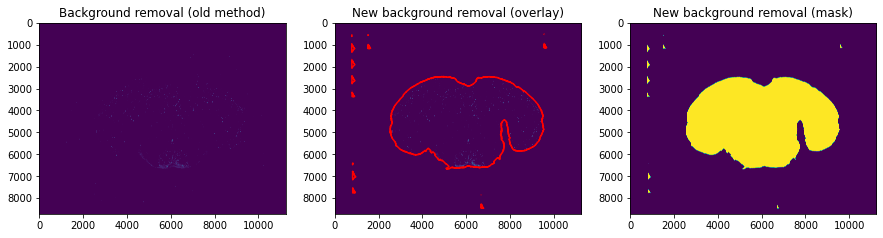

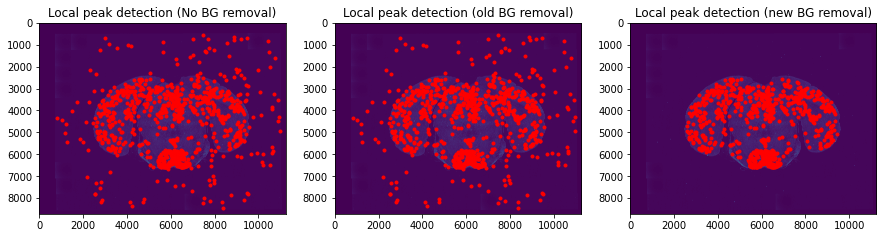

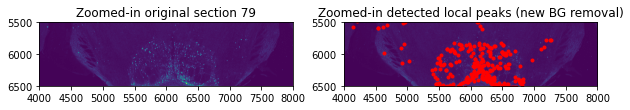

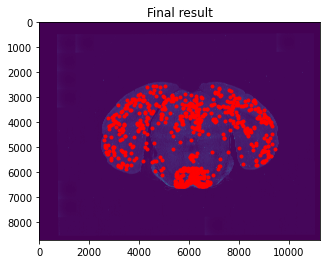

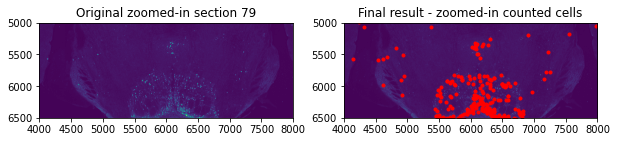

Number of detected cells: 737 


80 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0081_1_0.tif


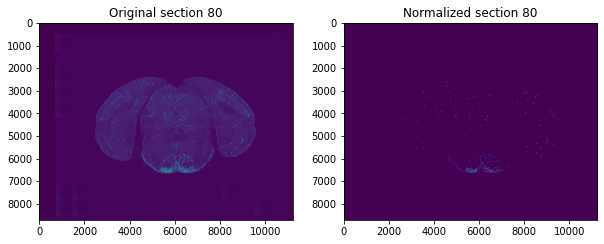

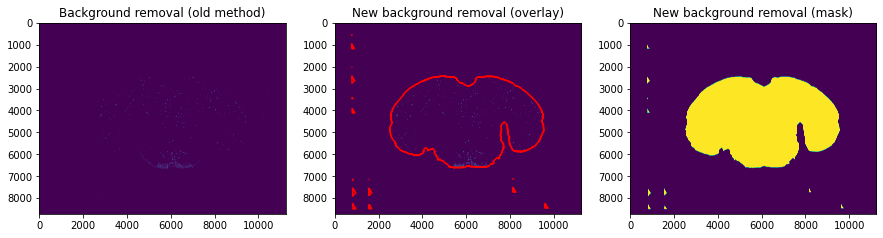

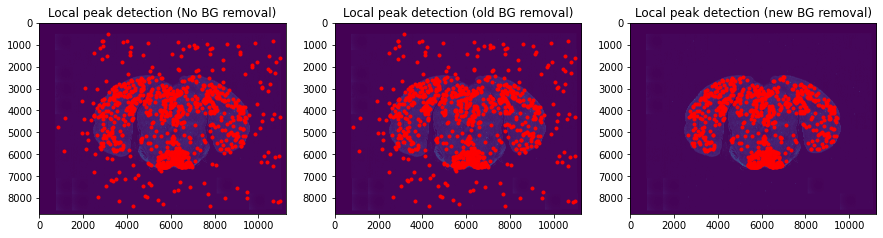

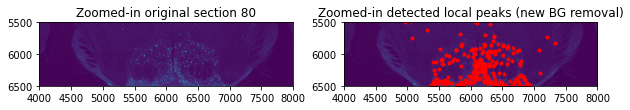

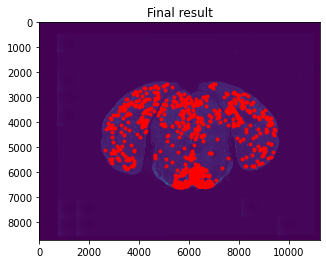

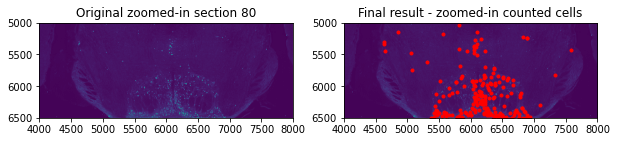

Number of detected cells: 737 


81 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0082_1_0.tif


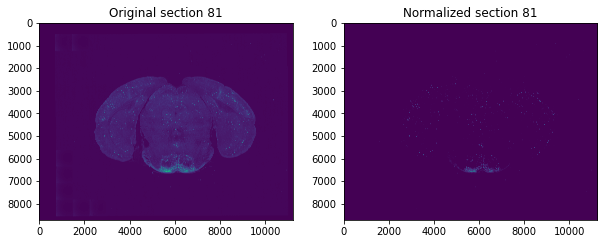

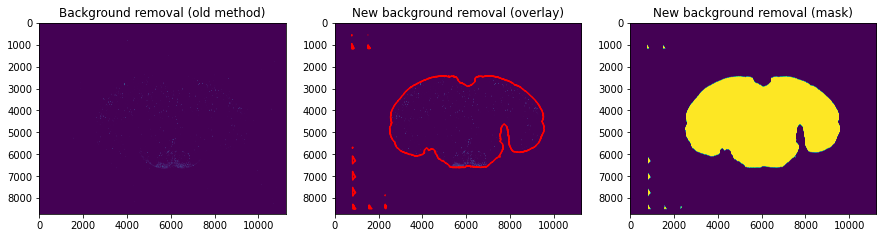

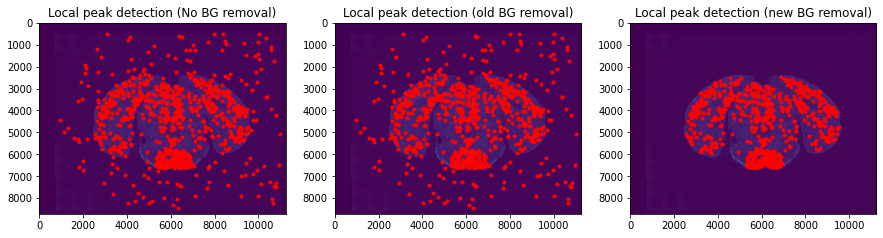

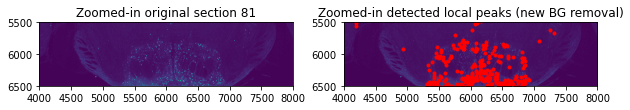

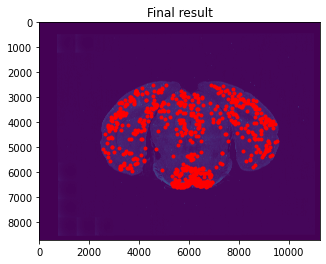

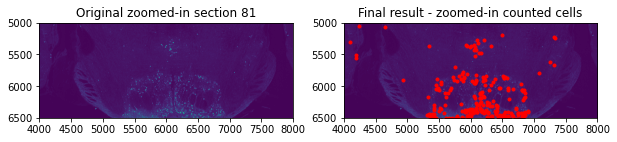

Number of detected cells: 739 


82 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0083_1_0.tif


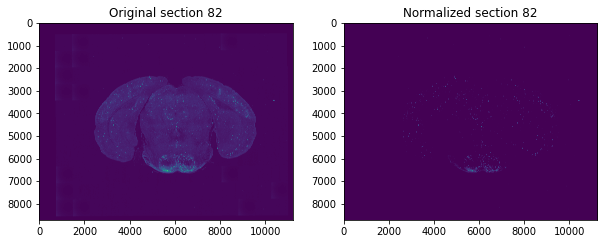

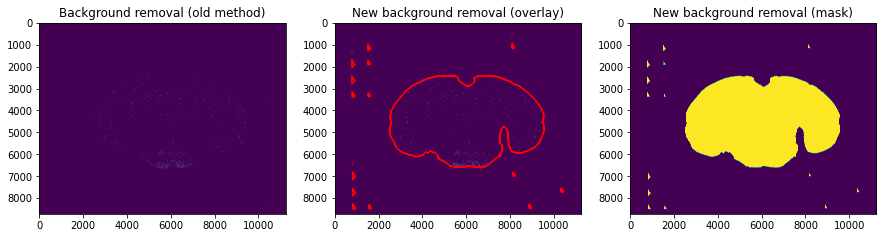

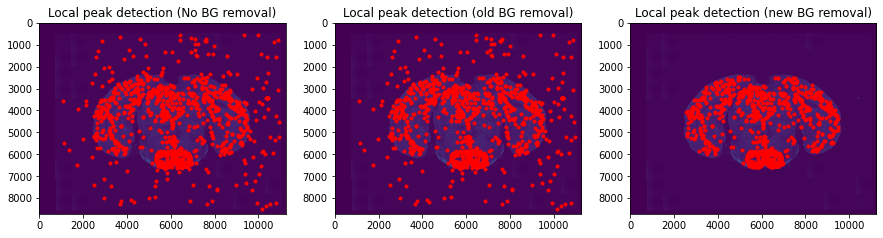

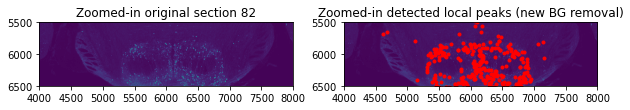

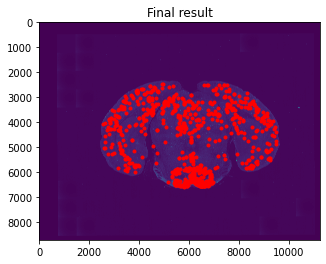

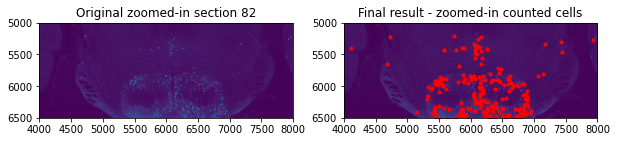

Number of detected cells: 762 


83 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0084_1_0.tif


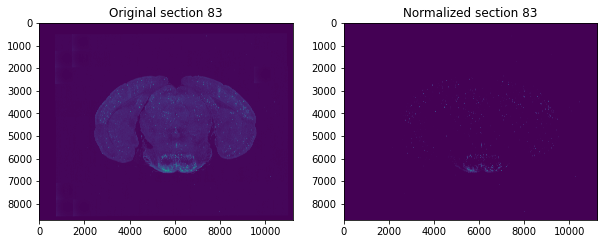

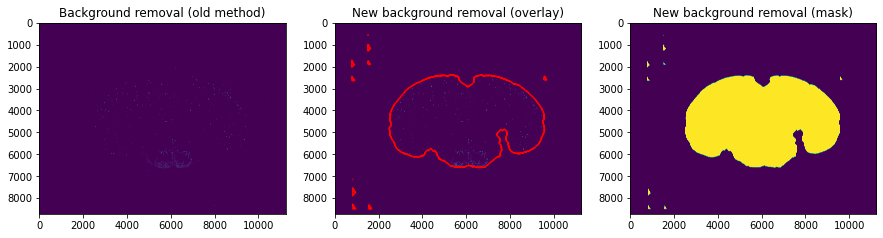

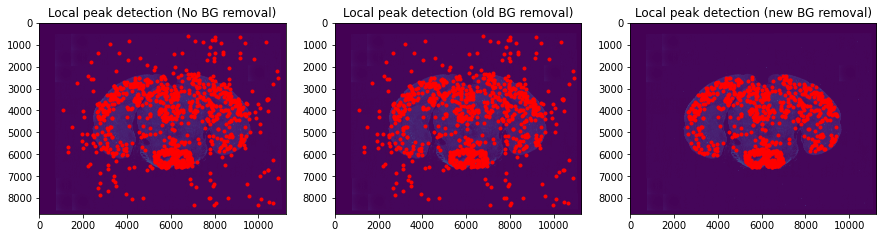

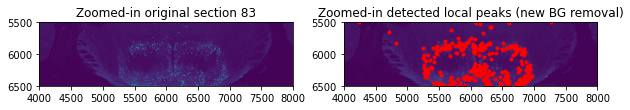

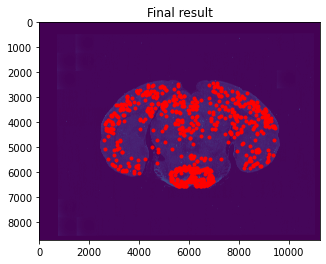

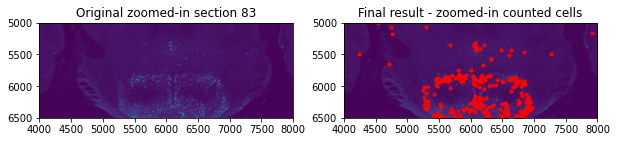

Number of detected cells: 758 


84 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0085_1_0.tif


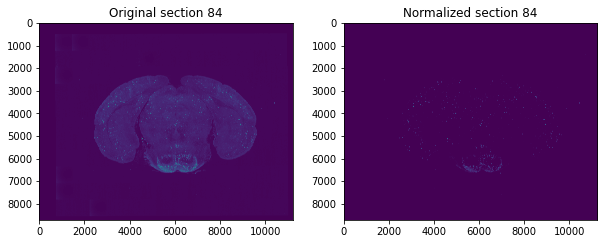

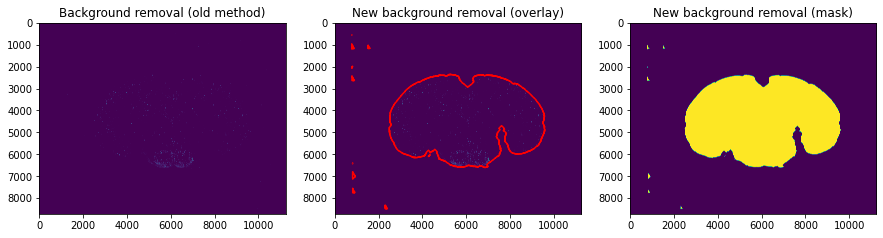

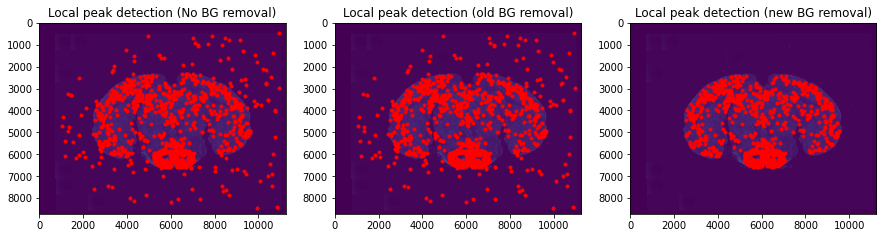

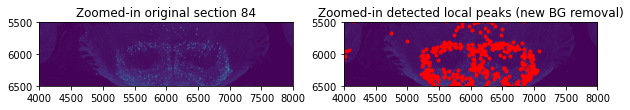

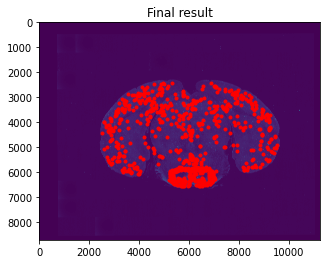

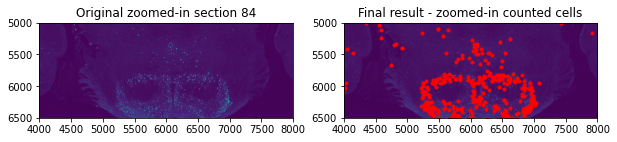

Number of detected cells: 794 


85 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0086_1_0.tif


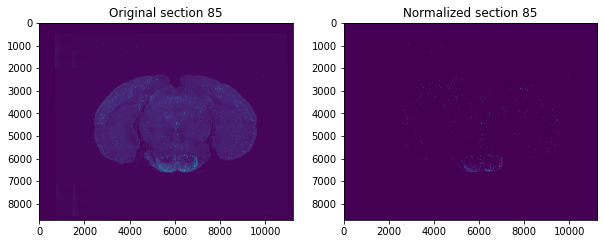

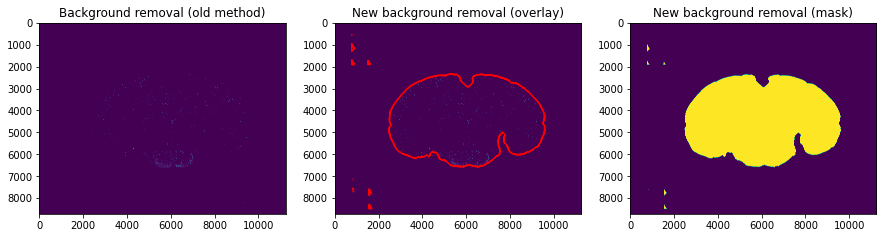

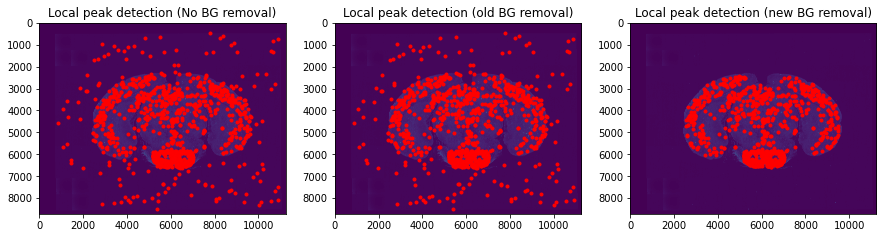

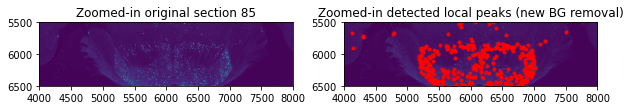

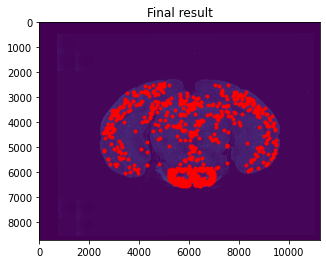

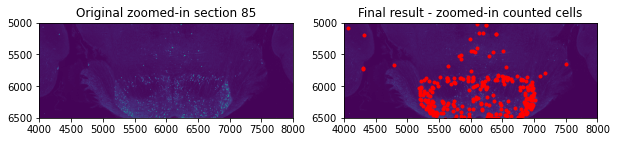

Number of detected cells: 730 


86 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0087_1_0.tif


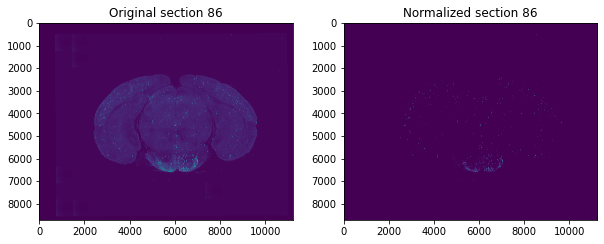

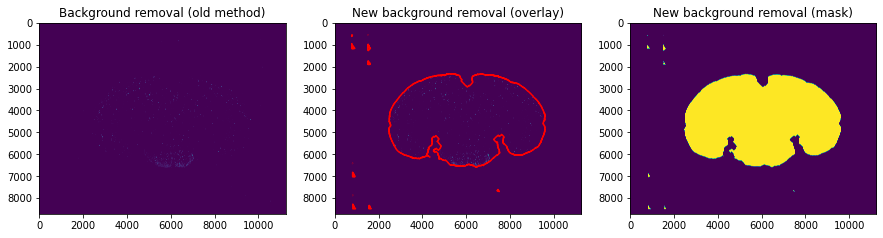

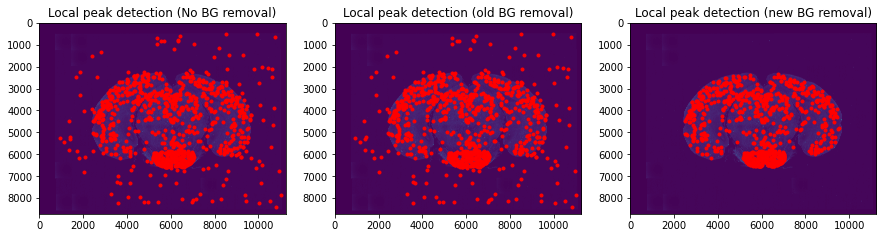

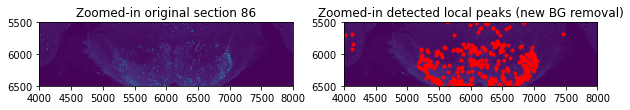

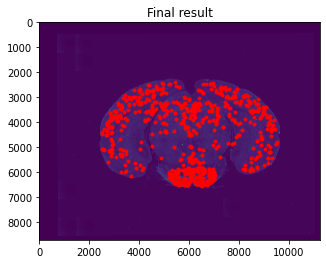

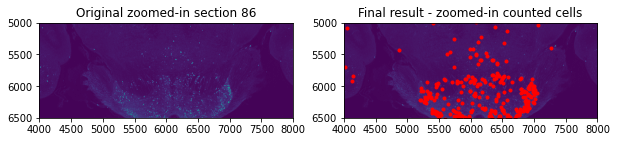

Number of detected cells: 722 


87 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0088_1_0.tif


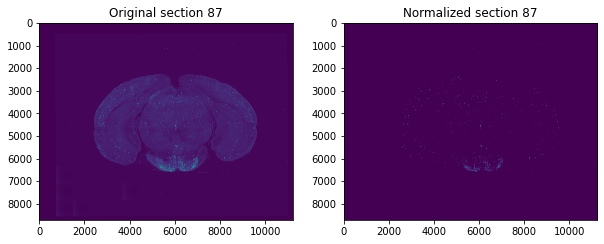

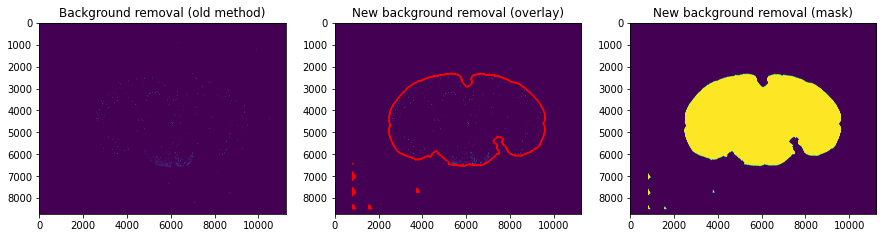

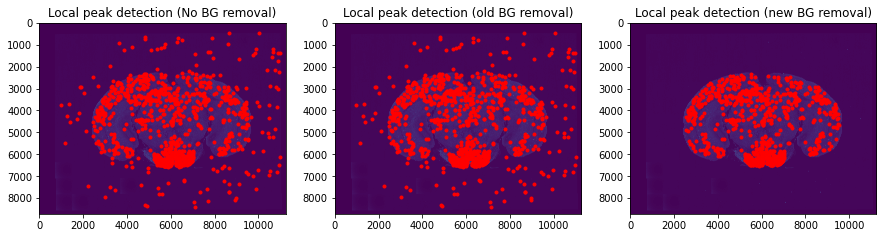

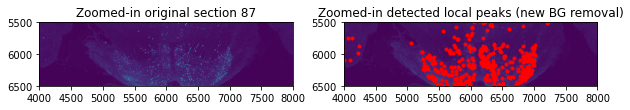

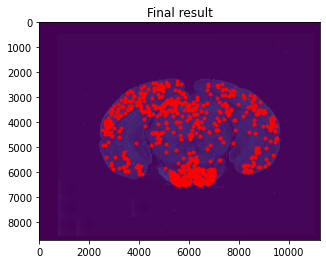

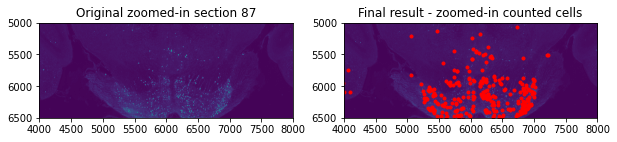

Number of detected cells: 698 


88 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0089_1_0.tif


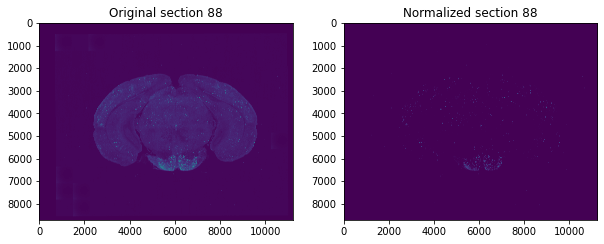

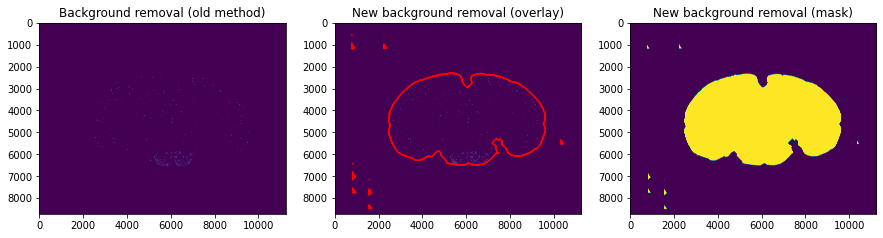

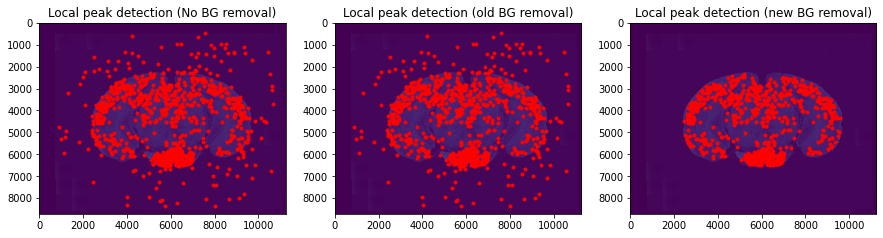

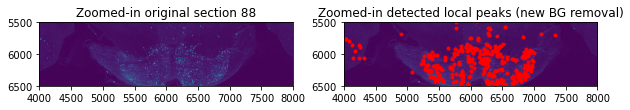

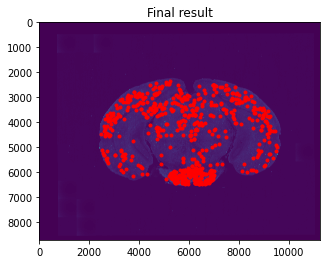

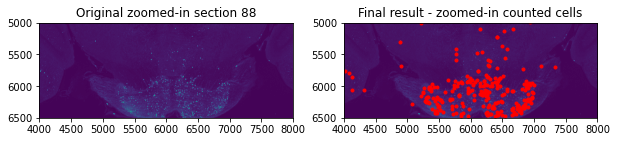

Number of detected cells: 685 


89 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0090_1_0.tif


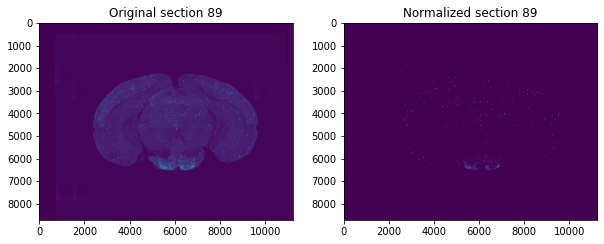

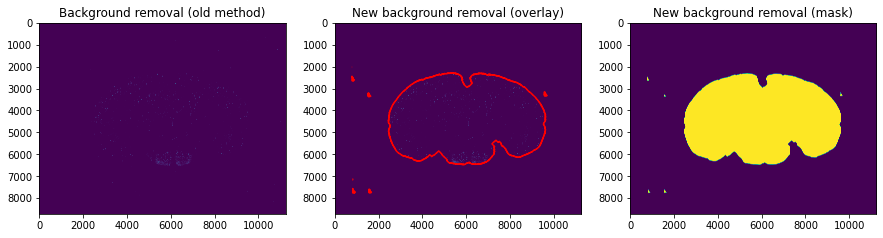

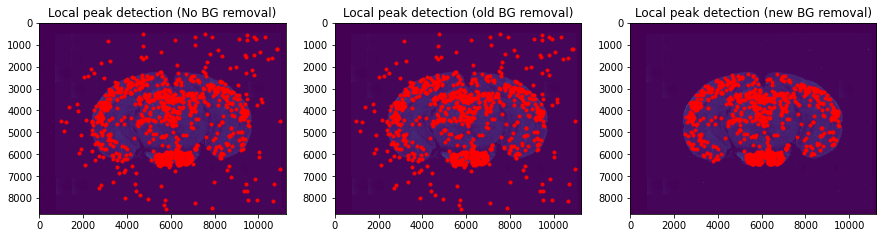

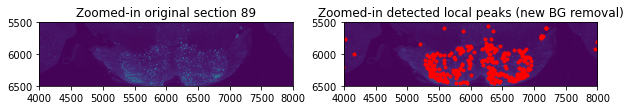

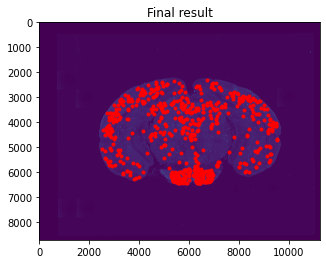

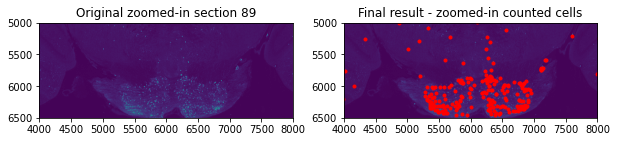

Number of detected cells: 655 


90 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0091_1_0.tif


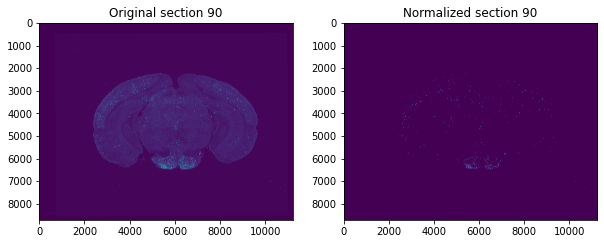

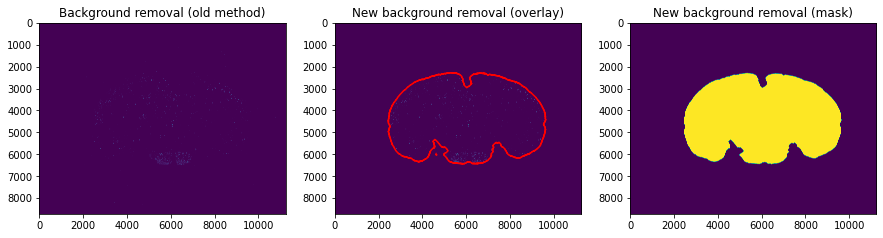

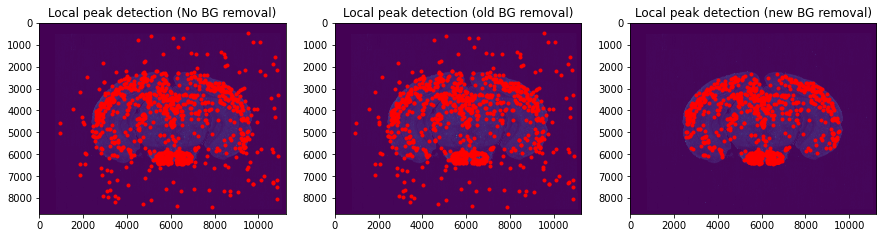

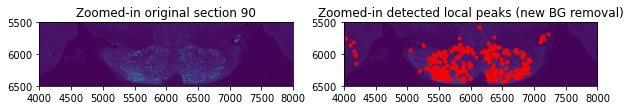

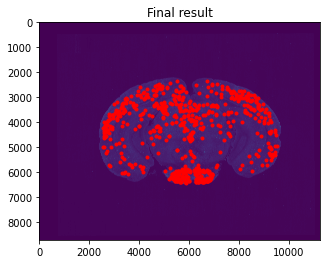

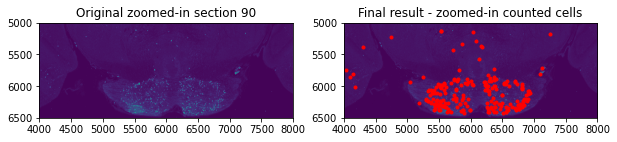

Number of detected cells: 690 


91 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0092_1_0.tif


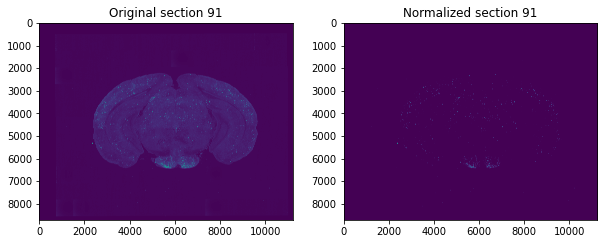

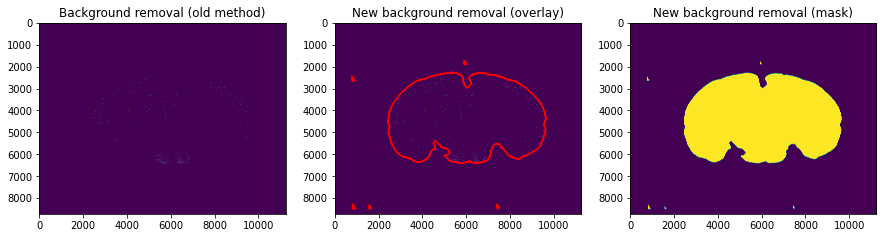

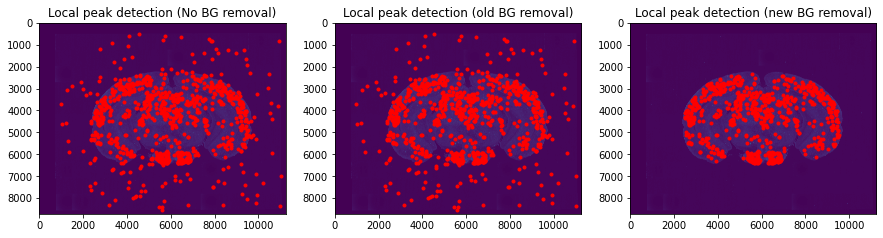

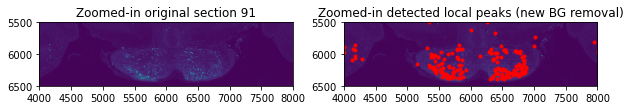

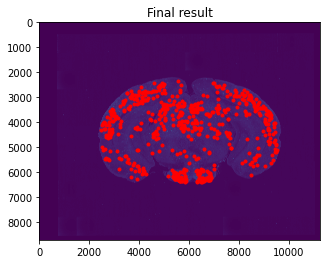

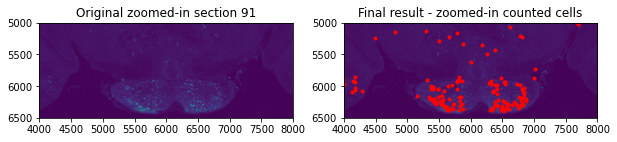

Number of detected cells: 608 


92 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0093_1_0.tif


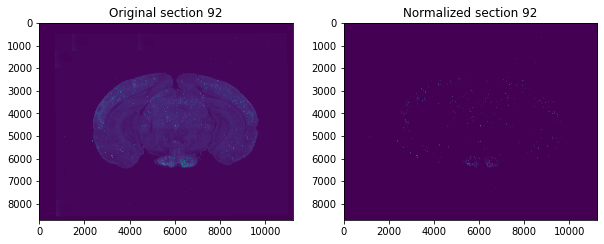

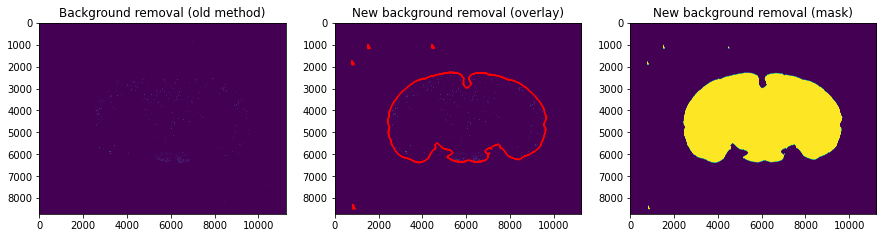

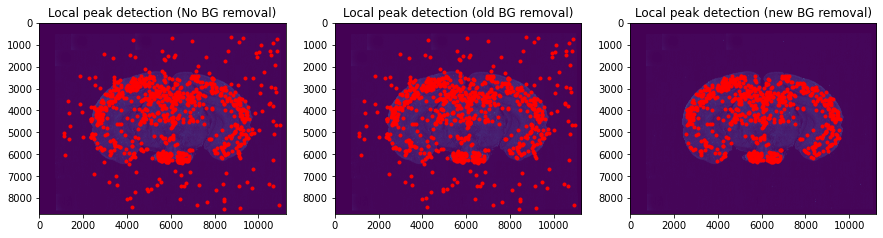

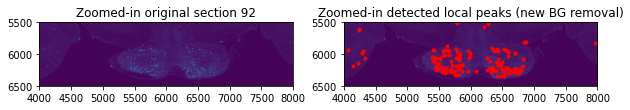

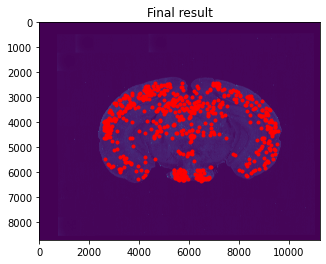

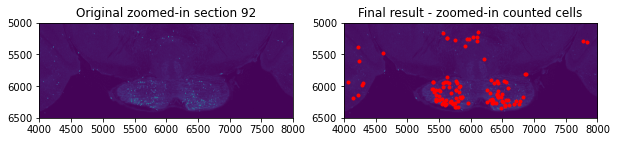

Number of detected cells: 614 


93 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0094_1_0.tif


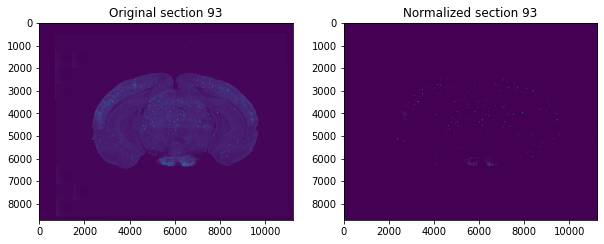

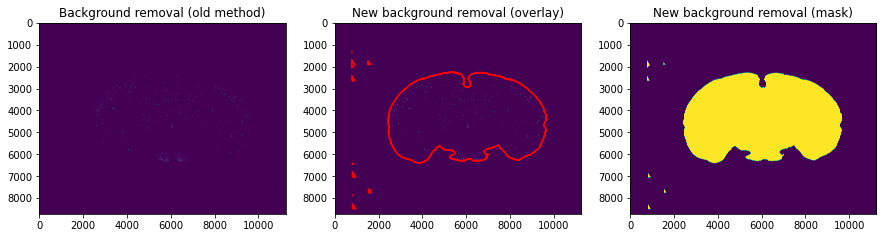

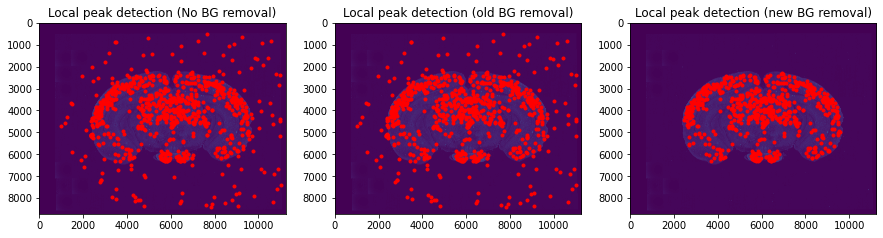

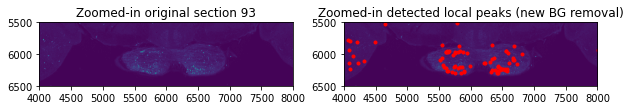

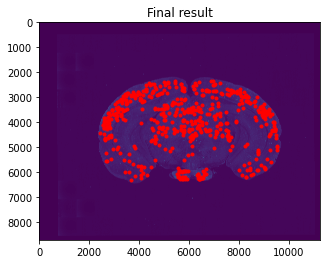

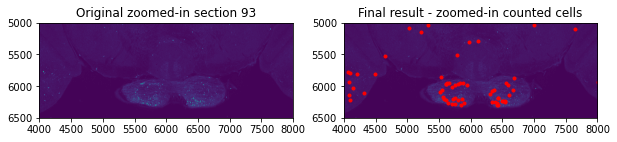

Number of detected cells: 547 


94 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0095_1_0.tif


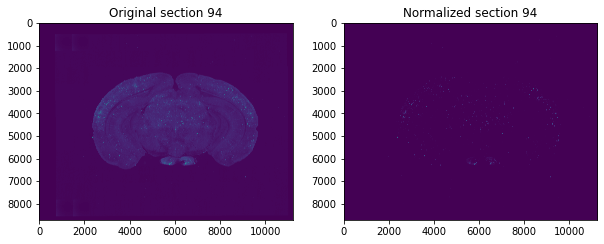

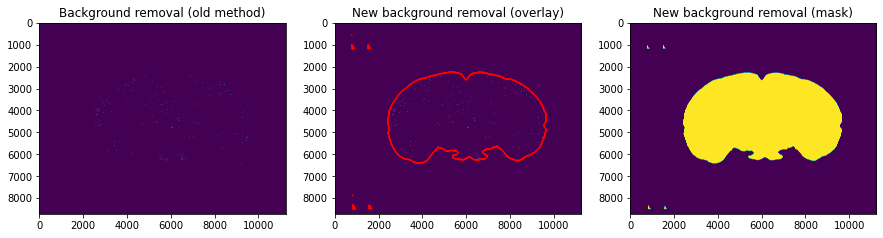

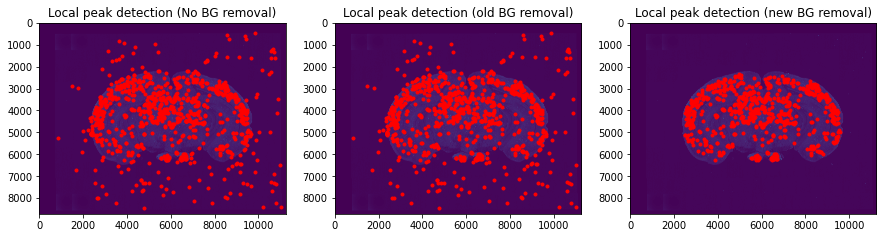

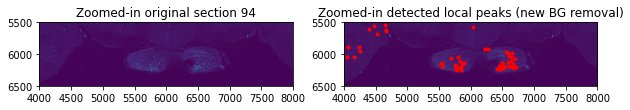

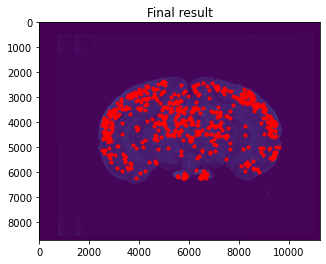

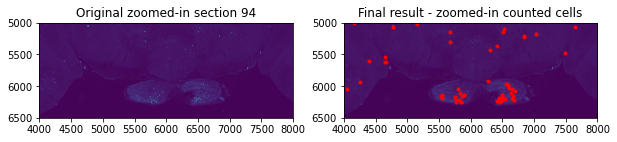

Number of detected cells: 565 


95 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0096_1_0.tif


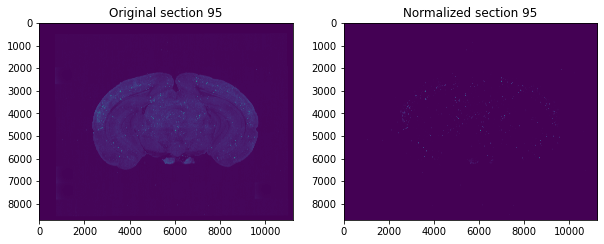

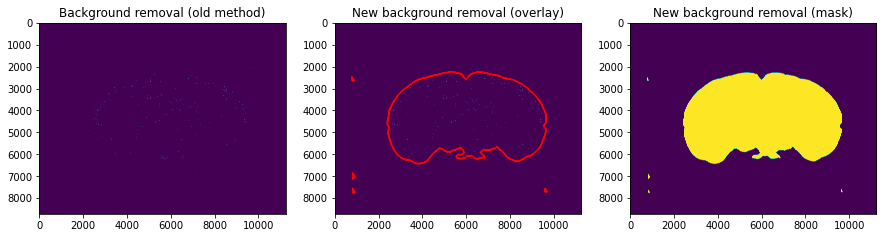

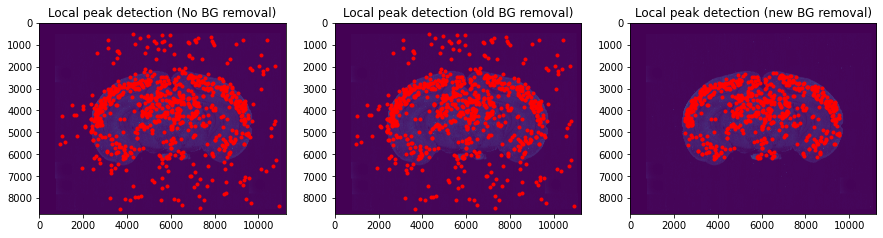

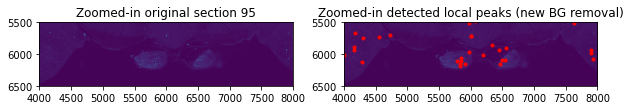

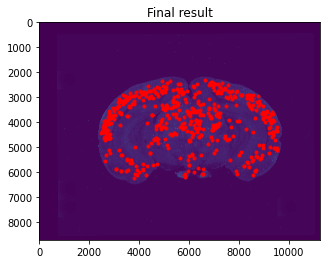

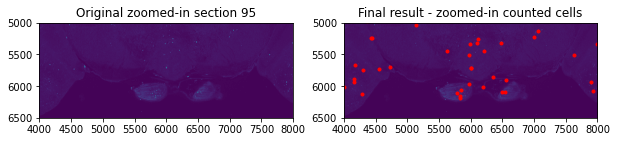

Number of detected cells: 530 


96 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0097_1_0.tif


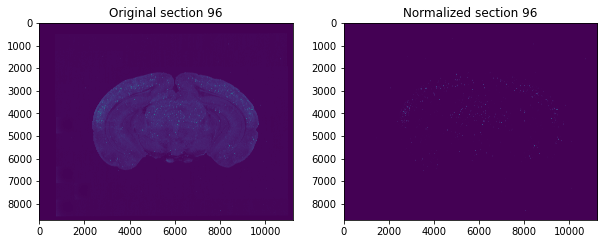

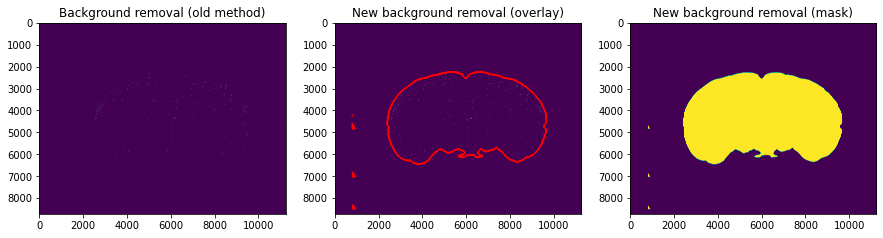

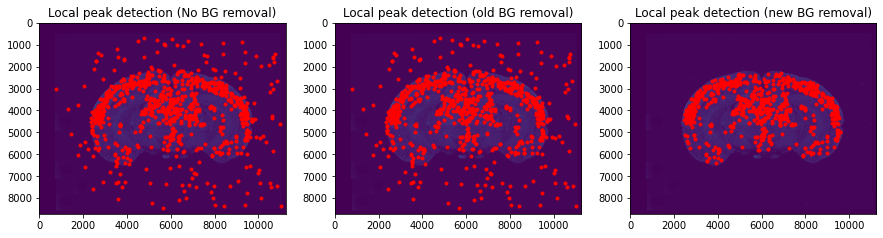

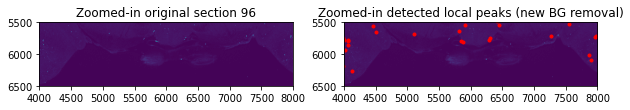

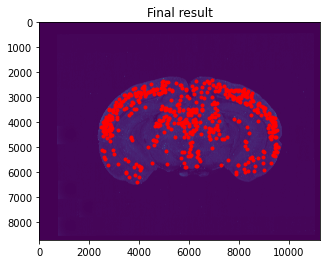

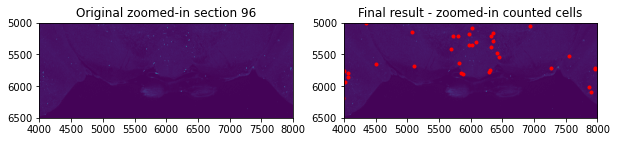

Number of detected cells: 534 


97 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0098_1_0.tif


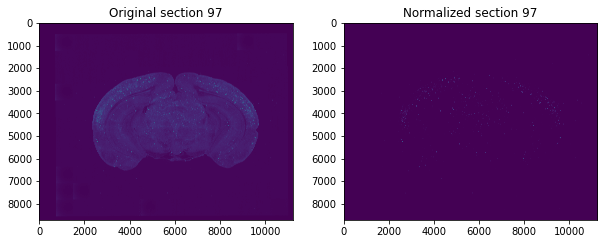

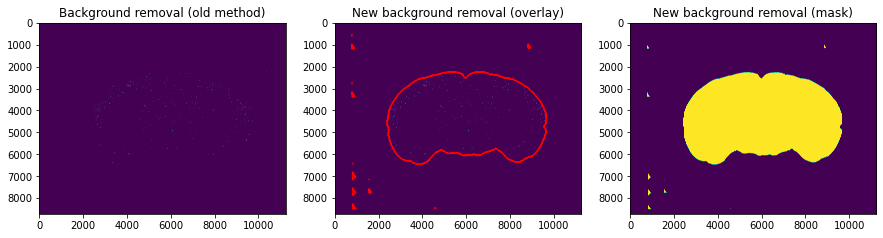

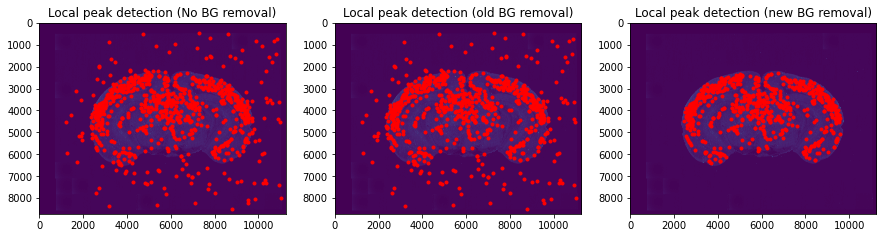

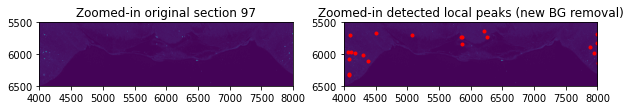

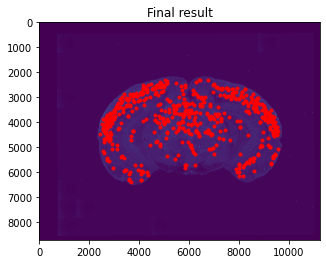

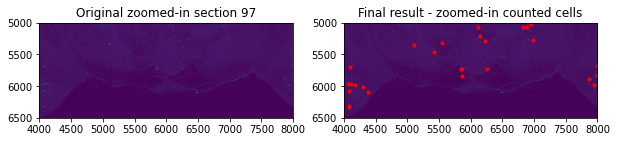

Number of detected cells: 548 


98 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0099_1_0.tif


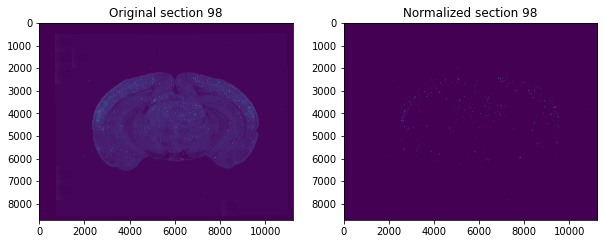

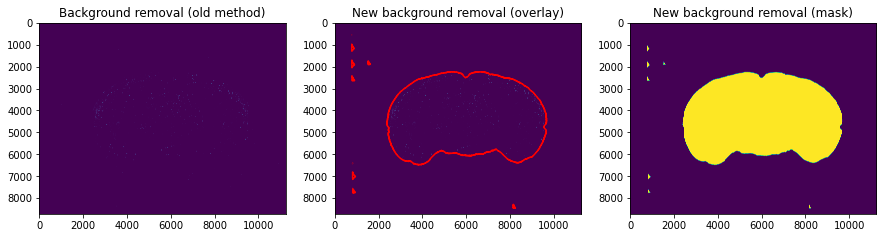

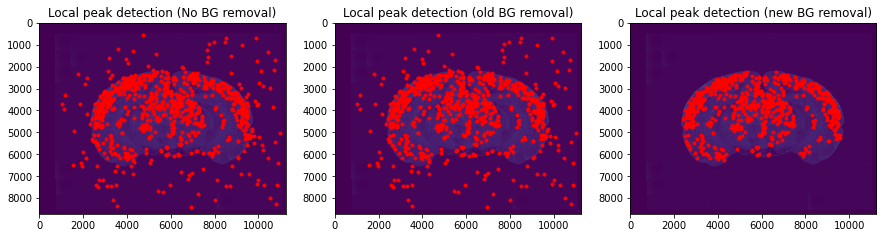

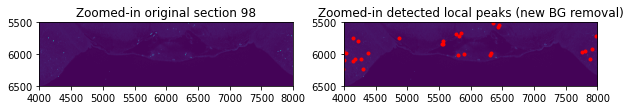

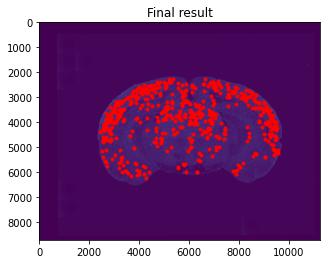

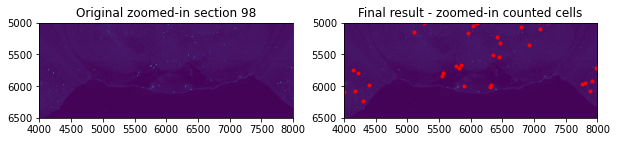

Number of detected cells: 549 


99 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0100_1_0.tif


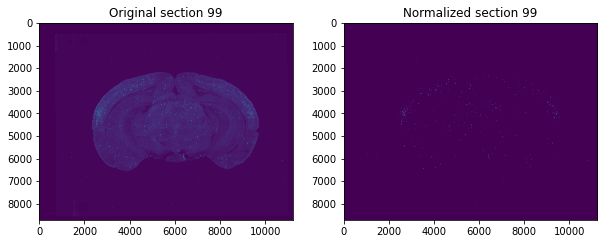

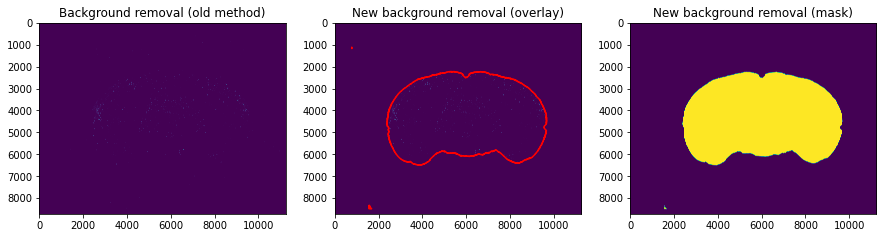

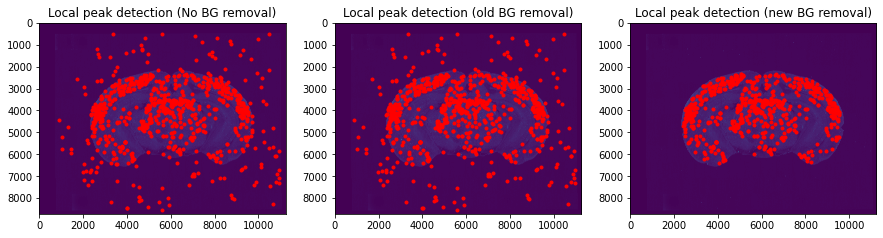

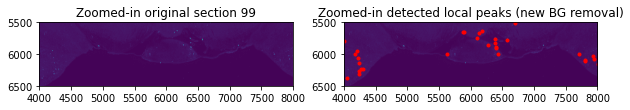

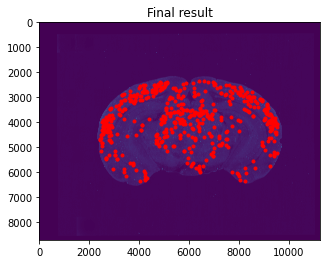

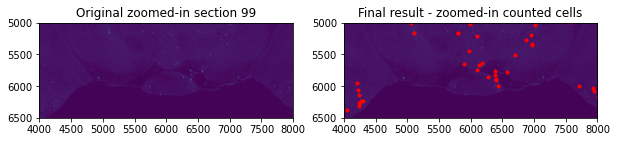

Number of detected cells: 526 


100 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0101_1_0.tif


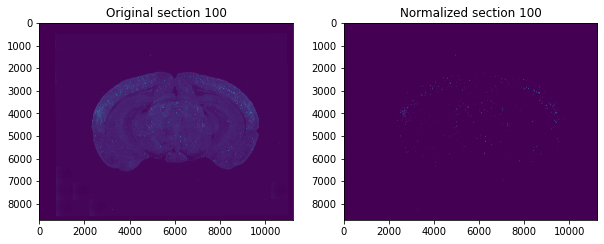

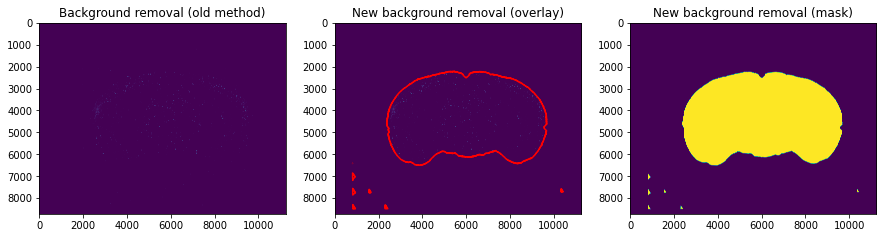

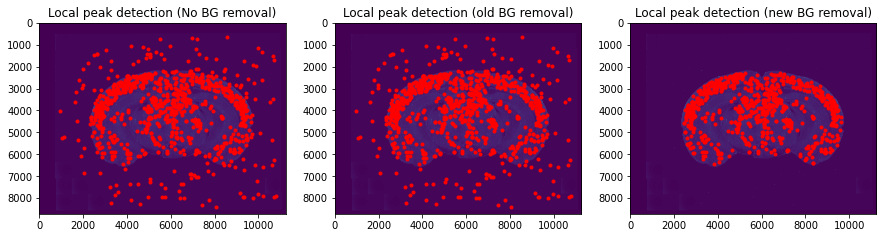

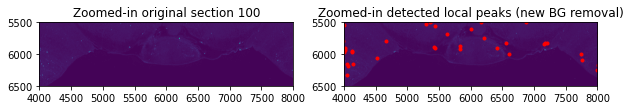

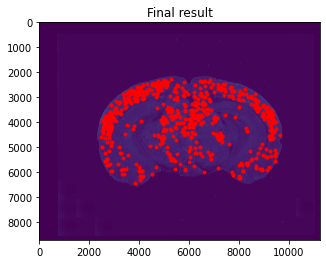

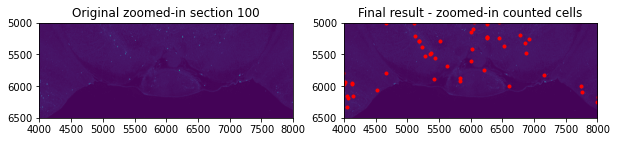

Number of detected cells: 580 


101 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0102_1_0.tif


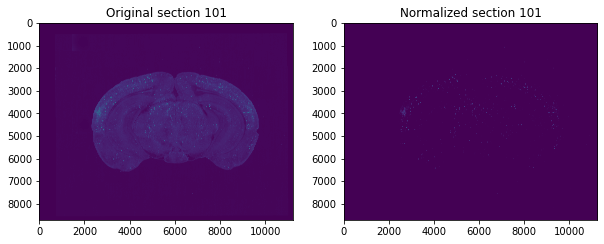

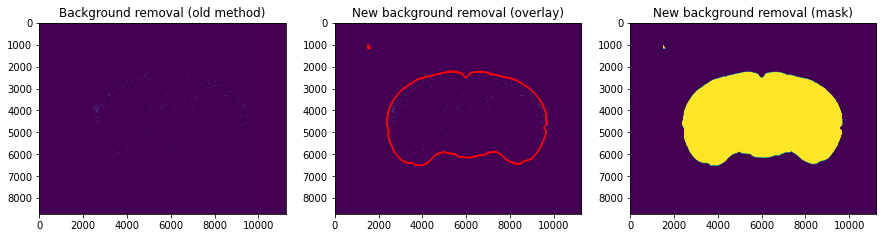

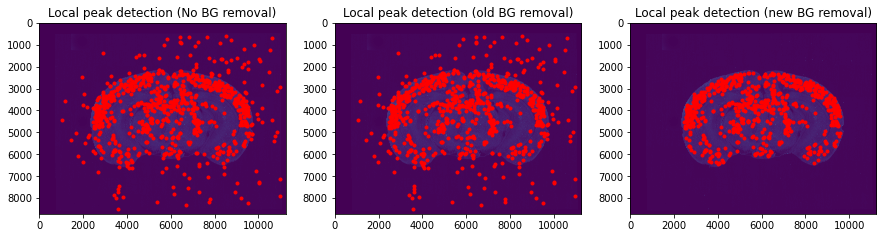

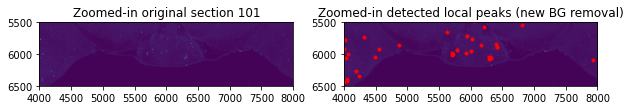

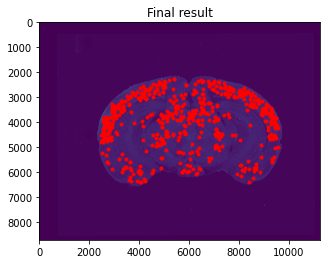

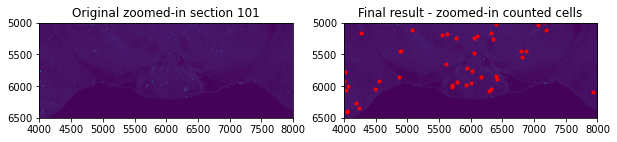

Number of detected cells: 554 


102 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0103_1_0.tif


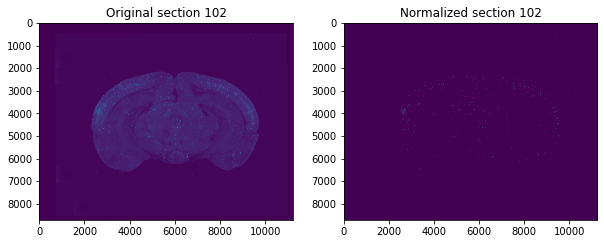

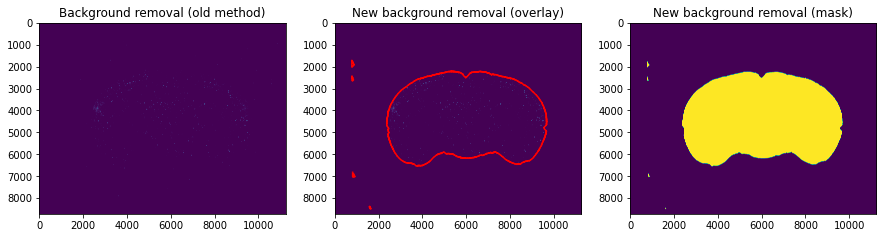

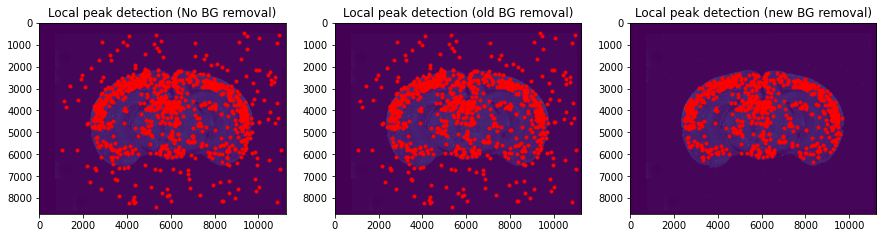

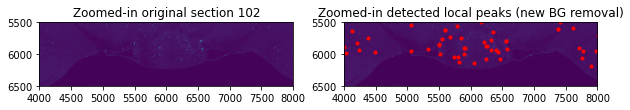

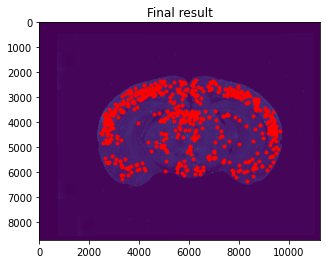

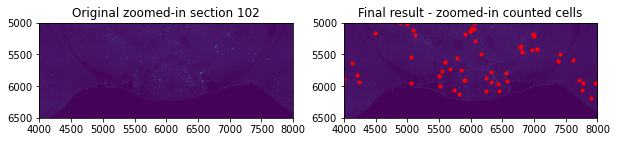

Number of detected cells: 579 


103 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0104_1_0.tif


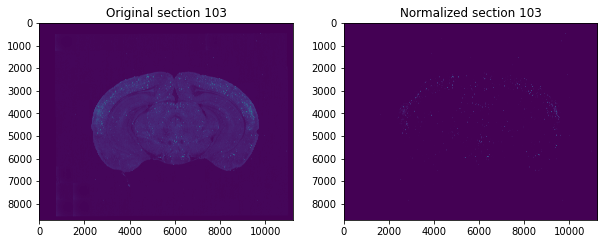

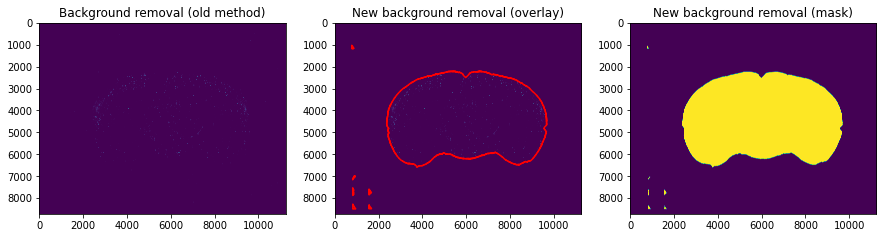

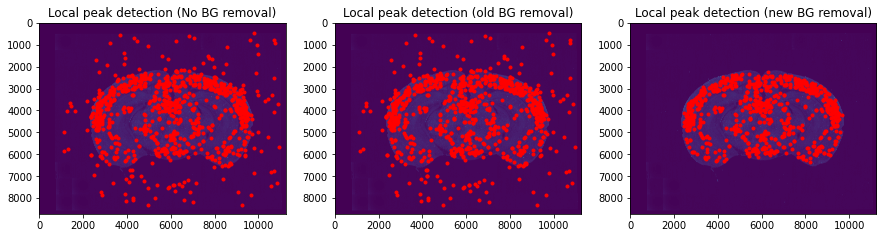

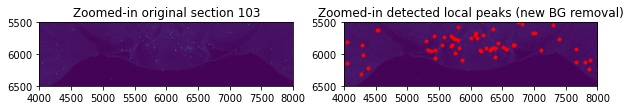

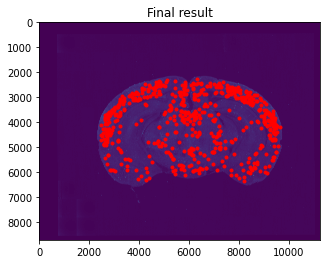

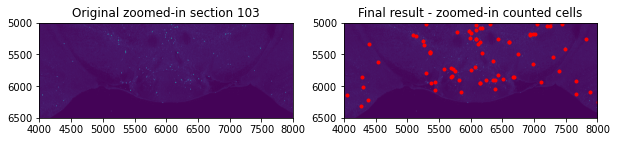

Number of detected cells: 624 


104 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0105_1_0.tif


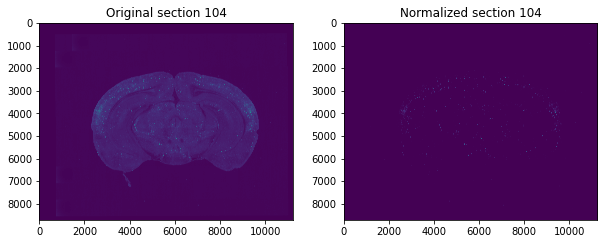

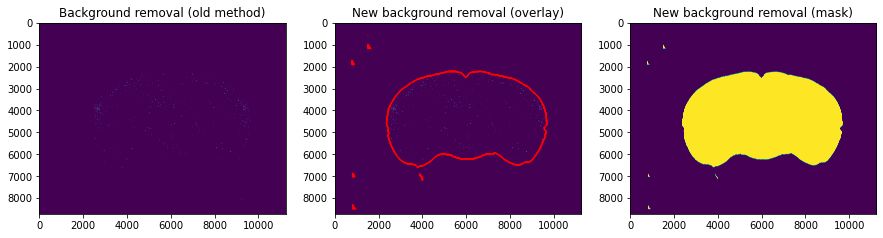

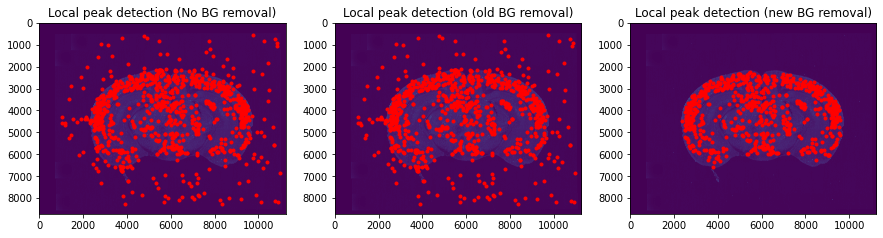

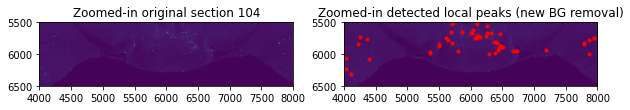

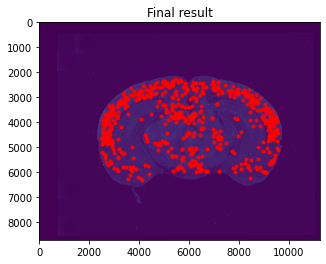

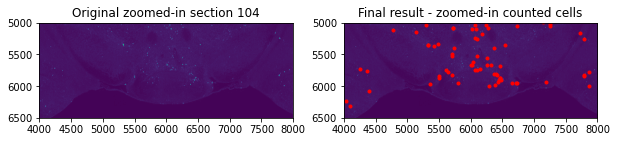

Number of detected cells: 595 


105 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0106_1_0.tif


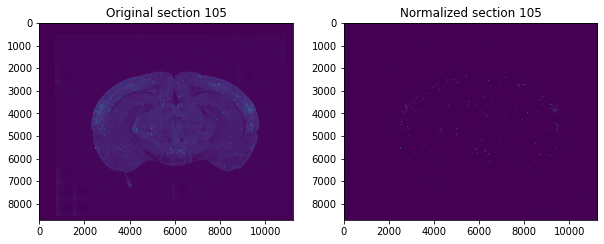

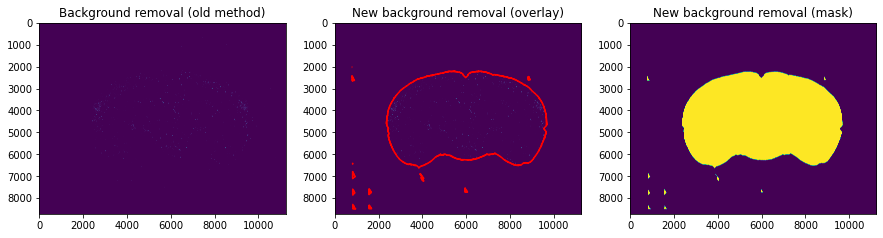

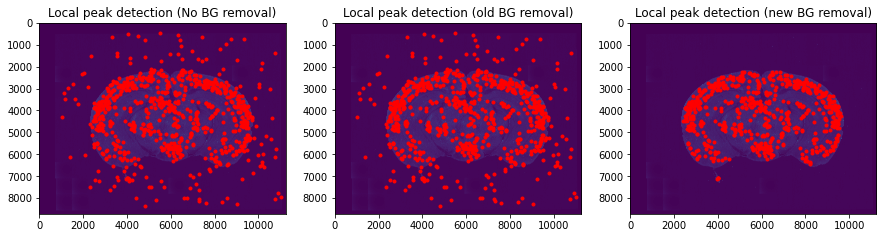

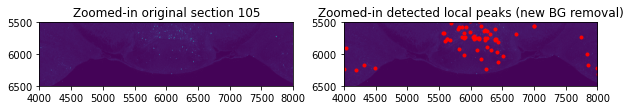

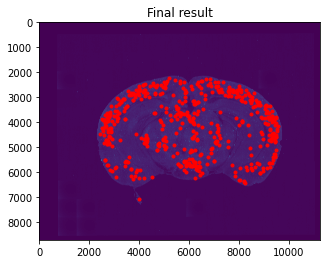

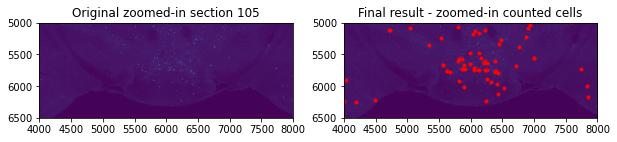

Number of detected cells: 522 


106 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0107_1_0.tif


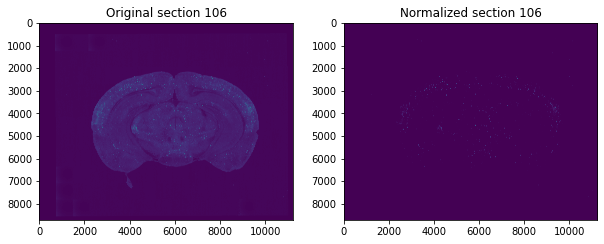

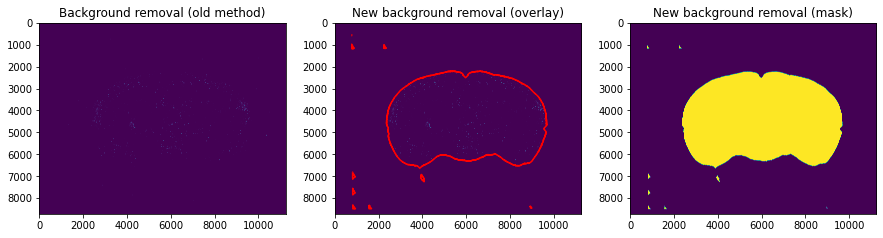

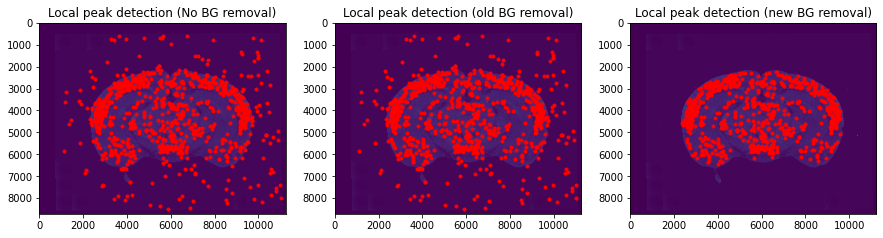

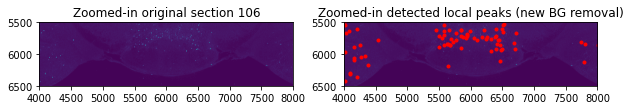

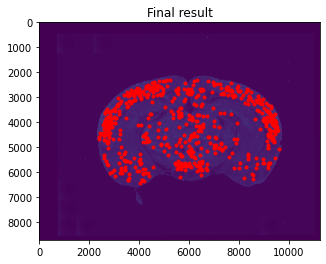

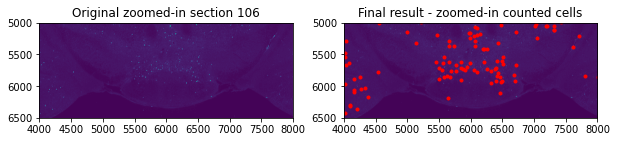

Number of detected cells: 587 


107 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0108_1_0.tif


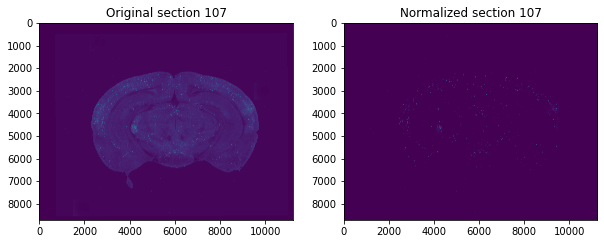

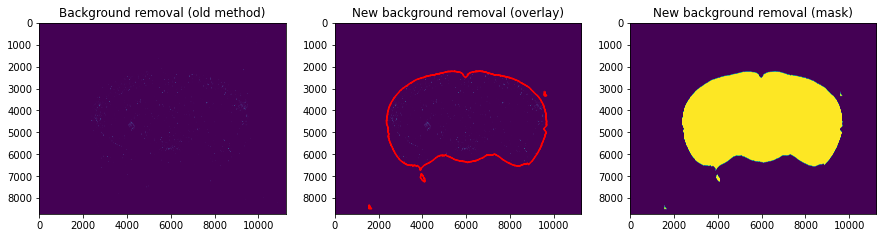

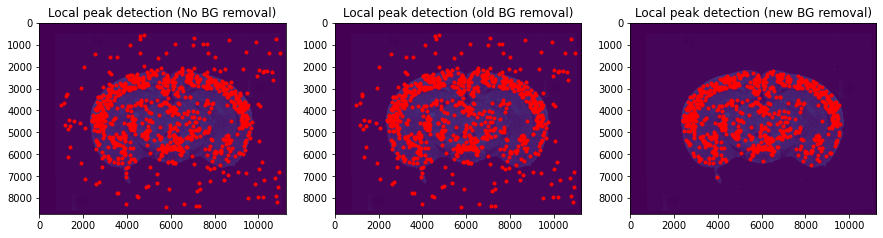

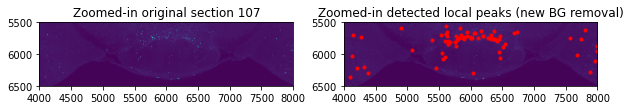

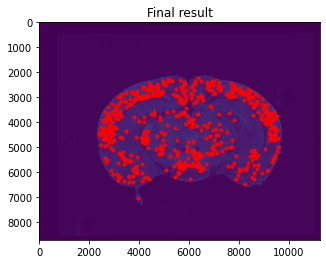

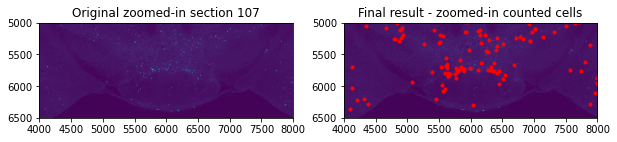

Number of detected cells: 614 


108 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0109_1_0.tif


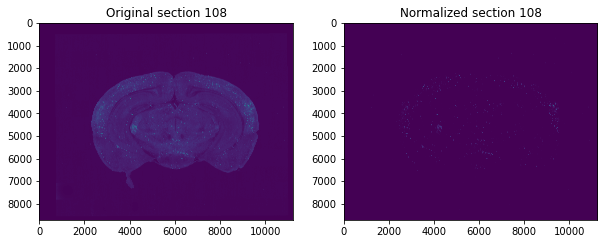

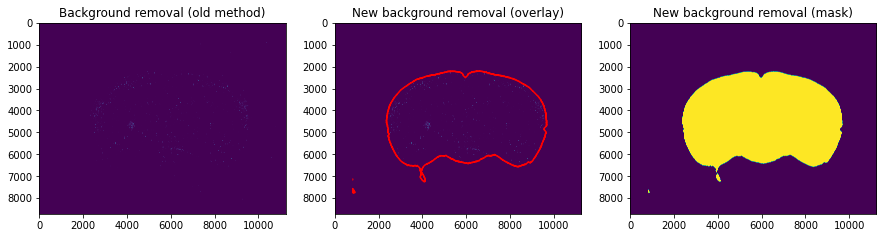

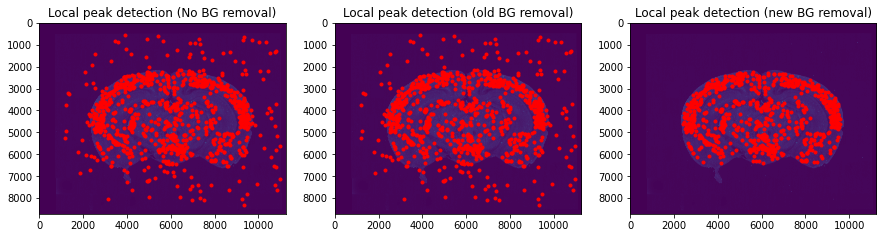

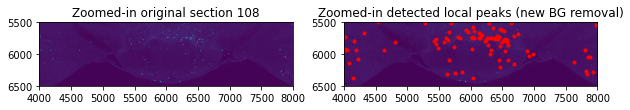

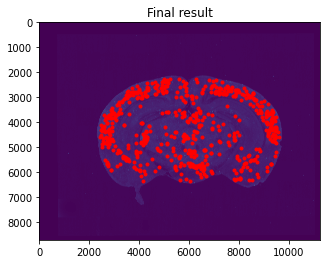

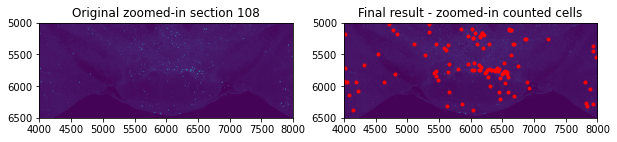

Number of detected cells: 630 


109 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0110_1_0.tif


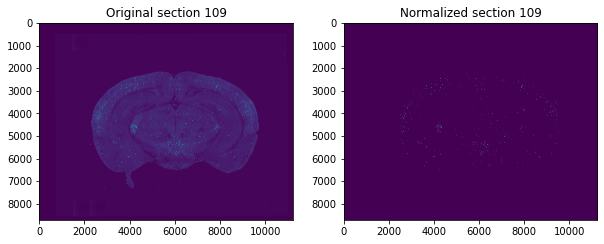

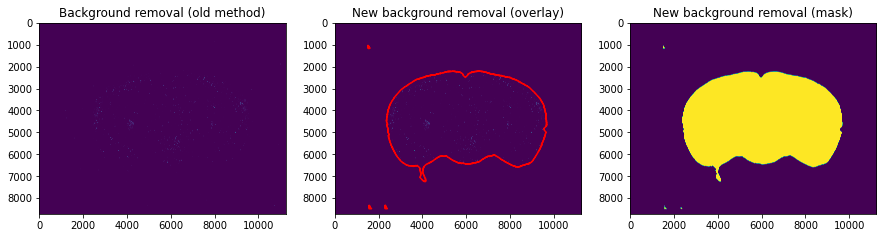

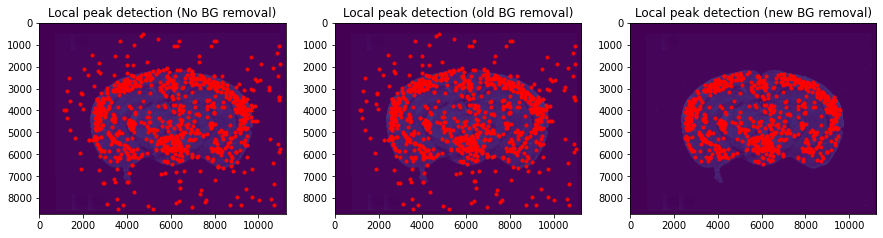

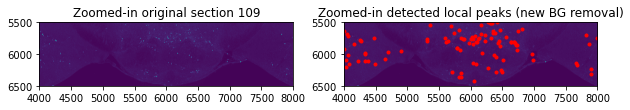

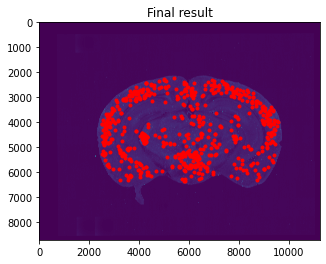

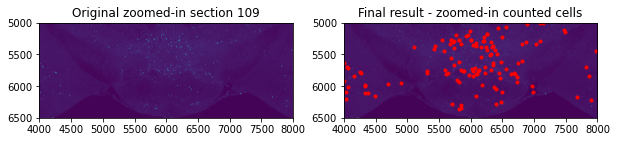

Number of detected cells: 630 


110 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0111_1_0.tif


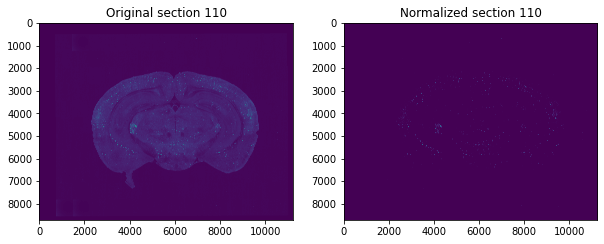

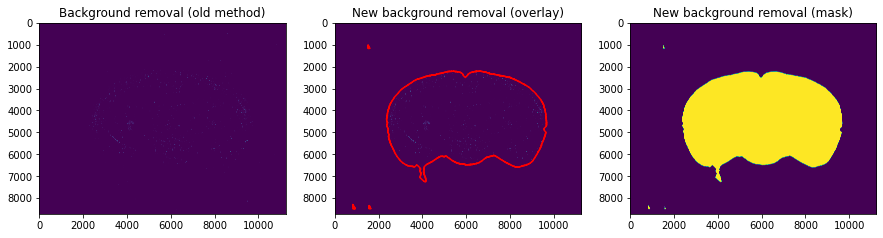

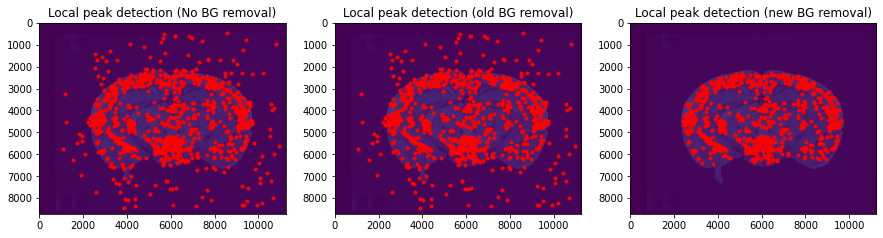

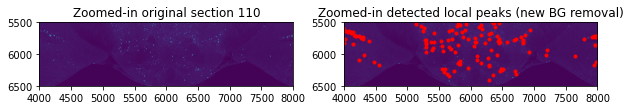

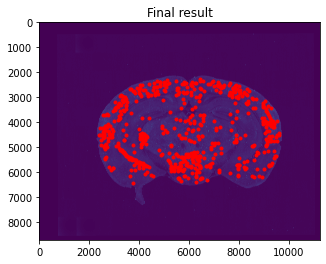

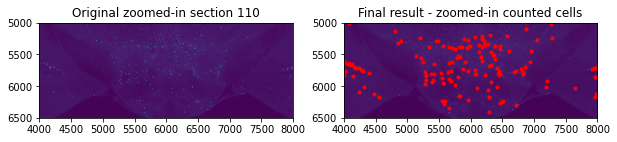

Number of detected cells: 624 


111 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0112_1_0.tif


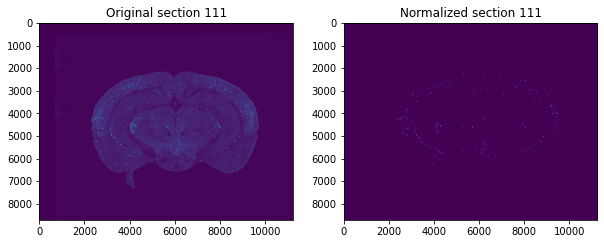

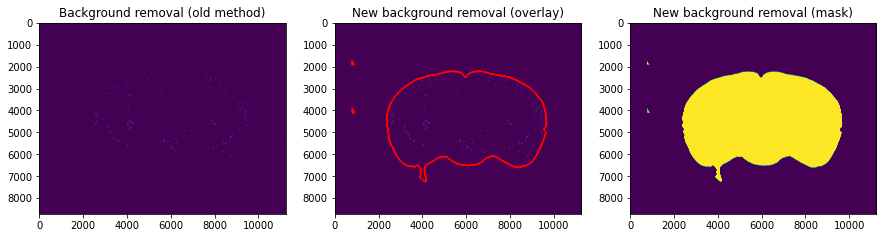

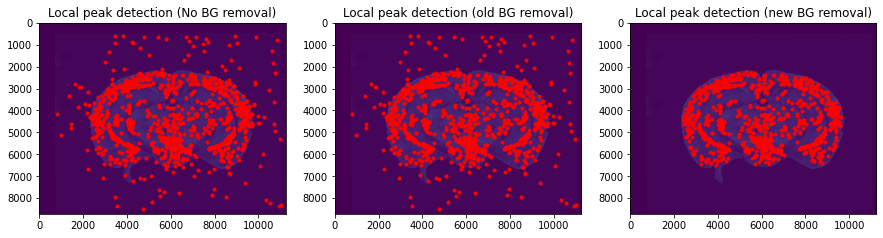

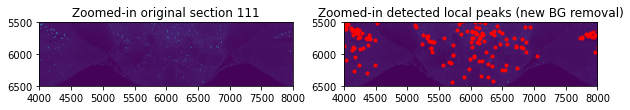

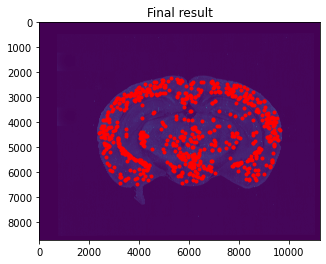

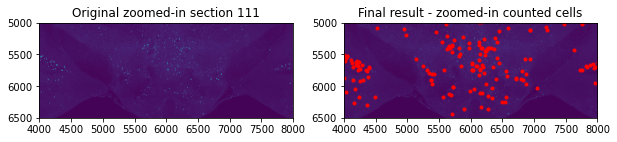

Number of detected cells: 698 


112 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0113_1_0.tif


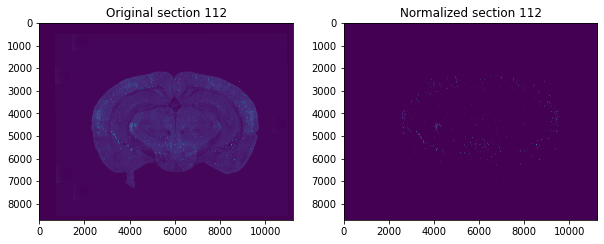

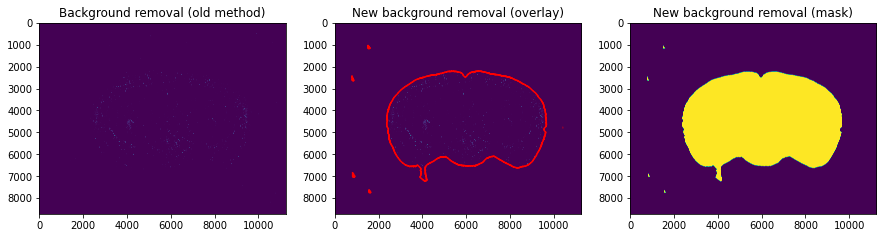

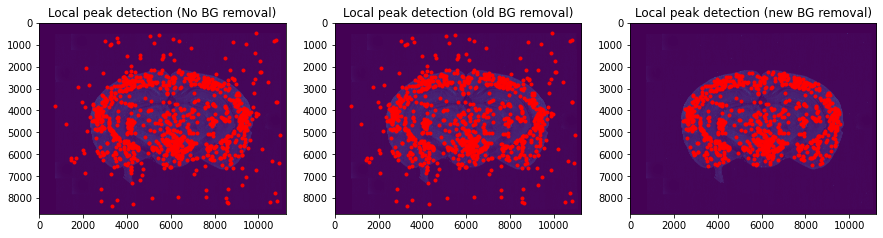

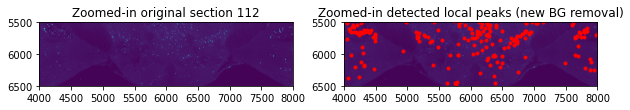

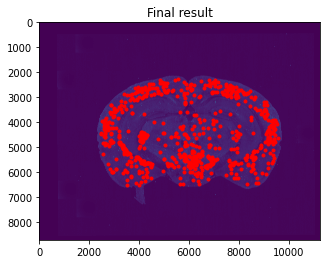

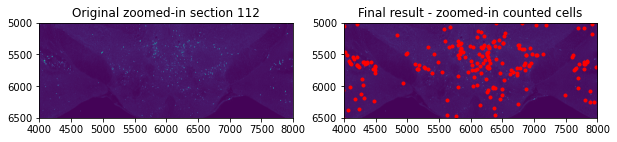

Number of detected cells: 728 


113 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0114_1_0.tif


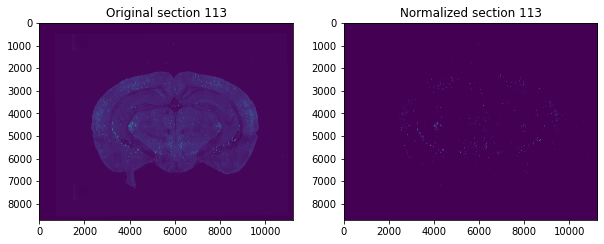

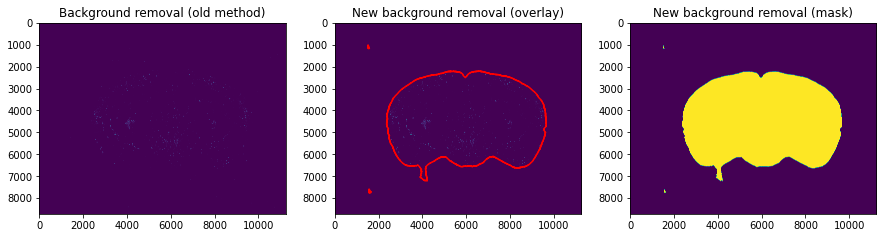

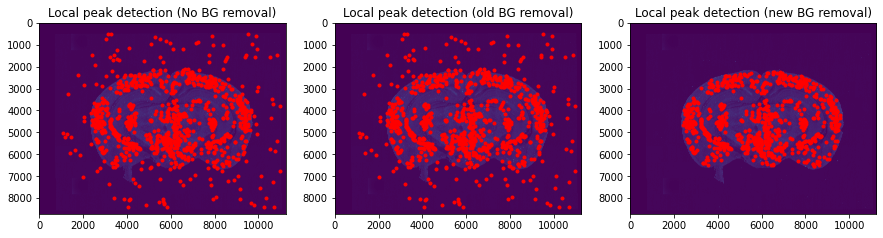

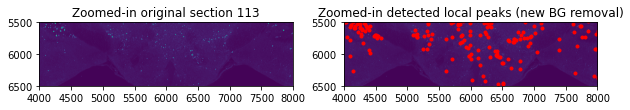

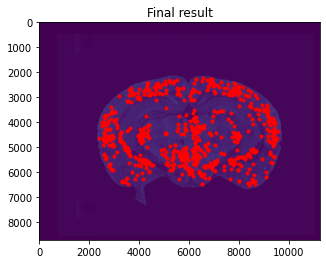

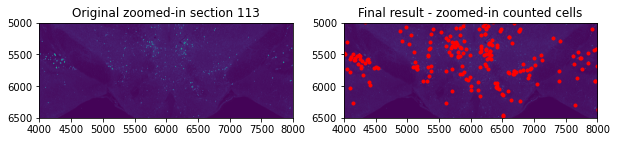

Number of detected cells: 715 


114 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0115_1_0.tif


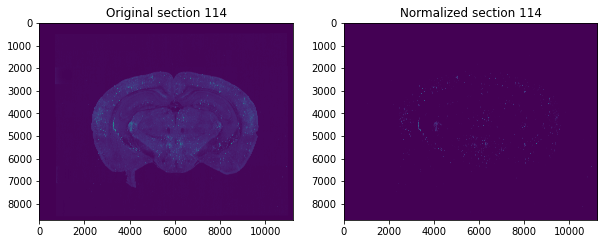

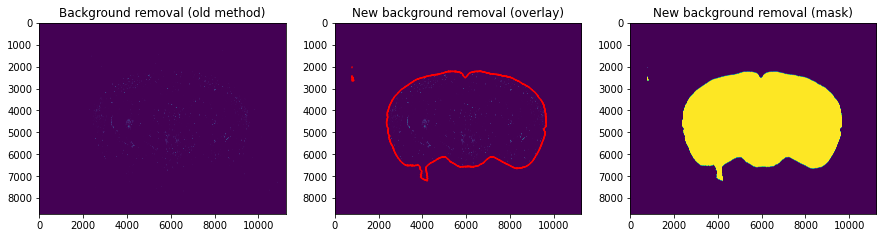

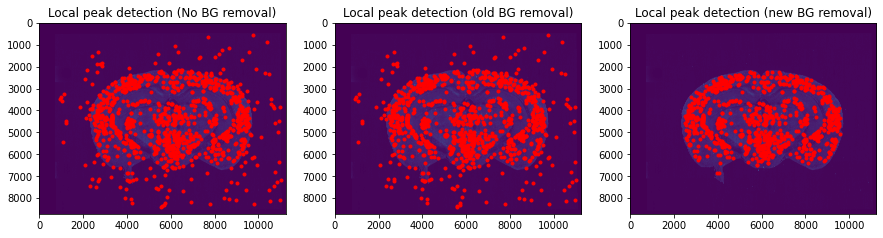

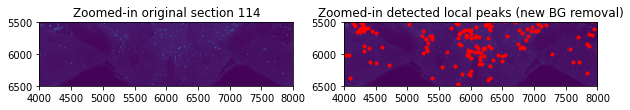

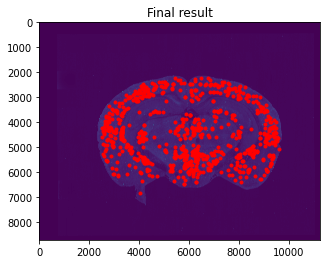

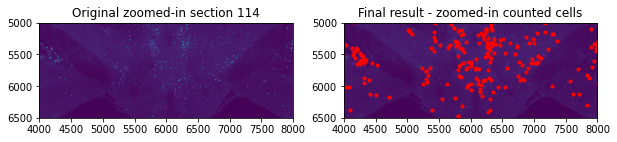

Number of detected cells: 795 


115 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0116_1_0.tif


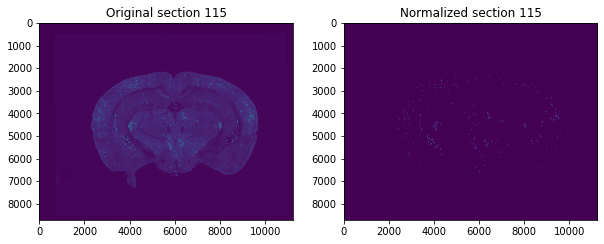

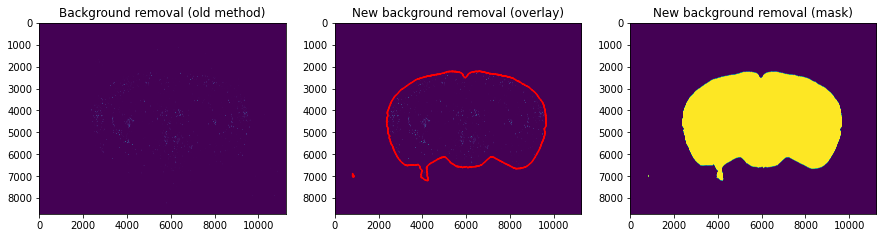

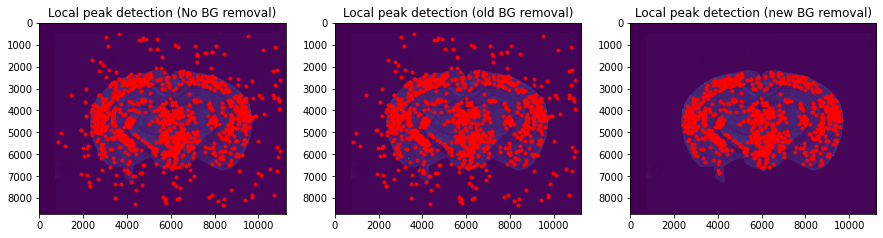

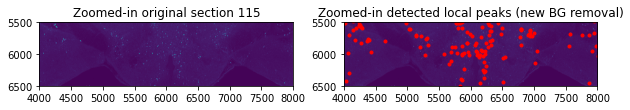

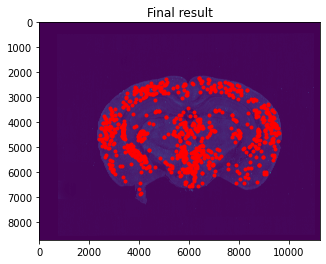

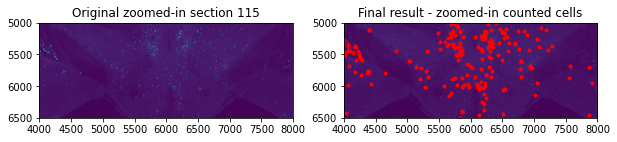

Number of detected cells: 833 


116 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0117_1_0.tif


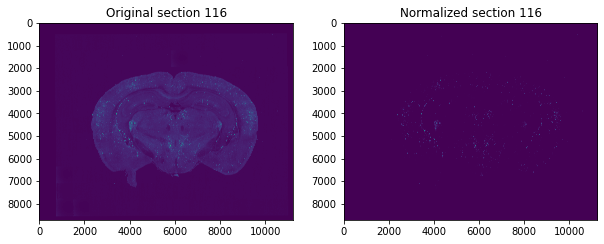

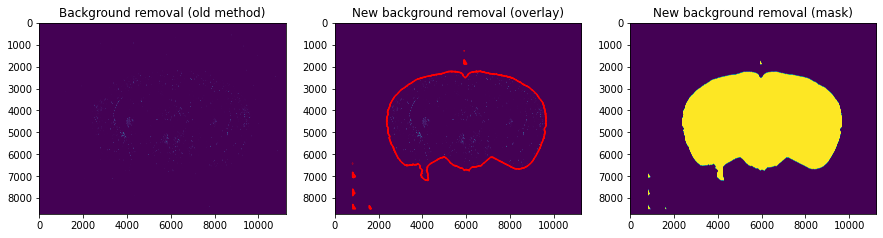

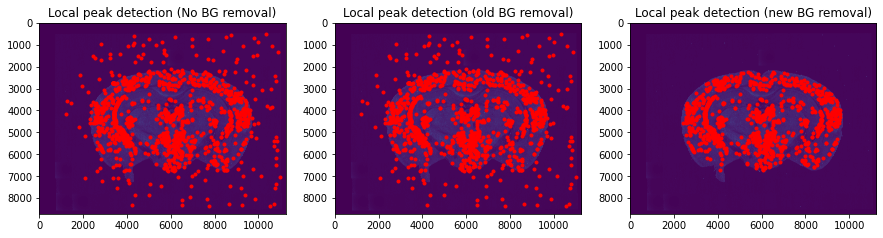

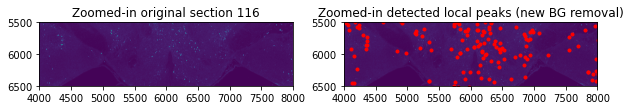

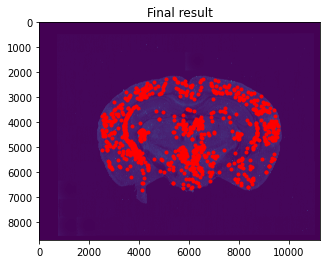

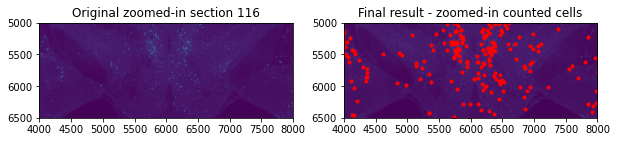

Number of detected cells: 860 


117 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0118_1_0.tif


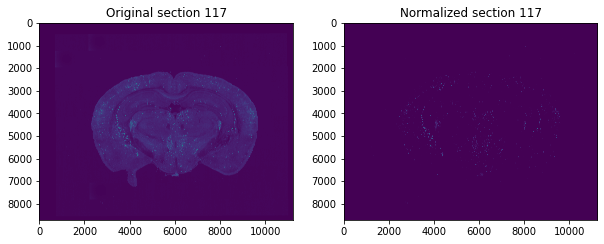

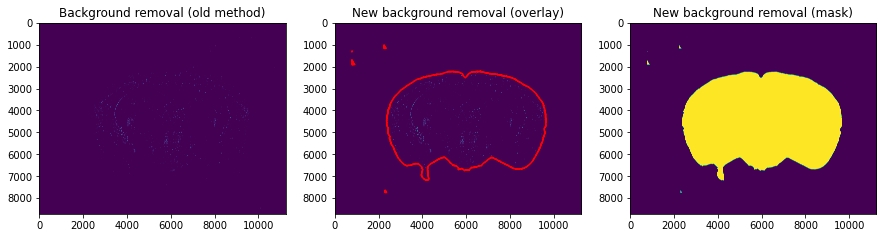

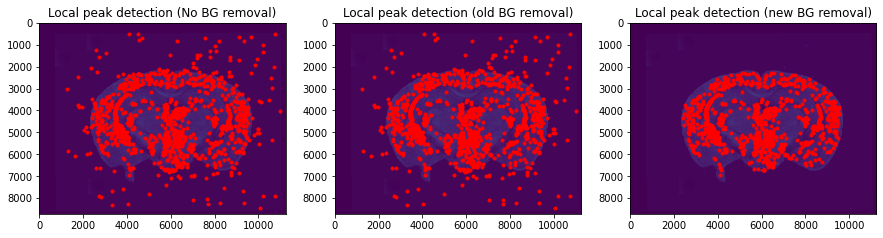

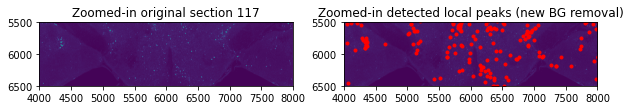

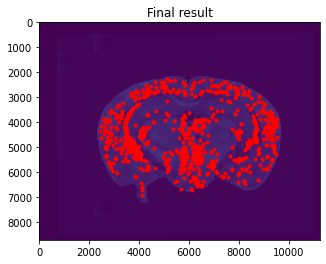

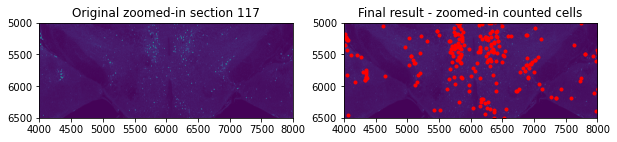

Number of detected cells: 885 


118 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0119_1_0.tif


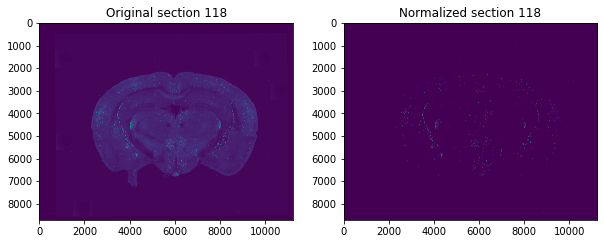

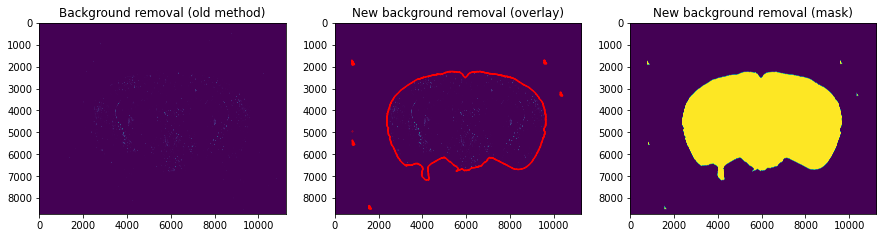

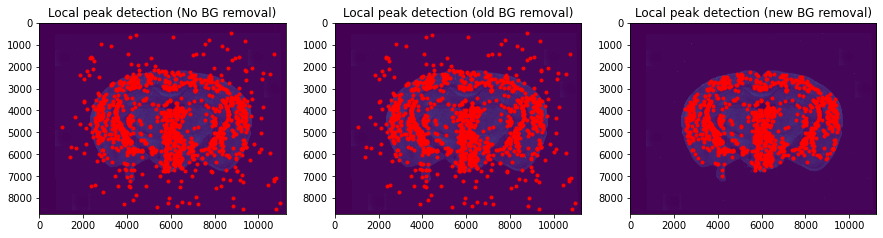

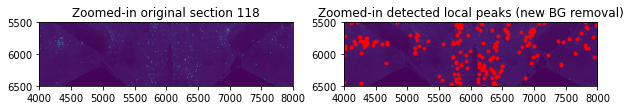

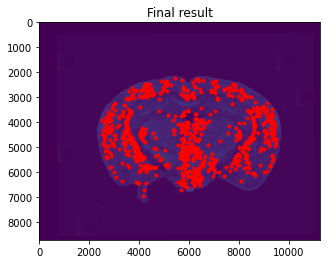

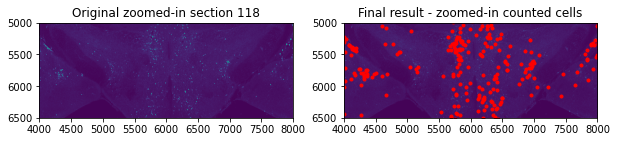

Number of detected cells: 904 


119 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0120_1_0.tif


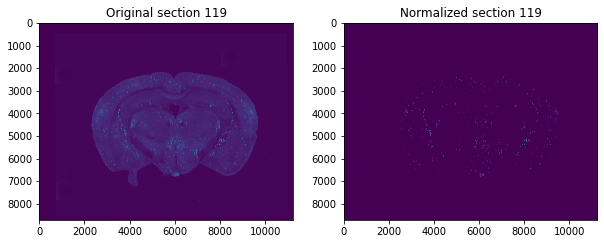

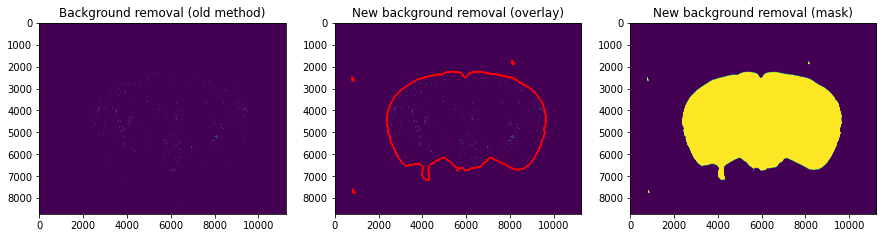

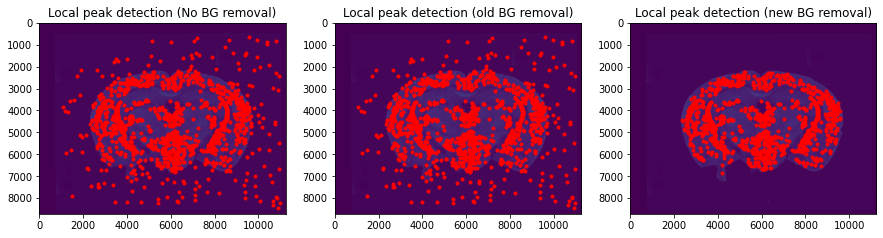

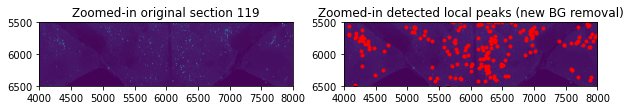

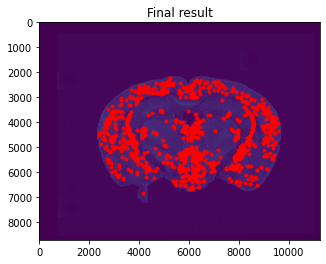

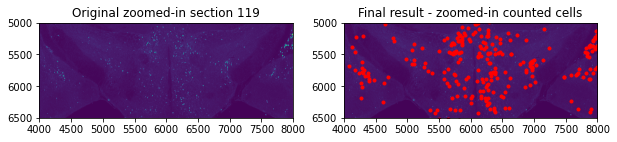

Number of detected cells: 957 


120 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0121_1_0.tif


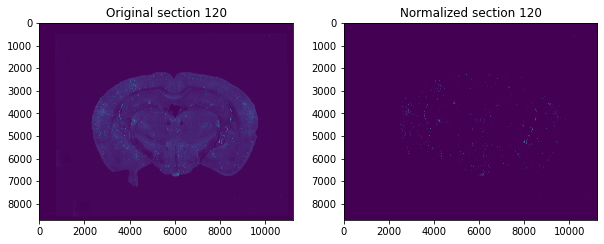

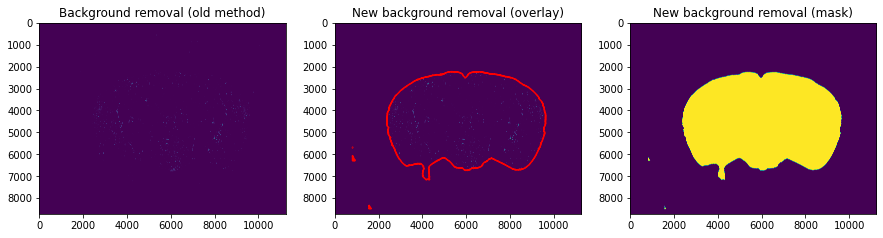

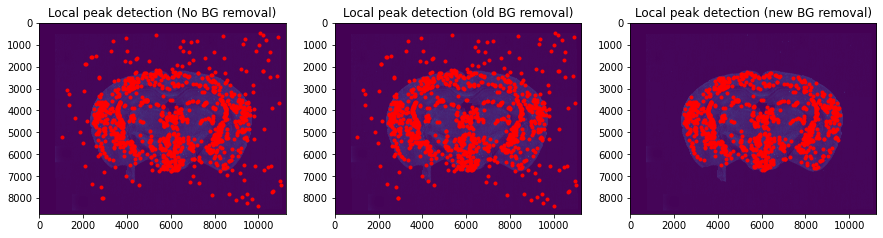

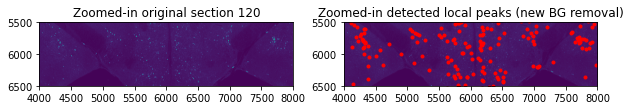

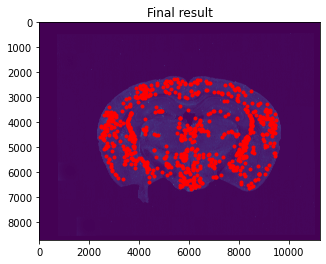

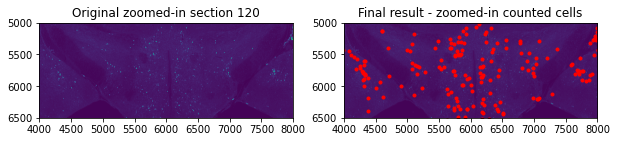

Number of detected cells: 779 


121 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0122_1_0.tif


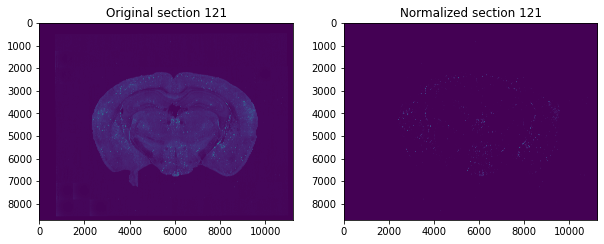

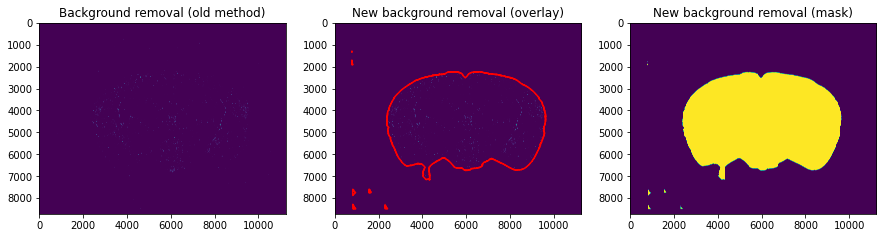

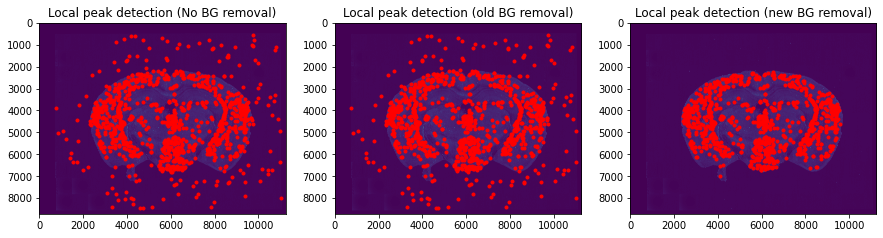

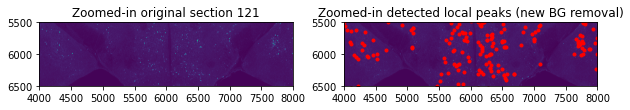

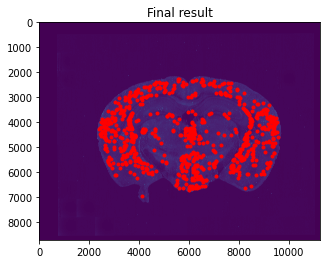

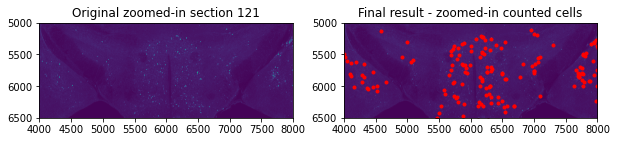

Number of detected cells: 788 


122 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0123_1_0.tif


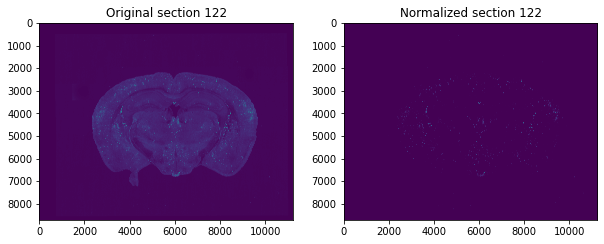

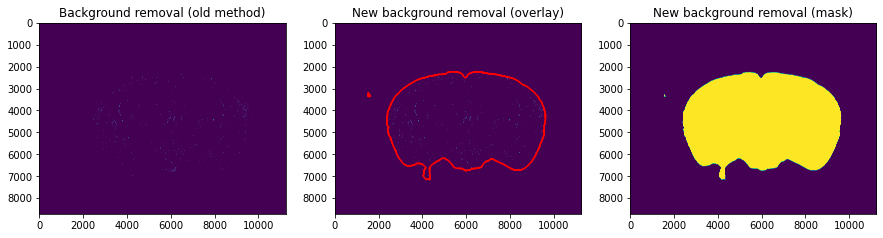

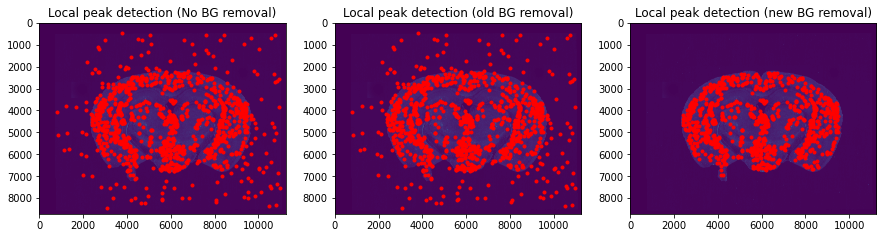

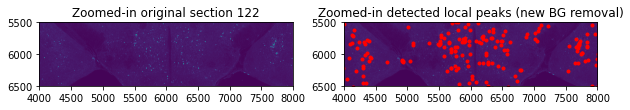

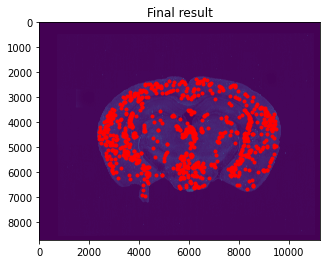

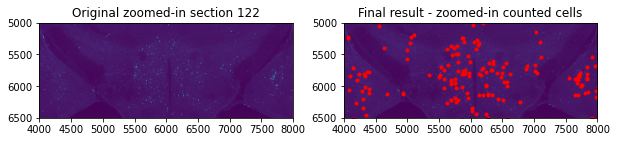

Number of detected cells: 810 


123 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0124_1_0.tif


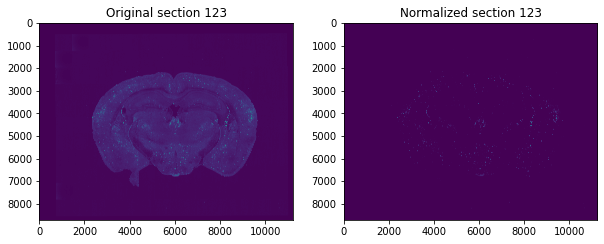

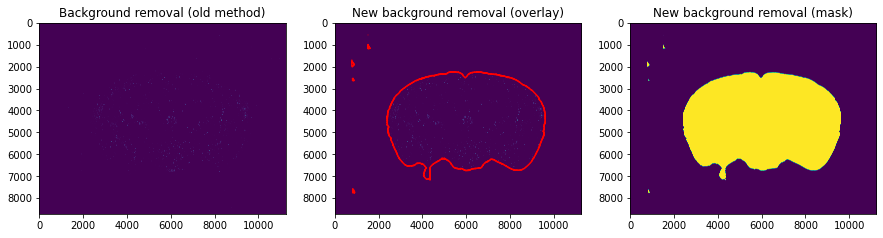

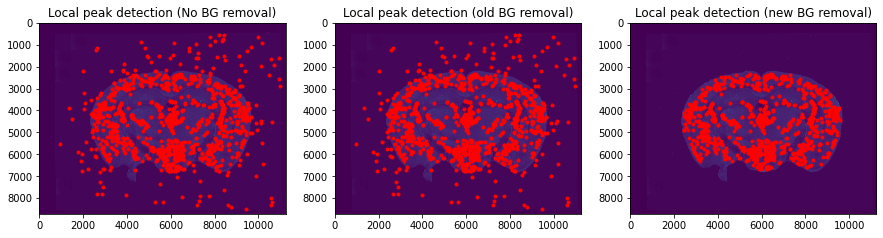

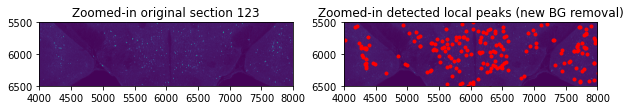

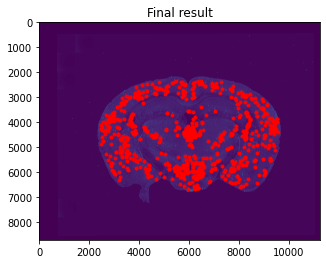

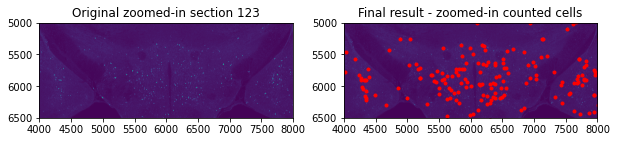

Number of detected cells: 748 


124 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0125_1_0.tif


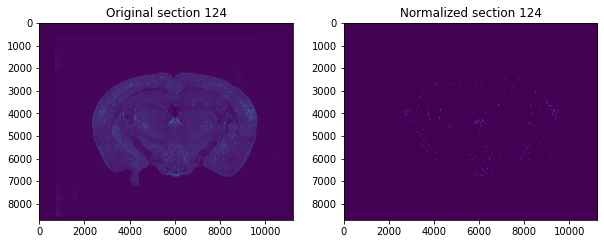

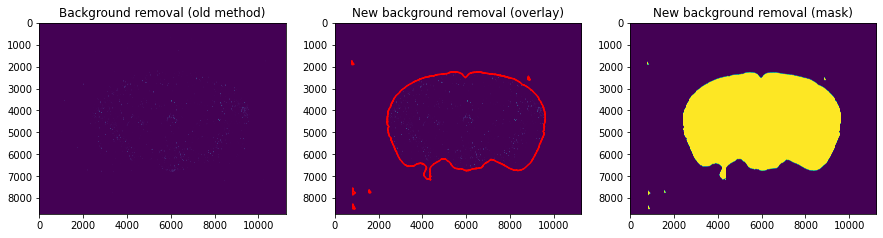

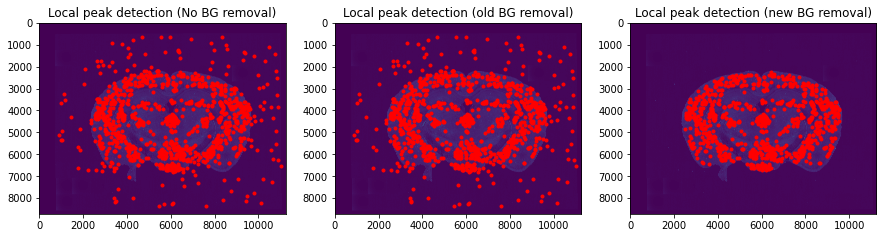

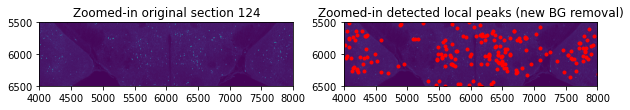

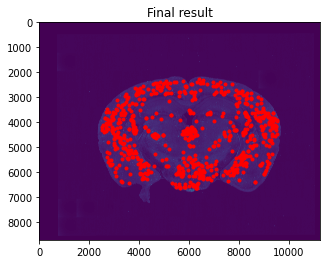

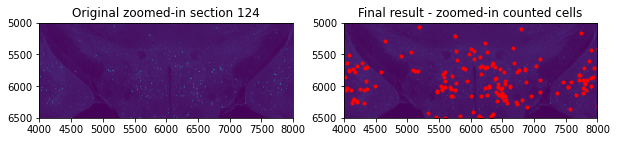

Number of detected cells: 752 


125 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0126_1_0.tif


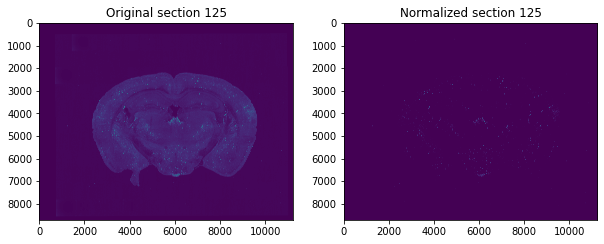

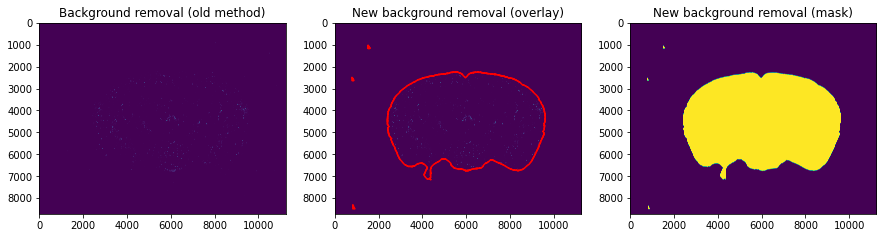

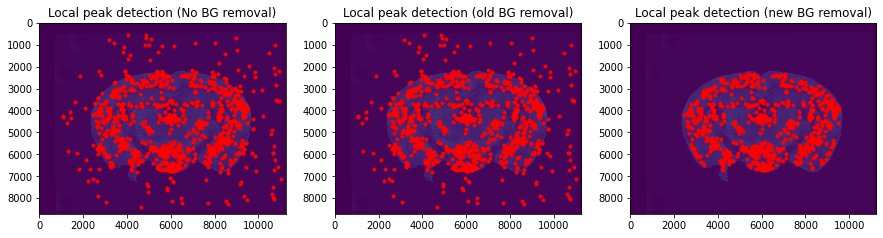

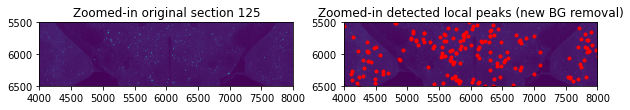

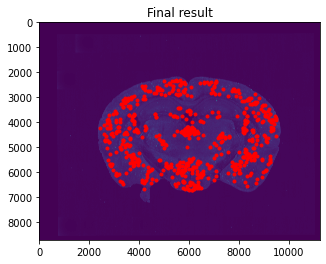

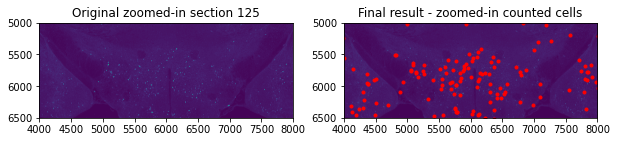

Number of detected cells: 663 


126 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0127_1_0.tif


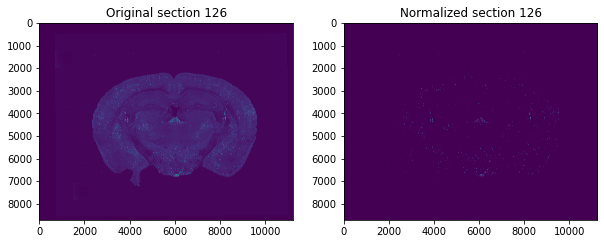

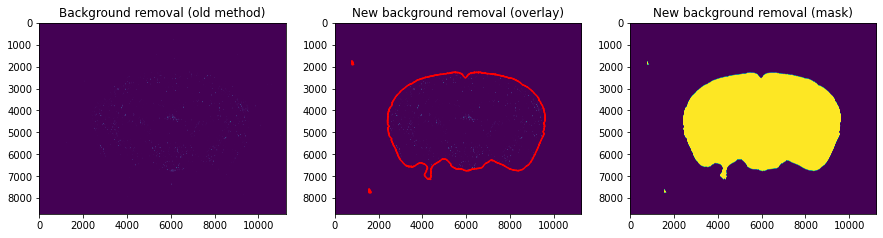

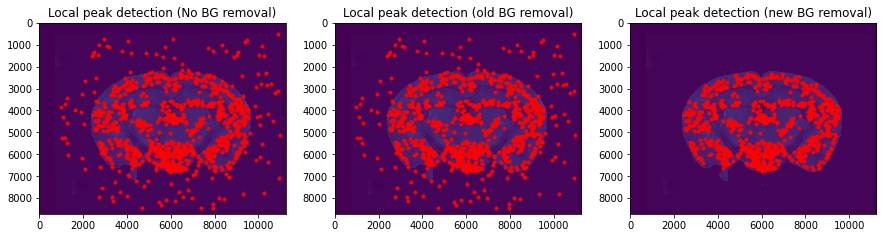

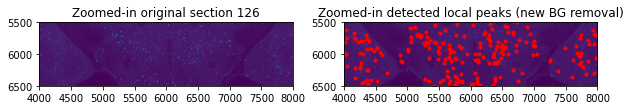

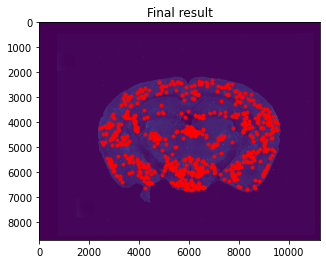

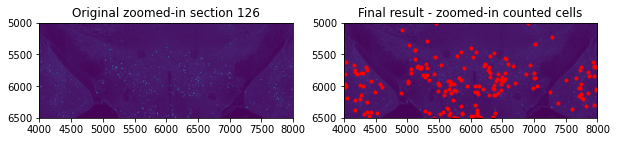

Number of detected cells: 699 


127 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0128_1_0.tif


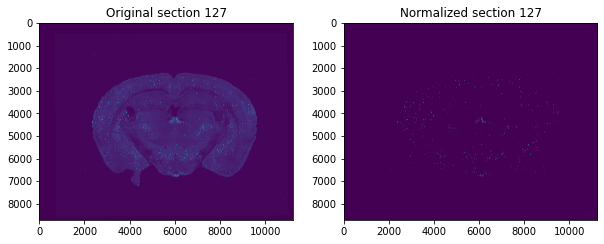

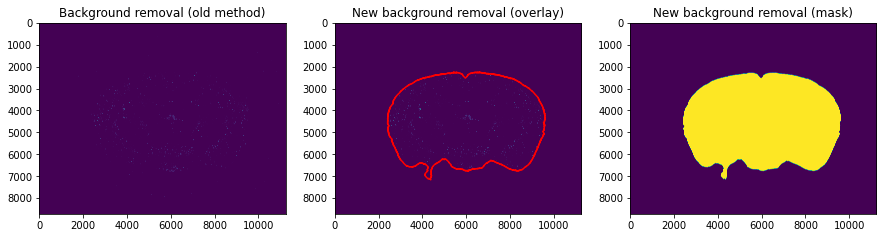

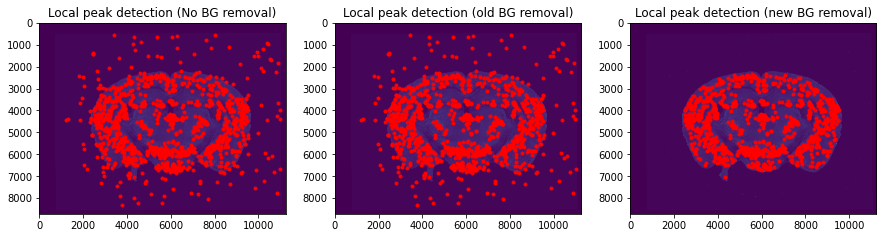

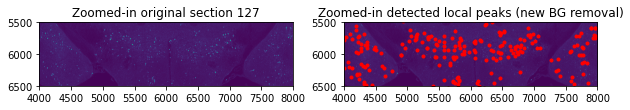

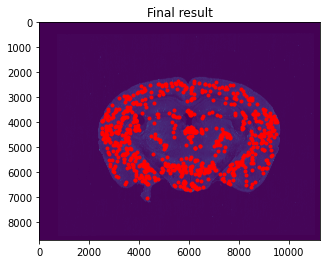

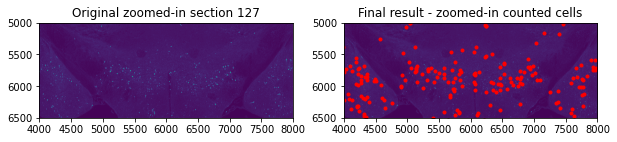

Number of detected cells: 807 


128 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0129_1_0.tif


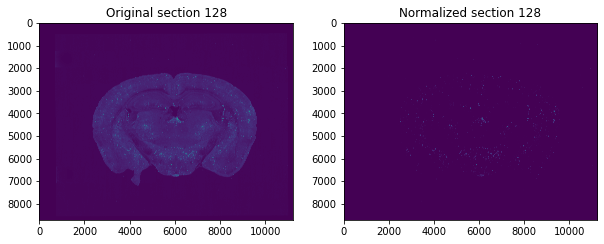

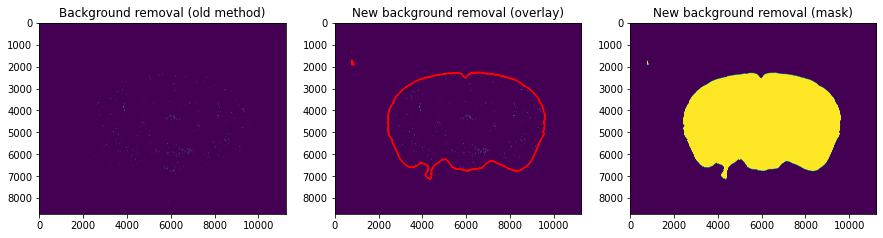

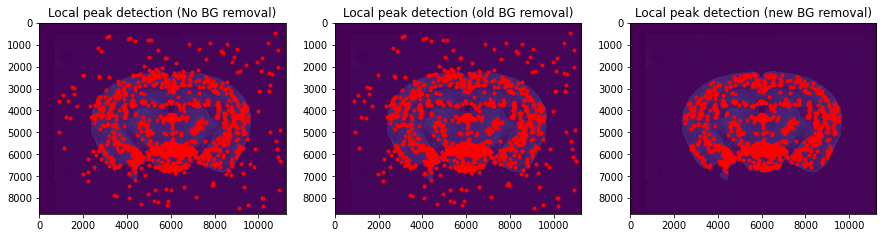

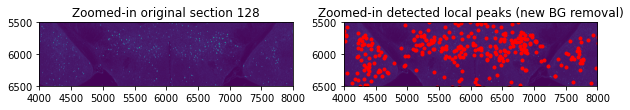

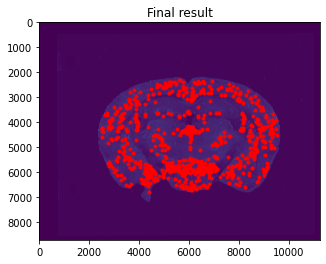

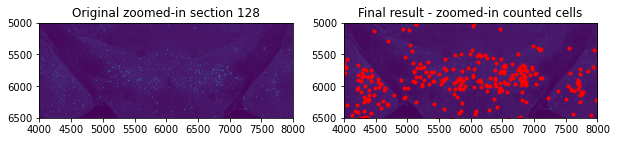

Number of detected cells: 793 


129 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0130_1_0.tif


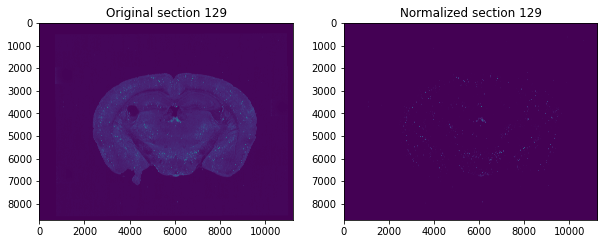

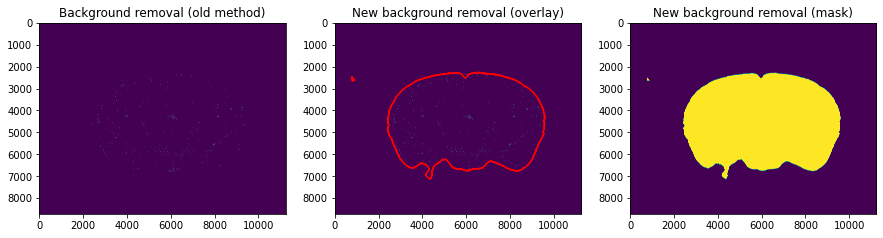

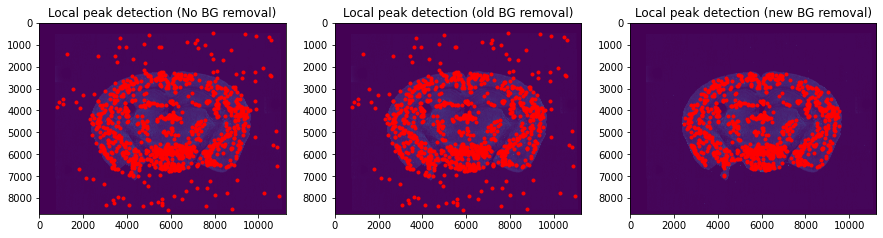

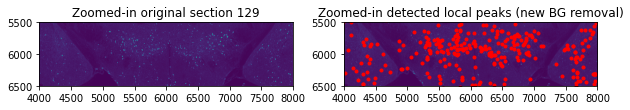

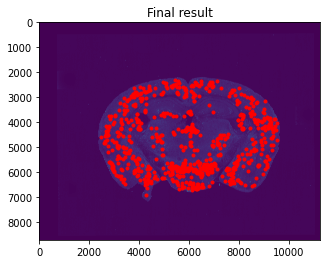

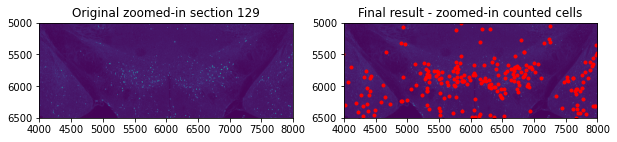

Number of detected cells: 772 


130 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0131_1_0.tif


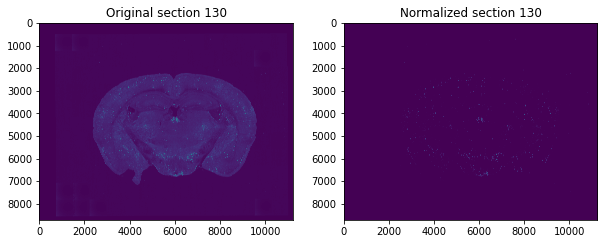

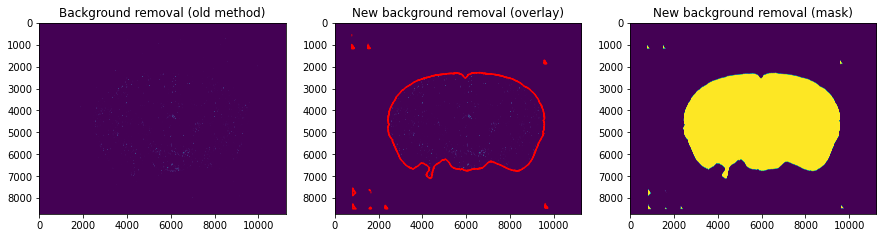

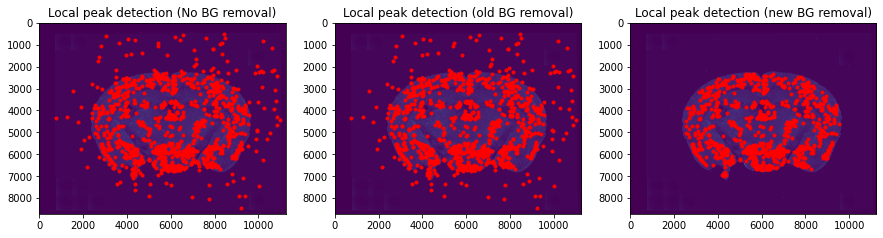

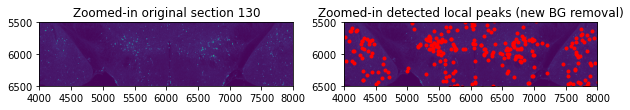

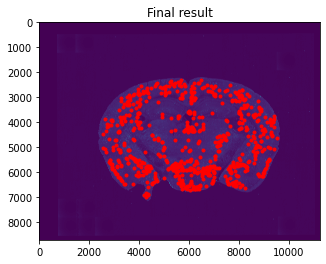

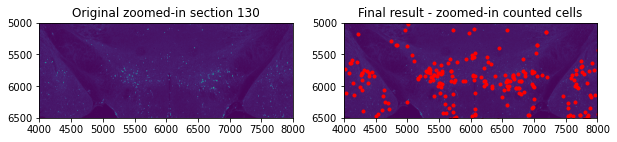

Number of detected cells: 744 


131 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0132_1_0.tif


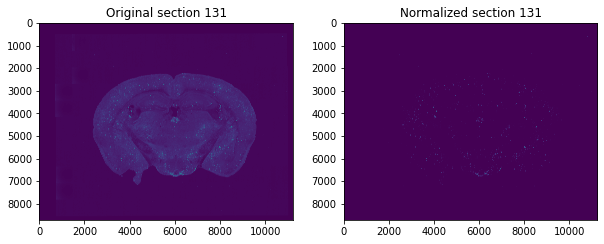

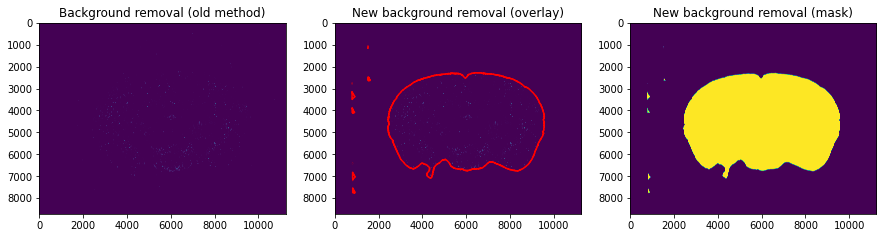

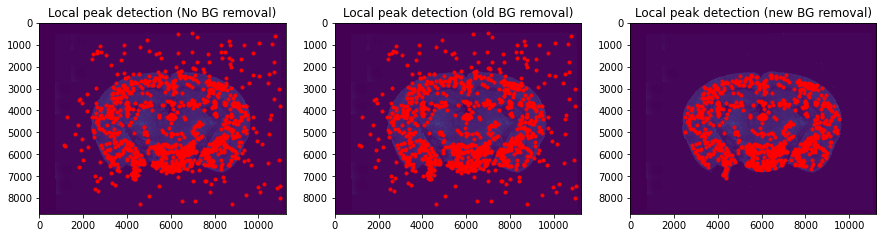

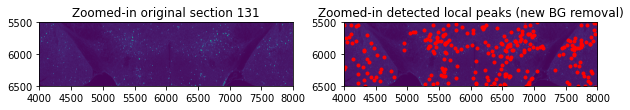

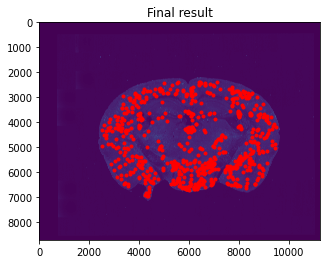

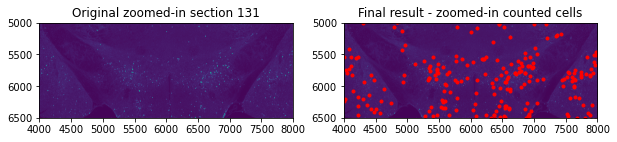

Number of detected cells: 696 


132 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0133_1_0.tif


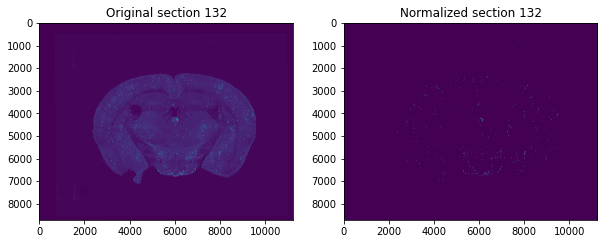

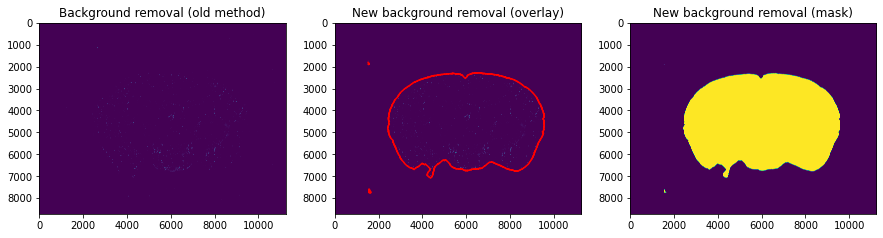

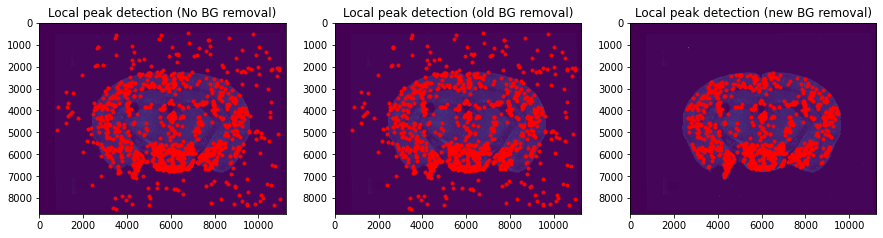

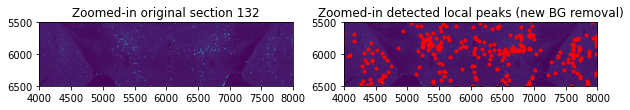

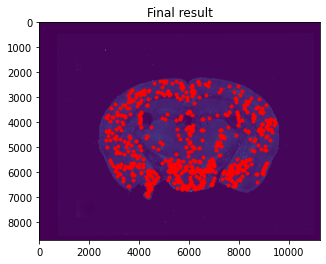

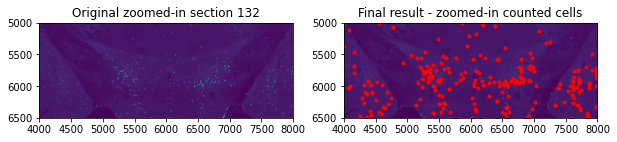

Number of detected cells: 697 


133 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0134_1_0.tif


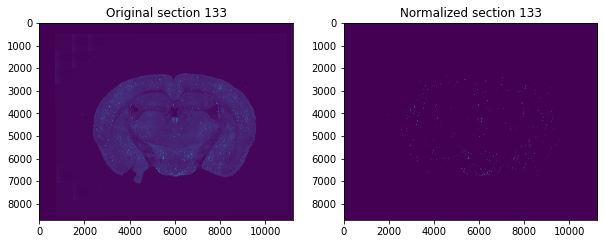

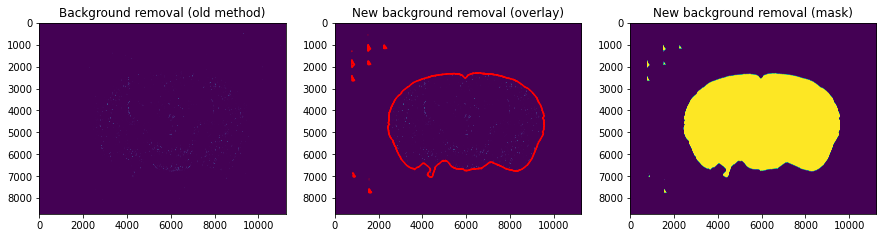

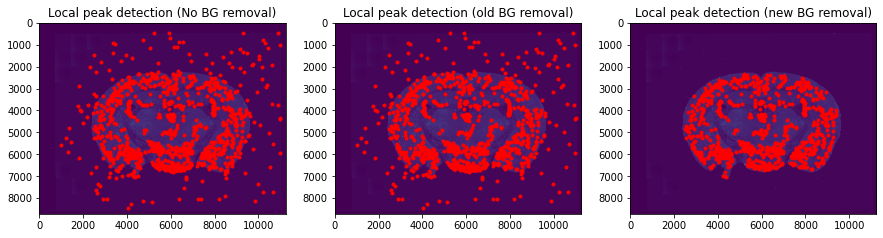

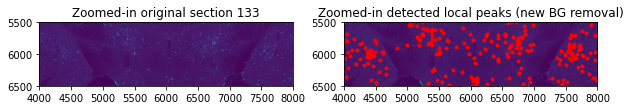

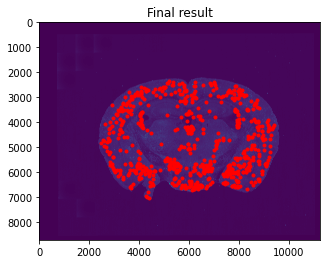

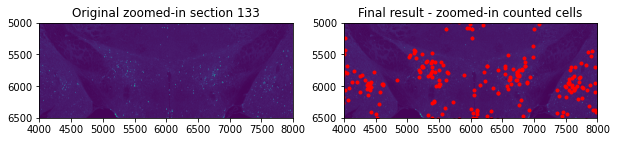

Number of detected cells: 698 


134 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0135_1_0.tif


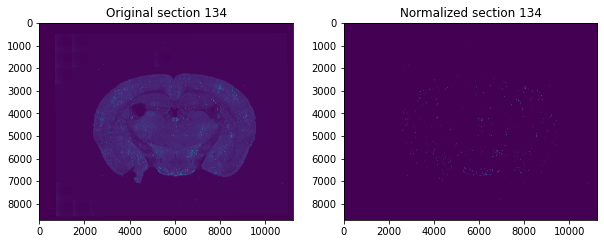

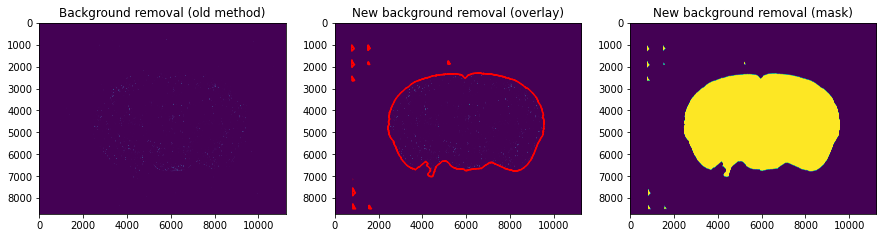

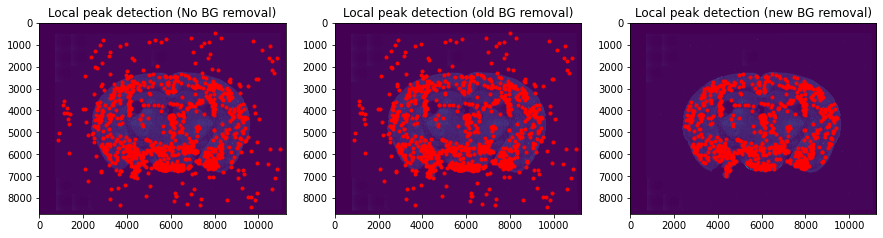

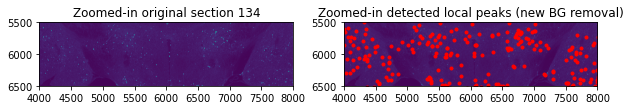

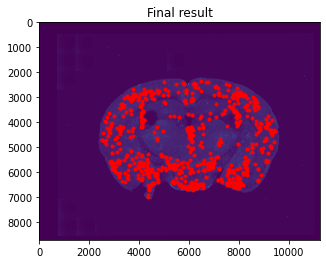

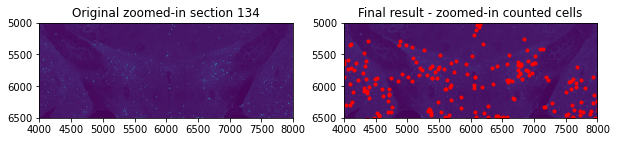

Number of detected cells: 668 


135 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0136_1_0.tif


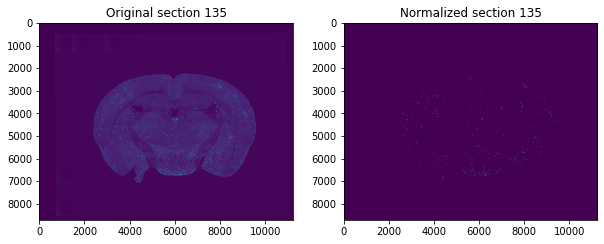

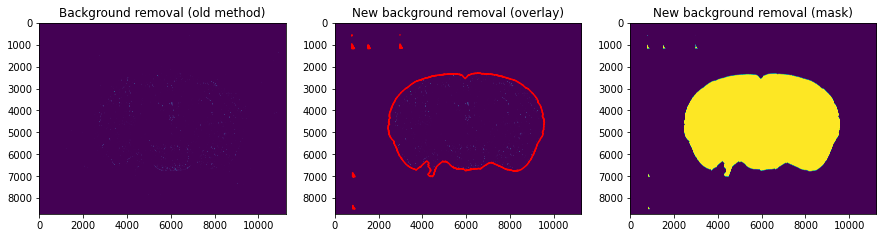

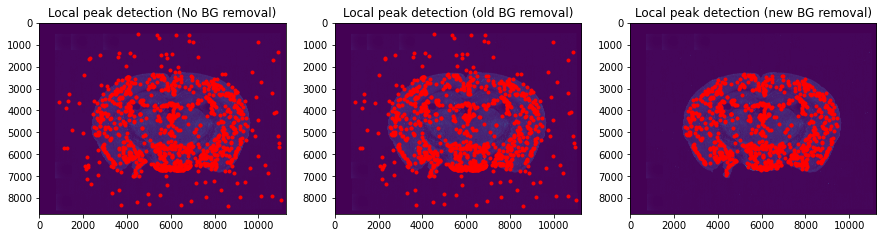

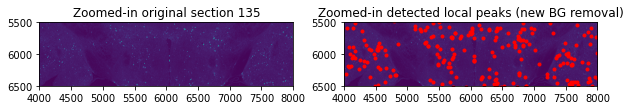

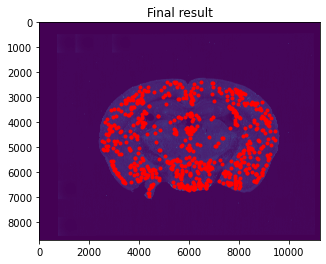

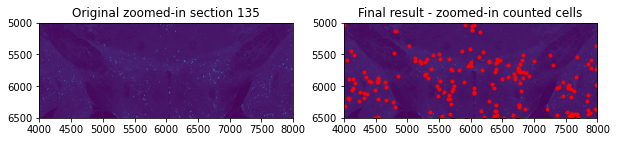

Number of detected cells: 680 


136 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0137_1_0.tif


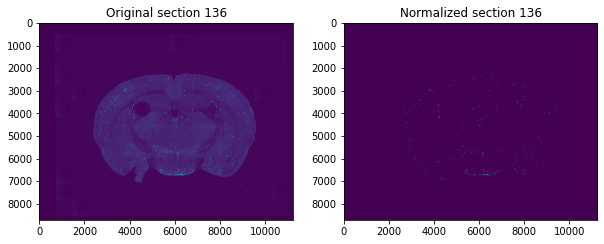

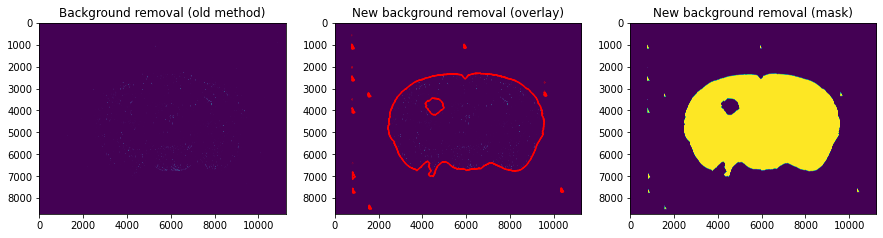

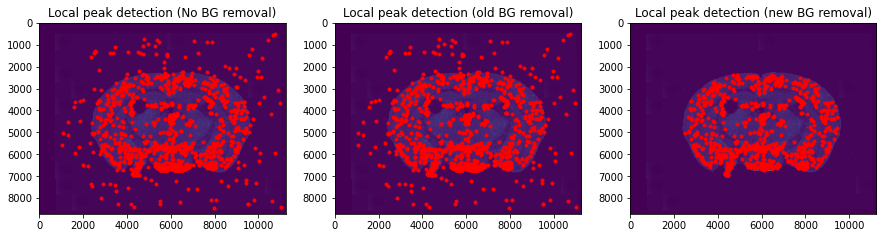

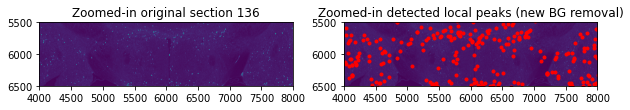

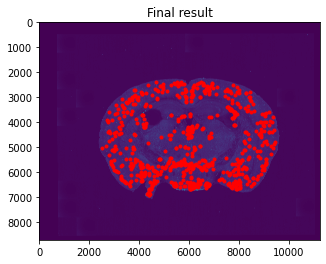

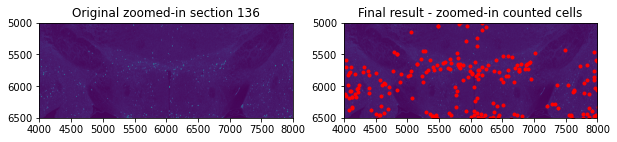

Number of detected cells: 684 


137 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0138_1_0.tif


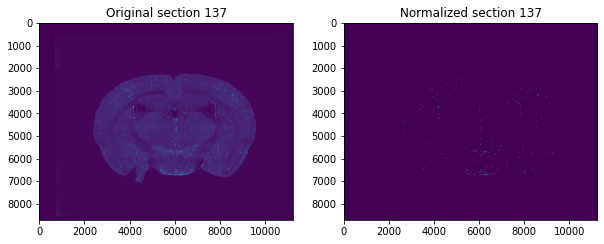

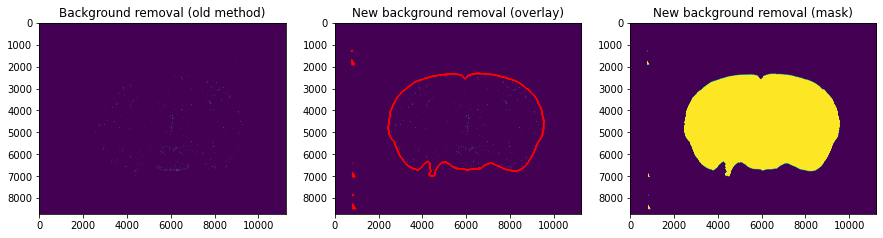

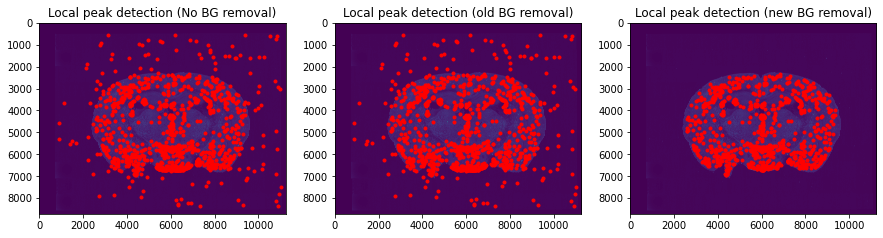

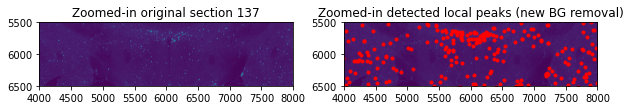

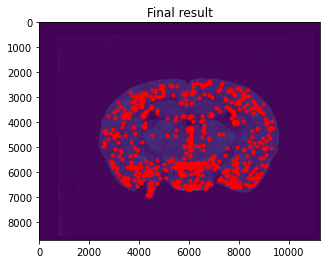

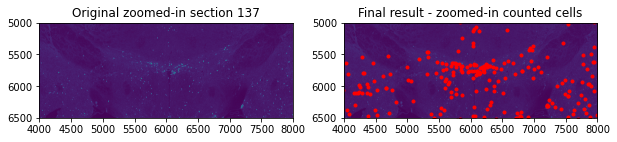

Number of detected cells: 687 


138 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0139_1_0.tif


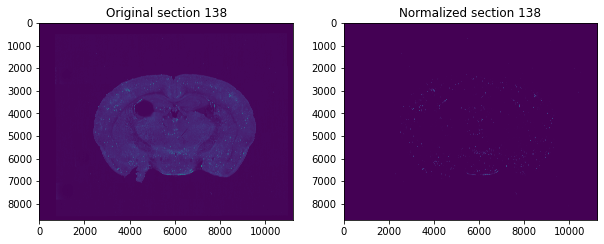

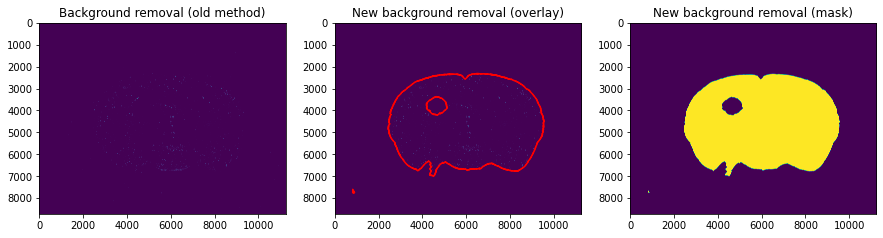

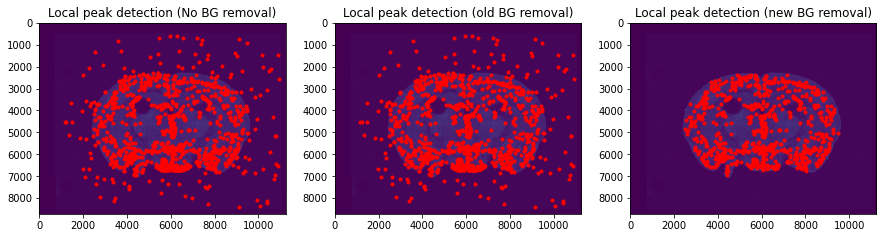

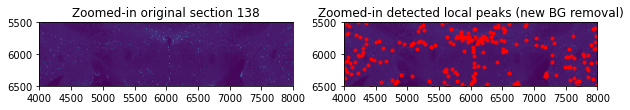

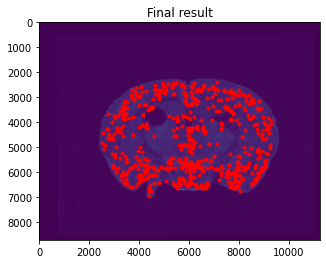

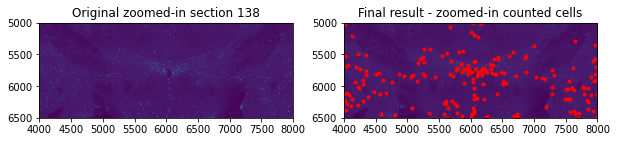

Number of detected cells: 668 


139 G:/GitHub/u01-data/B0070\median_mask_stitched_ch0\231023_B0070_MR-0140_1_0.tif


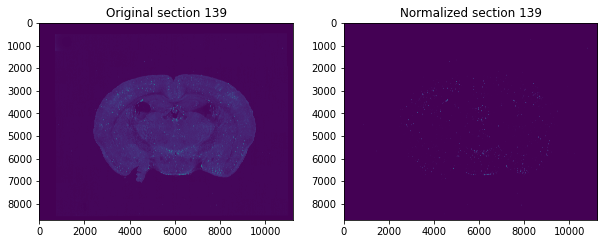

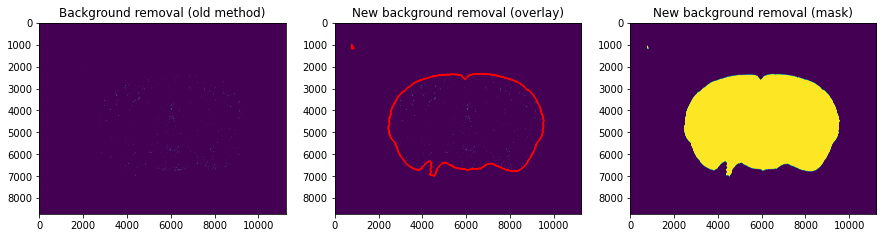

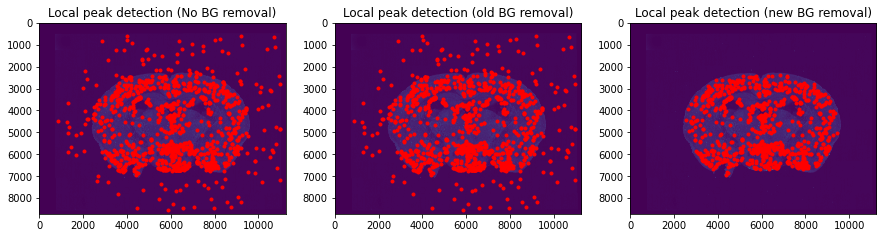

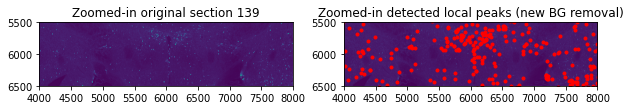

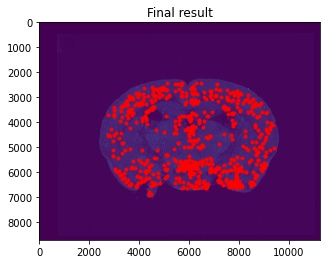

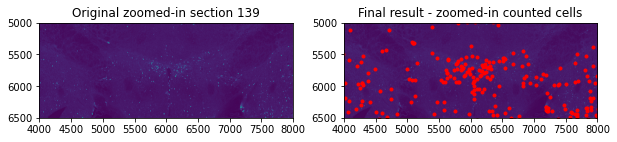

Number of detected cells: 681 

Cell detection done in 4796.223276138306 seconds.
Average processing time: 34.25873768670218 seconds per section


In [21]:
##########################################################################################################

# Settings
img_dir = "G:/GitHub/u01-data/B0070/"
input_points_file = img_dir + "/counting/inputpoints.txt"
input_points_file_scaled = img_dir + "/counting/inputpoints_scaled.txt"
threshold = 3  # Intensity threshold for cell detection (default 10)
               # B0070: default 3
size_threshold = 10  # Minimum cell size for cell detection (try 25 as default)
                     # B0070: default 10
channel = 0

# Background removal
THRESH = 15
y = 8716
x = 11236
MIN_SIZE = max(64, int(max(y, x) * 0.20))      # Largest allowable size for specks
AREA_THRESHOLD = max(64, int(max(y, x) * 20))  # Fill in holes smaller than this size
DILATION_ITER = int(max(y, x) / 500)           # 20

# Temporary image path solution for kiwi server
if sys.platform == 'linux':
    imgfiles = natsorted(glob.glob(img_dir + "/*-{}.tif".format(channel), recursive=True))
else:
    imgfiles = natsorted(glob.glob(img_dir + "/**/*1_{}.tif".format(channel), recursive=True))

# Detect cells for all sections
start = time.time()
cells = []
for i, img_file in enumerate(imgfiles):
    print("\n" + str(i), img_file)
    image = readSectionTif(img_file)
    image[image<0] = 0
    c = get_cell_locations2(img_file, index = i, 
                            intensity_threshold = threshold, size_threshold = size_threshold)
    cells.append(c)
    #break
end = time.time()


cell_locations = np.vstack(cells)
cell_locations[:,0] = len(imgfiles) - cell_locations[:,0] - 1
#cell_locations[:,0] = mData.shape[0] - cell_locations[:,0]-1


# points = cell_locations
# createShardedPointAnnotation(points,img_dir) # Create sharded points for Neuroglancer layer
# Scale cell locations to smaller registered version
scaledCellLocations = np.round(cell_locations * [1, 1/20,1/20]).astype(int)
np.savetxt(input_points_file, cell_locations , "%d %d %d", 
           header = "index\n" + str(cell_locations.shape[0]), 
           comments = "")
np.savetxt(input_points_file_scaled, scaledCellLocations , "%d %d %d", 
           header = "index\n" + str(cell_locations.shape[0]), 
           comments = "")
print("Cell detection done in {} seconds.".format(end - start))
print("Average processing time: {} seconds per section".format((end - start) / len(imgfiles)))

def get_cell_locations(img, intensity_threshold = 5, min_distance = 5, size_threshold = 15, index = None):
    """
    img : 2d Image array or img_path
    intensity_threshold: backgound intensity in 0 to 255 scale
    size_threshold : Minimum cell size
    min_distance: Minimum distance between two cell centers
    
    index : Cell z index
    """
    
    if type(img) == str:
        img = readSectionTif(img)
        
    # Show the original section
    plt.title("Original section")
    plt.imshow(auto_contrast(img, alpha=0.25))
    plt.show()
        
    # Normalize the section to highlight larger values
    section = (img/np.iinfo(img.dtype).max)*255
    section = section.astype(np.uint8)
    plt.title("Section")
    #plt.imshow(section)
    plt.imshow(auto_contrast(section, alpha=20))
    plt.show()
    
    # Remove the background
    bg = remove_background(section)
    plt.title("Background removal")
    #plt.imshow(bg)
    plt.imshow(auto_contrast(bg, alpha=20))
    plt.show()
    
    # Local peak detection
    peaks = peak_local_max(bg, min_distance=min_distance, threshold_abs=intensity_threshold)
    plt.title("Local peak detection")
    plt.imshow(auto_contrast(img, alpha=0.25))
    plt.plot(peaks[:, 1], peaks[:, 0], 'r.')
    plt.show()

    # Create a mask from the local peak coordinates for watershed and use for size detection
    mask = np.zeros(bg.shape)
    mask[tuple(peaks.T)] = True
    markers, _ = scipy.ndimage.label(mask)
    #print("Size Detection")
    watershed_mask = bg > intensity_threshold
    labels = watershed(-bg, markers, mask = bg > intensity_threshold)
    plt.title("Watershed segmentation")
    plt.imshow(labels)
    plt.show()

    # Compute the center of mass of each cell
    centers = np.array(scipy.ndimage.center_of_mass(bg, labels, index=np.arange(1, np.max(labels) + 1)))
    centers = centers.astype(int)

    # Filter out small cells
    sizes = scipy.ndimage.sum(np.ones(labels.shape, dtype=bool), labels=labels, index=np.arange(1, np.max(labels) + 1))
    cells = centers[sizes >= size_threshold]
    
    if index is not None:
        cells = np.hstack([np.zeros((cells.shape[0], 1)) + index, cells])
        
    # Show final result
    plt.title("Final result")
    plt.imshow(auto_contrast(img, alpha=0.25))
    plt.plot(cells[:, 2], cells[:, 1], 'r.')
    plt.show()
    print("Detected cells:")
    pprint(cells)
    
    return cells

##########################################################################################################

# Settings
img_dir = "G:/GitHub/u01-data/B0070/"
input_points_file = img_dir + "/counting/inputpoints.txt"
threshold = 10
channel = 0

# Temporary image path solution for kiwi server
if sys.platform == 'linux':
    imgfiles = natsorted(glob.glob(img_dir + "/*-{}.tif".format(channel), recursive=True))
else:
    imgfiles = natsorted(glob.glob(img_dir + "/**/*1_{}.tif".format(channel), recursive=True))

# Detect cells for all sections
start = time.time()
cells = []
for i, img_file in enumerate(imgfiles):
    print("\n" + str(i), img_file)
    c = get_cell_locations(img_file, index = i, intensity_threshold = threshold)
    cells.append(c)
end = time.time()

cell_locations = np.vstack(cells)

cell_locations[:,0] = len(imgfiles) - cell_locations[:,0] - 1
#cell_locations[:,0] = mData.shape[0] - cell_locations[:,0]-1


# points = cell_locations
# createShardedPointAnnotation(points,img_dir) # Create sharded points for Neuroglancer layer
# Scale cell locations to smaller registered version
scaledCellLocations = np.round(cell_locations*[ 1, 1/20,1/20]).astype(int)
np.savetxt(input_points_file, scaledCellLocations , "%d %d %d", header = "index\n"+str(cell_locations.shape[0]), comments = "")
print("Cell detection done in {} seconds.".format(end - start))
print("Average processing time: {} seconds per section".format((end - start) / len(imgfiles)))

"""
#!/usr/bin/env python
# -*- coding: utf-8 -*-
Atchuth Naveen
Code developed at UC Irvine.

Utility file to create NII image volumes, perform registration, cell counting, cell region detection. 
"""
import scipy.io
import numpy as np
import subprocess
import argparse 
import os
import sys
import nibabel as nib
from collections import Counter
import pandas as pd
from tempfile import mkstemp
from shutil import move, copymode
from os import fdopen, remove
from cellAnalysis.cell_counting import *
from cellAnalysis.cell_detection import *
#from registration.reconstruction import *
#import registration as rg
import shutil
from tqdm import tqdm
import time
import matplotlib.pyplot as plt
from scipy.ndimage import affine_transform, geometric_transform
#from registration.reg_utils import loadNiiImages



def get_input_cell_locations(input_mat):
    mat = scipy.io.loadmat(input_mat)
    location_arr  = mat['location'][0]
    prediction_arr = mat['predictions'][0]
    cell_locations = []
    for i in range(location_arr.shape[0]):
        location = location_arr[i]
        prediction = prediction_arr[i]
        location = np.squeeze(location)
        prediction = np.squeeze(prediction)
        if(len(location) ==0):
            continue
        true_locations = location.T[prediction!=2]
        print(true_locations.shape)
        true_locations = np.hstack((true_locations, np.zeros((true_locations.shape[0],1))+i))
        cell_locations.append(true_locations)
    cell_locations = np.vstack(cell_locations) 
    return cell_locations

def replaceBSplineOrder(file_path):
    #Create temp file
    fh, abs_path = mkstemp()
    with fdopen(fh,'w') as new_file:
        with open(file_path) as old_file:
            for line in old_file:
                if "FinalBSplineInterpolationOrder" in line:
                    new_file.write("(FinalBSplineInterpolationOrder 0)\n")
                else:
                    new_file.write(line)
    #Copy the file permissions from the old file to the new file
    copymode(file_path, abs_path)
    #Remove original file
    remove(file_path)
    #Move new file
    move(abs_path, file_path)

def parsePhysicalPointsFromOutputFile(transformixOutFile):
    """
    Parses Transformix Output file and stores the physical point location

    Parameters
    ----------
    transformixOutFile  : Path to transformix output file
    """
    outputPoints=[]

    with open(transformixOutFile, "r") as f:
        for line in f:
            line = line.split(";")
            outputPoint  = [float(x) for x in line[4].split()[3:6]]
            outputPoints.append(outputPoint)
    outputPoints= np.asarray(outputPoints)
    return outputPoints

def convertPhysicalPointsToIndex(outputPoints, annDataImage):
    outputIndices=[]
    for point in outputPoints:
        index = annDataImage.TransformPhysicalPointToIndex(point)
        outputIndices.append(index)
    return outputIndices

def countCellsInRegions(outputIndices, annDataImage):
    """
    Parameters:
    -----------
    outputIndices : list of tuples, each tuple is a index location
    annDataImage : sitkImage
    """
    region_ids =[]
    points =[]
    exterior_points =0
    for i,point in enumerate(outputIndices):
        try:
            point = np.asarray(point).astype(np.uint16)
            if(np.sum(point<0)!=0):
                continue

            sx, sy, sz = annDataImage.GetSize()

            if(point[1] >= sy or point[2] >= sz or point[0]>= sx):
                exterior_points = exterior_points+1
                continue

            if annDataImage.GetPixel(int(point[0]), int(point[1]), int(point[2]))>=1:
                region_ids.append(int(annDataImage.GetPixel(int(point[0]), int(point[1]), int(point[2]))))
                points.append(i)
        except Exception as e:
            print(e)
            print(i, point)
    cell_counts = Counter(region_ids)
    print("Exterior Points :{}".format(exterior_points))
    return cell_counts, np.asarray(points)

def loadTransformMapping(fshape, mshape,regDir):
    """
    Returns the mapping of shape fshapex3. 
    For each voxel located at x,y,z in fdata, the 1x3 cell represents the x_,y_,z_ in mdata. 
    """
    
    mx, my, mz = mshape
    fx, fy, fz = fshape
    
    #Sample volumes that represent the coordinate of the voxel
    X, Y,Z= np.meshgrid(range(mx), range(my), range(mz), indexing = 'ij')
    X =X.astype(float)
    Y =Y.astype(float)
    Z= Z.astype(float)
    
    
    A = np.load(os.path.join(regDir,"axisAlignA.npy"))
    alignedX = affine_transform(X,np.linalg.inv(A), output_shape = X.shape, order =1)
    alignedY = affine_transform(Y,np.linalg.inv(A), output_shape = Y.shape, order =1)
    alignedZ = affine_transform(Z,np.linalg.inv(A), output_shape = Z.shape, order =1)
    alignedXPath = os.path.join(regDir, "alignX.nii.gz")
    alignedYPath = os.path.join(regDir, "alignY.nii.gz")
    alignedZPath = os.path.join(regDir, "alignZ.nii.gz")
    
    create_nifti_image(alignedX, 2.5, alignedXPath, 1)
    create_nifti_image(alignedY, 2.5, alignedYPath, 1)
    create_nifti_image(alignedZ, 2.5, alignedZPath, 1)

    elastixX =  rg.elastixTransformation(alignedXPath, regDir, os.path.join(regDir, "elastixX"))
    elastixY =  rg.elastixTransformation(alignedYPath, regDir, os.path.join(regDir, "elastixY"))
    elastixZ =  rg.elastixTransformation(alignedZPath, regDir, os.path.join(regDir, "elastixZ"))

    deformationField = np.load(os.path.join(regDir,"deformation3d.npy"))
    finalX   = rg.applyDeformationField(elastixX , deformationField)
    finalY   = rg.applyDeformationField(elastixY , deformationField)
    finalZ   = rg.applyDeformationField(elastixZ , deformationField)
    
    mapping = np.zeros((fx,fy,fz,3))
    mapping[:,:,:, 0] = finalX

    mapping[:,:,:, 1] = finalY

    mapping[:,:,:, 2] = finalZ
    mapping[mapping<0] = 0
    
    #Remove all junk files
    os.remove(os.path.join(regDir, "alignX.nii.gz"))
    os.remove(os.path.join(regDir, "alignY.nii.gz"))
    os.remove(os.path.join(regDir, "alignZ.nii.gz"))
    shutil.rmtree(os.path.join(regDir, "elastixX"))
    shutil.rmtree(os.path.join(regDir, "elastixY"))
    shutil.rmtree(os.path.join(regDir, "elastixZ"))
    
    return mapping      

def getMappedIndices(points, mapping):
    """
    To be used in conjunction with loadTransformMapping

    point - px3 np array p is the number of points

    mapping- nxwxhx3 np array
    
    """
    mint = mapping.astype(int)
    mappedIndices =[]
    for point in tqdm(points):
        try:
            x,y,z = point
            x_,y_,z_ = np.where(np.bitwise_and(np.bitwise_and(mint[:,:,:,0]==x, mint[:,:,:,1]==y), mint[:,:,:,2]==z))
            if(len(x_) ==0 ):
                mappedIndices.append([0,0,0])
                #mnorm  = np.linalg.norm(mapping - np.reshape(point, (1,1,1,3)), axis=3)
                #x_,y_,z_ = np.where(mnorm == np.min(mnorm))
            else:
                mappedIndices.append([x_[0],y_[0],z_[0]])
            #region_ids.append(stats.mode(anndata[indices[0], indices[1], indices[2]], keepdims=False).mode)
        except Exception as e:
            print("Exception at Mapping Indices for point {}".format(point))
    return mappedIndices

if __name__ == '__main__':
    """
    This script can generate nii files and perform registration as well as use existing nii files for registration. 
    
    If --img_dir is provided, the script creates nii files according to the channel specified and use them for registration.

    If --img_dir is not provided, then script takes additional arguments --fixed_image, --moving_image. 

    In addition output_dir can be specified to store all intermediary and final results. 

    For performing cell detection and cell counting, additional arguments '--cell_detection' needs to be given. For cell detection, '--img_dir' is a required argument. 
    Threshold can be adjusted for cell counting with argument '--threshold'

    --input_mat is only present for legacy reasons and can be ignored. 
    """
    parser = argparse.ArgumentParser()
    parser.add_argument('--img_dir', type=str, default="", help = "Path to image directory containing stitiched sections")
    parser.add_argument('--channel', type=int, default=0, help = "Channel to use for registration and cell counting")
    parser.add_argument('--cell_detection', action='store_true', help ="Use this argument to do cell counting")
    parser.add_argument('--threshold', type=int, default=10, help ="Threshold for cell counting")

    parser.add_argument('--fixed_image', type=str, default = "") #.\reference\average_template_25.nii
    parser.add_argument('--moving_image', type=str, default ="") #output\brain25\result.1.nii
    parser.add_argument('--output_dir', type=str, default = "")
    parser.add_argument('--input_mat', type=str, default = None)

    parser.add_argument('--t2d', action='store_true',  help ="When template being registered to imaged brain volume and the resulting registration used for cell counting.") 

    args = parser.parse_args()
    elastix_dir = "./elastix/"
    template_dir = "./CCF_DATA/"
    annotationImagePath = r"./CCF_DATA/annotation_25.nii.gz"
    ATLAS_PATH = r"./CCF_DATA/1_adult_mouse_brain_graph_mapping.csv"

    img_dir  = args.img_dir
    output_dir = args.output_dir
    input_mat = args.input_mat
    channel = args.channel
    threshold  = args.threshold
    
    img_dir = "G:/GitHub/u01-data/B0039/"
    output_dir = "G:/GitHub/u01-data/B0039/counting/"
    #nii_dir = "G:/GitHub/u01-data/B0039/"
    args.cell_detection = True

    if img_dir == "":
        moving_image = args.moving_image
        fixed_image = args.fixed_image
        assert moving_image!="", f"Either provide Image directory or moving_image file path"
    else:
        nii_dir  = os.path.join(img_dir, "nii")
        moving_image = os.path.join(nii_dir,"brain_25.nii.gz")
        fixed_image = os.path.join(template_dir, "average_template_25.nii.gz")

    if args.output_dir == "":
        output_dir = os.path.join(img_dir, "reg")


    start = time.time()

    """
    if not os.path.isdir(nii_dir):
        print("Creating Nii Images.")
        createNiiImages(img_dir, nii_dir, channel)
        print("Nii images created in {}".format(time.time()- start))
    else:
        print("Skipping Nii Image creation. Nii directory already present.")
    """
    
    input_points_file = os.path.join(output_dir, "inputpoints.txt")
    output_points_file = os.path.join(output_dir, "output_points.txt")
    cell_count_file = os.path.join(output_dir, "cell_count.csv")
    
    if args.t2d:
        registration_cmd = [elastix_dir+"elastix","-m",fixed_image, "-f", moving_image, "-out", output_dir, "-p" , "001_parameters_Rigid.txt", "-p", "002_parameters_BSpline.txt"]
        transformix_cmd  = [elastix_dir+"transformix","-def",input_points_file,"-out", output_dir,"-tp",os.path.join(output_dir,"TransformParameters.1.txt")]
        transformix_cmd2 = [elastix_dir+"transformix","-in",annotationImagePath,"-out", output_dir,"-tp",os.path.join(output_dir,"TransformParameters.1.txt")]

    #Adjust Scale
    mImage = nib.load(moving_image)
    mData = mImage.get_fdata()
    print("mData.shape:", mData.shape)

    fImage = nib.load(fixed_image)
    fData = fImage.get_fdata()

    """
    if not os.path.isdir(output_dir):
        os.mkdir(output_dir)
        if args.t2d:
            subprocess.run(registration_cmd)
        else:
            registration(fixed_image, moving_image, output_dir)

        print("Registrattion Done in {}".format(time.time()- start))
    else:
        print("Skipping Registration. registration directory already present.")
    """

    if args.cell_detection:

        if not os.path.isfile(input_points_file):
            # Temporary image path solution for kiwi server
            if sys.platform == 'linux':
                imgfiles = natsorted(glob.glob(img_dir + "/*-{}.tif".format(channel), recursive=True))
            else:
                imgfiles = natsorted(glob.glob(img_dir + "/**/*1_{}.tif".format(channel), recursive=True))
            
            cells = []
            for i, img_file in enumerate(imgfiles):
                print(i, img_file)
                c = get_cell_locations(img_file, index =i, intensity_threshold=threshold)
                cells.append(c)
            #cells = (get_cell_locations)(img_file, index =i, intensity_threshold=threshold) for i, img_file in enumerate(imgfiles)
            #cells = Parallel(n_jobs=-4, verbose=13)(delayed(get_cell_locations)(img_file, index =i, intensity_threshold=threshold) for i, img_file in enumerate(imgfiles))
            cell_locations = np.vstack(cells)
            
            cell_locations[:,0] = len(imgfiles) - cell_locations[:,0]-1
            #cell_locations[:,0] = mData.shape[0] - cell_locations[:,0]-1

            points = cell_locations
            createShardedPointAnnotation(points,img_dir)
            scaledCellLocations = np.round(cell_locations*[ 1, 1/20,1/20]).astype(int)
            np.savetxt(input_points_file, scaledCellLocations , "%d %d %d", header = "index\n"+str(cell_locations.shape[0]), comments ="")
            print("Cell Detection done in {}".format(time.time()- start))
        else:
            scaledCellLocations = np.loadtxt(input_points_file, skiprows=2)
            print("Skipping Cell Detection. Cell Location file  already present.")

        """
        #Two methods for finding the region where the cell is located. Both of these methods give same results
        #Method1 : Transform cell locations in data space to the brain image space.
        #Method2 : Transform the annotation map to the brain image space.
        """
        annotationImage  = sitk.ReadImage(annotationImagePath)

        # The below transformatio needed only in case of registering template to data
        if args.t2d:
            subprocess.run(transformix_cmd)   #transforms points to annotation image space
            scaledCellLocations = parsePhysicalPointsFromOutputFile(os.path.join(output_dir,"outputpoints.txt"))
            outputIndices    = convertPhysicalPointsToIndex(scaledCellLocations , annotationImage)
            """
            #Method 2: Transform the annotation map to the brain image space
            outputIndices = np.loadtxt(input_points_file , skiprows=2)
            replaceBSplineOrder(os.path.join(output_dir,"TransformParameters.1.txt"))
            subprocess.run(transformix_cmd2)
            annotationImage  = sitk.ReadImage(os.path.join(output_dir,"result.nii"))
            """
        else:
            mshape = (len(imgfiles), mData.shape[1], mData.shape[2])
            mapping = loadTransformMapping(fData.shape, mData.shape, output_dir)
            #mapping = loadTransformMapping(fData.shape, mData.shape, output_dir)
            np.save("mapping.npy", mapping)
            mapping=np.load("mapping.npy")
            outputIndices = getMappedIndices(scaledCellLocations, mapping)

        print("Cell Location Transformation done in {}".format(time.time()- start))

        #np.savetxt(output_points_file, scaledCellLocations , "%d %d %d", header = "index\n"+str(scaledCellLocations.shape[0]), comments ="")
        cellRegionCounts, pointIndices = countCellsInRegions( outputIndices, annotationImage)
        pd.DataFrame(dict(cellRegionCounts).items(), columns=["region", "count"]).to_csv(cell_count_file, index=False)
        atlas_df = pd.read_csv(ATLAS_PATH, index_col=None)
        count_df = pd.read_csv(cell_count_file, index_col=None)
        region_df,count_df = process_counts(atlas_df, count_df)
        count_df.to_csv(os.path.join(output_dir,"cell_region_count.csv"), index=False)
        region_df.to_csv(os.path.join(output_dir,"region_counts.csv"), index=False)


# OLD

In [ ]:
def load_image(image_path):
    image = sitk.ReadImage(str(image_path))
    image = sitk.GetArrayFromImage(image)
    image[image<0] = 0
    image = image.T
    #image = np.flip(image,axis=1)
    #image = np.flip(image,axis=2)
    image = np.squeeze(image)
    return image

def preprocess(img: np.ndarray, min_val: float = None, max_val: float = 400) -> np.ndarray:
    """
    FOR VISUALIZATION PURPOSES
    Preprocesses volume data. Clips maximum value at max_val and then normalizes volume
    between 0-255.
    """
    data = img.copy()
    data[data > max_val] = max_val
    if min_val:
        data[data < min_val] = min_val
    data = cv2.normalize(src=data, dst=None, alpha=0, beta=255, 
                         norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8UC1)
    return data

def auto_contrast(data: np.ndarray, alpha: float = None, beta: float = None) -> np.ndarray:
    """
    Preprocess tiff files to automatically adjust brightness and contrast.
    https://stackoverflow.com/questions/56905592/automatic-contrast-and-brightness-adjustment-of-a-color-photo-of-a-sheet-of-pape
    """
    if not alpha:
        alpha = np.iinfo(data.dtype).max / (np.max(data) - np.min(data))
    if not beta:
        beta = -np.min(data) * alpha
    img = cv2.convertScaleAbs(data, alpha=alpha, beta=beta)
    return img

def adjust_average_tiles(tiles: np.ndarray, multiplier=1.0) -> np.ndarray:
    """
    Adjusts the average tiles to be a different value based on a multiplier.
    """
    return tiles.copy() * multiplier

## Load data

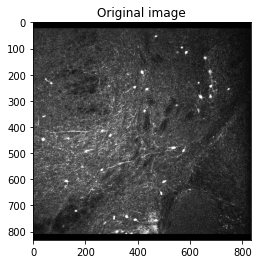

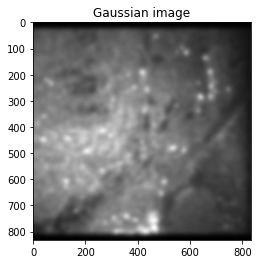

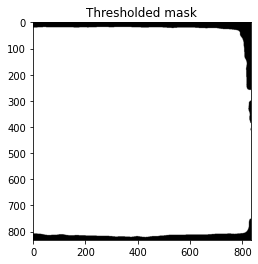

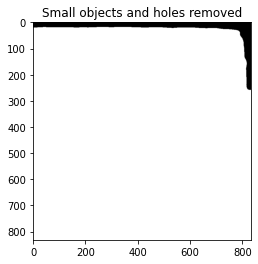

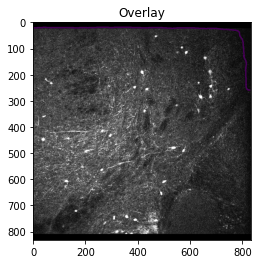

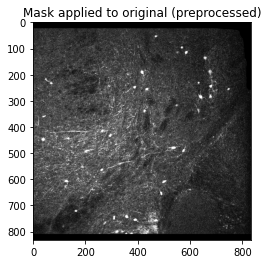

In [ ]:
# Tile samples
black_tile1 = "../B0070/tiles/231023_B0070_MR-0060/10232023-1246-9090_02.tif"
black_tile2 = "../B0070/tiles/231023_B0070_MR-0060/10232023-1246-9092_02.tif"
partial_tile1 = "../B0070/tiles/231023_B0070_MR-0060/10232023-1246-9118_01.tif"
partial_tile2 = "../B0070/tiles/231023_B0070_MR-0060/10232023-1246-9119_01.tif"
full_tile1 = "../B0070/tiles/231023_B0070_MR-0060/10232023-1246-9137_01.tif"
full_tile2 = "../B0070/tiles/231023_B0070_MR-0060/10232023-1246-9150_01.tif"

# Load image
img = load_image(full_tile2)
y, x = img.shape

# Settings
gauss_kernel = 55
thresh = 15
min_size = max(64, int(max(y, x) * 0.20))
area_threshold = max(64, int(max(y, x) * 20))

# Preprocess image
mask = img.copy()
mask = preprocess(mask, min_val=0, max_val=400)
orig = mask.copy()
mask = cv2.GaussianBlur(mask, (gauss_kernel, gauss_kernel), 0)

plt.imshow(orig, cmap='gray')
plt.title("Original image")
plt.show()

plt.imshow(mask, cmap='gray')
plt.title("Gaussian image")
plt.show()

# Apply morphological operations
"""
morph = mask.copy()
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
morph = cv2.morphologyEx(morph, cv2.MORPH_CLOSE, kernel)
morph = cv2.morphologyEx(morph, cv2.MORPH_OPEN, kernel)
plt.imshow(morph, cmap='gray')
plt.title('Morphological operations')
plt.show()
"""

# Threshold it
mask = cv2.threshold(mask, thresh, 255, cv2.THRESH_BINARY)[1].astype(bool)
#mask = cv2.threshold(mask, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1].astype(bool)
mask = np.where(mask > 0, 1, 0).astype(bool)
plt.imshow(mask, cmap='gray')
plt.title('Thresholded mask')
plt.show()


# Remove small specks from background
mask = skimage.morphology.remove_small_objects(mask.astype(bool), min_size=min_size).astype(bool)
mask = skimage.morphology.remove_small_holes(mask, area_threshold=area_threshold).astype(bool)
plt.imshow(mask, cmap='gray')
plt.title('Small objects and holes removed')
plt.show()

plt.imshow(orig, cmap='gray')
plt.contour(mask)
plt.title('Overlay')
plt.show()

# Apply mask to image
masked_img = np.where(mask, img, 0)
masked_img_preprocessed = preprocess(masked_img, min_val=0, max_val=400)
plt.imshow(masked_img_preprocessed, cmap='gray')
plt.title('Mask applied to original (preprocessed)')
plt.show()